In [1]:
pip install pandas


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install numpy==1.26.4


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd

In [3]:
pd.set_option('display.max_columns', None)

# Data cleaning Play-by-Play data into player stats by week

In [153]:
# Importing data
years = np.arange(2010, 2025)
all_data_ls = []
for YEAR in years:
    year_data = pd.read_csv('https://github.com/nflverse/nflverse-data/releases/download/pbp/' \
                   'play_by_play_' + str(YEAR) + '.csv.gz',
                   compression= 'gzip', low_memory= False)
    all_data_ls.append(year_data)
all_data = pd.concat(all_data_ls, ignore_index=True)
all_data

,play_id,game_id,old_game_id,home_team,away_team,season_type,week,posteam,posteam_type,defteam,side_of_field,yardline_100,game_date,quarter_seconds_remaining,half_seconds_remaining,game_seconds_remaining,game_half,quarter_end,drive,sp,qtr,down,goal_to_go,time,yrdln,ydstogo,ydsnet,desc,play_type,yards_gained,shotgun,no_huddle,qb_dropback,qb_kneel,qb_spike,qb_scramble,pass_length,pass_location,air_yards,yards_after_catch,run_location,run_gap,field_goal_result,kick_distance,extra_point_result,two_point_conv_result,home_timeouts_remaining,away_timeouts_remaining,timeout,timeout_team,td_team,td_player_name,td_player_id,posteam_timeouts_remaining,defteam_timeouts_remaining,total_home_score,total_away_score,posteam_score,defteam_score,score_differential,posteam_score_post,defteam_score_post,score_differential_post,no_score_prob,opp_fg_prob,opp_safety_prob,opp_td_prob,fg_prob,safety_prob,td_prob,extra_point_prob,two_point_conversion_prob,ep,epa,total_home_epa,total_away_epa,total_home_rush_epa,total_away_rush_epa,total_home_pass_epa,total_away_pass_epa,air_epa,yac_epa,comp_air_epa,comp_yac_epa,total_home_comp_air_epa,total_away_comp_air_epa,total_home_comp_yac_epa,total_away_comp_yac_epa,total_home_raw_air_epa,total_away_raw_air_epa,total_home_raw_yac_epa,total_away_raw_yac_epa,wp,def_wp,home_wp,away_wp,wpa,vegas_wpa,vegas_home_wpa,home_wp_post,away_wp_post,vegas_wp,vegas_home_wp,total_home_rush_wpa,total_away_rush_wpa,total_home_pass_wpa,total_away_pass_wpa,air_wpa,yac_wpa,comp_air_wpa,comp_yac_wpa,total_home_comp_air_wpa,total_away_comp_air_wpa,total_home_comp_yac_wpa,total_away_comp_yac_wpa,total_home_raw_air_wpa,total_away_raw_air_wpa,total_home_raw_yac_wpa,total_away_raw_yac_wpa,punt_blocked,first_down_rush,first_down_pass,first_down_penalty,third_down_converted,third_down_failed,fourth_down_converted,fourth_down_failed,incomplete_pass,touchback,interception,punt_inside_twenty,punt_in_endzone,punt_out_of_bounds,punt_downed,punt_fair_catch,kickoff_inside_twenty,kickoff_in_endzone,kickoff_out_of_bounds,kickoff_downed,kickoff_fair_catch,fumble_forced,fumble_not_forced,fumble_out_of_bounds,solo_tackle,safety,penalty,tackled_for_loss,fumble_lost,own_kickoff_recovery,own_kickoff_recovery_td,qb_hit,rush_attempt,pass_attempt,sack,touchdown,pass_touchdown,rush_touchdown,return_touchdown,extra_point_attempt,two_point_attempt,field_goal_attempt,kickoff_attempt,punt_attempt,fumble,complete_pass,assist_tackle,lateral_reception,lateral_rush,lateral_return,lateral_recovery,passer_player_id,passer_player_name,passing_yards,receiver_player_id,receiver_player_name,receiving_yards,rusher_player_id,rusher_player_name,rushing_yards,lateral_receiver_player_id,lateral_receiver_player_name,lateral_receiving_yards,lateral_rusher_player_id,lateral_rusher_player_name,lateral_rushing_yards,lateral_sack_player_id,lateral_sack_player_name,interception_player_id,interception_player_name,lateral_interception_player_id,lateral_interception_player_name,punt_returner_player_id,punt_returner_player_name,lateral_punt_returner_player_id,lateral_punt_returner_player_name,kickoff_returner_player_name,kickoff_returner_player_id,lateral_kickoff_returner_player_id,lateral_kickoff_returner_player_name,punter_player_id,punter_player_name,kicker_player_name,kicker_player_id,own_kickoff_recovery_player_id,own_kickoff_recovery_player_name,blocked_player_id,blocked_player_name,tackle_for_loss_1_player_id,tackle_for_loss_1_player_name,tackle_for_loss_2_player_id,tackle_for_loss_2_player_name,qb_hit_1_player_id,qb_hit_1_player_name,qb_hit_2_player_id,qb_hit_2_player_name,forced_fumble_player_1_team,forced_fumble_player_1_player_id,forced_fumble_player_1_player_name,forced_fumble_player_2_team,forced_fumble_player_2_player_id,forced_fumble_player_2_player_name,solo_tackle_1_team,solo_tackle_2_team,solo_tackle_1_player_id,solo_tackle_2_player_id,solo_tackle_1_player_name,solo_tackle_2_player_name,assist_tackle_1_player_id,assist_tackle_1_player_name,assist_tackle_1_team,assist_tack

In [203]:
# Filtering to relevant fantasy data
fantasy_data = all_data[['game_id', 'season', 'week' ,'start_time', 'home_team', "posteam", "defteam", 'stadium', "yardline_100",
    "down", "ydstogo", "quarter_seconds_remaining", "game_seconds_remaining",
    "play_type","rusher_player_name","receiver_player_name","passer_player_name",
    'rusher_player_id', 'receiver_player_id', 'passer_player_id', 'punt_returner_player_id', 'kickoff_returner_player_id',
    "rush_attempt", "pass_attempt", "complete_pass",
    "yards_gained", "receiving_yards", 'yards_after_catch', "rushing_yards", "passing_yards",
    "pass_touchdown", "rush_touchdown", "touchdown", 'qb_kneel', 'qb_spike','qb_scramble',
    "interception", 'fumble', "fumble_lost", 'fumble_forced', 'fumble_not_forced', 'fumble_out_of_bounds', "two_point_attempt", "two_point_conv_result",
    "fantasy_player_name", 'return_touchdown', 'epa', 'cpoe', 'series_success', 'sack', 'punt_returner_player_name', 'kickoff_returner_player_name']]
fantasy_data

,game_id,season,week,start_time,home_team,posteam,defteam,stadium,yardline_100,down,ydstogo,quarter_seconds_remaining,game_seconds_remaining,play_type,rusher_player_name,receiver_player_name,passer_player_name,rusher_player_id,receiver_player_id,passer_player_id,punt_returner_player_id,kickoff_returner_player_id,rush_attempt,pass_attempt,complete_pass,yards_gained,receiving_yards,yards_after_catch,rushing_yards,passing_yards,pass_touchdown,rush_touchdown,touchdown,qb_kneel,qb_spike,qb_scramble,interception,fumble,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,two_point_attempt,two_point_conv_result,fantasy_player_name,return_touchdown,epa,cpoe,series_success,sack,punt_returner_player_name,kickoff_returner_player_name
0,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,NaN,NaN,Edward Jones Dome,NaN,NaN,0,900.0,3600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,1,NaN,NaN,NaN
1,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,30.0,NaN,0,900.0,3600.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00-0026956,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.043582,NaN,1,0.0,NaN,L.Stephens-Howling
2,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,1.0,10,895.0,3595.0,pass,NaN,S.Spach,D.Anderson,NaN,00-0023108,00-0023645,NaN,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,S.Spach,0.0,-0.564644,29.197353,1,0.0,NaN,NaN
3,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,2.0,10,864.0,3564.0,run,T.Hightower,NaN,NaN,00-0026289,NaN,NaN,NaN,NaN,1.0,0.0,0.0,5.0,NaN,NaN,5.0,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,T.Hightower,0.0,-0.022353,NaN,1,0.0,NaN,NaN
4,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,73.0,3.0,5,823.0,3523.0,pass,NaN,L.Fitzgerald,D.Anderson,NaN,00-0022921,00-0023645,NaN,NaN,0.0,1.0,1.0,18.0,18.0,11.0,NaN,18.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,L.Fitzgerald,0.0,2.207573,36.020684,1,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
721559,2024_22_KC_PHI,2024,22,"2/9/25, 18:41:24",PHI,PHI,KC,Caesars Superdome,35.0,NaN,0,108.0,108.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,1.102179,NaN,0,0.0,NaN,NaN
721560,2024_22_KC_PHI,2024,22,"2/9/25, 18:41:24",PHI,PHI,KC,Caesars Superdome,44.0,1.0,10,107.0,107.0,qb_kneel,K.Pickett,NaN,NaN,00-0038102,NaN,NaN,NaN,NaN,1.0,0.0,0.0,-2.0,NaN,NaN,-2.0,NaN,0.0,0.0,0.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,K.Pickett,0.0,-0.599592,NaN,0,0.0,NaN,NaN
721561,2024_22_KC_PHI,2024,22,"2/9/25, 18:41:24",PHI,PHI,KC,Caesars Superdome,46.0,2.0,12,65.0,65.0,qb_kneel,K.Pickett,NaN,NaN,00-0038102,NaN,NaN,NaN,NaN,1.0,0.0,0.0,-1.0,NaN,NaN,-1.0,NaN,0.0,0.0,0.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,K.Pickett,0.0,-0.431691,NaN,0,0.0,NaN,NaN
721562,2024_22_KC_PHI,2024,22,"2/9/25, 18:41:24",PHI,PHI,KC,Caesars Superdome,47.0,3.0,13,27.0,27.0,qb_kneel,K.Pickett,NaN,NaN,00-0038102,NaN,NaN,NaN,NaN,1.0,0.0,0.0,-1.0,NaN,NaN,-1.0,NaN,0.0,0.0,0.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,K.Pickett,0.0,-0.897924,NaN,0,0.0,NaN,NaN


In [204]:
# Limiting to fantasy weeks only
fantasy_data = fantasy_data[
    ((fantasy_data['season'] <= 2020) & (fantasy_data['week'] <= 16)) | 
    ((fantasy_data['season'] >= 2021) & (fantasy_data['week'] <= 17))
]
fantasy_data['fantasy_week'] = fantasy_data['week']
fantasy_data

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/4222448973.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['fantasy_week'] = fantasy_data['week']


,game_id,season,week,start_time,home_team,posteam,defteam,stadium,yardline_100,down,ydstogo,quarter_seconds_remaining,game_seconds_remaining,play_type,rusher_player_name,receiver_player_name,passer_player_name,rusher_player_id,receiver_player_id,passer_player_id,punt_returner_player_id,kickoff_returner_player_id,rush_attempt,pass_attempt,complete_pass,yards_gained,receiving_yards,yards_after_catch,rushing_yards,passing_yards,pass_touchdown,rush_touchdown,touchdown,qb_kneel,qb_spike,qb_scramble,interception,fumble,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,two_point_attempt,two_point_conv_result,fantasy_player_name,return_touchdown,epa,cpoe,series_success,sack,punt_returner_player_name,kickoff_returner_player_name,fantasy_week
0,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,NaN,NaN,Edward Jones Dome,NaN,NaN,0,900.0,3600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,1,NaN,NaN,NaN,1
1,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,30.0,NaN,0,900.0,3600.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00-0026956,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.043582,NaN,1,0.0,NaN,L.Stephens-Howling,1
2,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,1.0,10,895.0,3595.0,pass,NaN,S.Spach,D.Anderson,NaN,00-0023108,00-0023645,NaN,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,S.Spach,0.0,-0.564644,29.197353,1,0.0,NaN,NaN,1
3,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,2.0,10,864.0,3564.0,run,T.Hightower,NaN,NaN,00-0026289,NaN,NaN,NaN,NaN,1.0,0.0,0.0,5.0,NaN,NaN,5.0,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,T.Hightower,0.0,-0.022353,NaN,1,0.0,NaN,NaN,1
4,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,73.0,3.0,5,823.0,3523.0,pass,NaN,L.Fitzgerald,D.Anderson,NaN,00-0022921,00-0023645,NaN,NaN,0.0,1.0,1.0,18.0,18.0,11.0,NaN,18.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,L.Fitzgerald,0.0,2.207573,36.020684,1,0.0,NaN,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716557,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,3.0,10,20.0,20.0,pass,NaN,J.Whyle,M.Rudolph,NaN,00-0038589,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,J.Whyle,0.0,-0.250899,-44.942993,0,0.0,NaN,NaN,17
716558,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,NaN,NaN,EverBank Stadium,NaN,NaN,0,14.0,14.0,no_play,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.000000,NaN,0,0.0,NaN,NaN,17
716559,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,4.0,10,14.0,14.0,pass,NaN,N.Westbrook-Ikhine,M.Rudolph,NaN,00-0036182,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,N.Westbrook-Ikhine,0.0,-2.045720,-29.366240,0,0.0,NaN,NaN,17
716560,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,JAX,TEN,EverBank Stadium,74.0,1.0,10,9.0,9.0,qb_kneel,M.Jones,NaN,NaN,00-0036972,NaN,NaN,NaN,NaN,1.0,0.0,0.0,-1.0,NaN,NaN,-1.0,NaN,0.0,0.0,0.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,M.Jones,0.0,0.000000,NaN,0,0.0,NaN,NaN,17


## Calculate fantasy points of each play that go to each player - New columns
- "Passer_fantasy_pts": fantasy points accumulated by the passing player when play_type = pass
    - Based on yards, interception, touchdown, fumble
- "Receiver_fantasy_pts": fantasy points accumulated by the receiving player when play_type = pass 
    - For receiver, calculate based on yards, touchdown, fumble
- "Rusher_fantasy_pts": fantasy points of the rusher (yards, touchdown, fumble)
- For two point attempts, only count 2 points to the player that scored it
- "Returner_fantasy_pts": 6 points to the player that scored it (play_type = kickoff or punt)
    - Merge this into the other data by player name

In [205]:
# Passer Fantasy Points column
fantasy_data['Passer_fantasy_pts'] = np.where(
    (fantasy_data['play_type'] == 'pass') & (fantasy_data['two_point_conv_result'] == 'success'),
    2,
    np.where(
        fantasy_data['interception'] == 1,
        -2,
        np.where(
            fantasy_data['play_type'] == 'pass',
            (
                fantasy_data['passing_yards'] * 0.04 +
                fantasy_data['pass_touchdown'] * 4 +
                np.where((fantasy_data['fumble_lost'] == 1) & (fantasy_data['complete_pass'] == 0), -2, 0)
            ),
            0  # 0 for non-passing plays
        )
    )
)

# Receiver Fantasy Points column
fantasy_data['Receiver_fantasy_pts'] = np.where(
    (fantasy_data['play_type'] == 'pass') & (fantasy_data['two_point_conv_result'] == 'success'),
    2,
    np.where(
    fantasy_data['play_type'] == 'pass',
    (
        fantasy_data['receiving_yards'] * 0.1 +
        fantasy_data['pass_touchdown'] * 6 +
        fantasy_data['complete_pass'] +         # PPR
        np.where((fantasy_data['fumble_lost'] == 1) & (fantasy_data['complete_pass'] == 1), -2, 0)
    ),
    0  # 0 for non-passing plays
)
)

# Rusher Fantasy Points column
fantasy_data['Rusher_fantasy_pts'] = np.where(
    (fantasy_data['play_type'] == 'run') & (fantasy_data['two_point_conv_result'] == 'success'),
    2,
    np.where(
    fantasy_data['play_type'].isin(['run', 'qb_kneel']),
    (
        fantasy_data['rushing_yards'] * 0.1 +
        fantasy_data['rush_touchdown'] * 6 +
        fantasy_data['fumble_lost'] * -2
    ),
    0
)
)

# Returner Fantasy Points column
fantasy_data['returner_player_name'] = np.where(
    fantasy_data['kickoff_returner_player_name'].notna(),
    fantasy_data['kickoff_returner_player_name'],
    np.where(
        fantasy_data['punt_returner_player_name'].notna(),
        fantasy_data['punt_returner_player_name'],
        np.nan
    )
)
fantasy_data['returner_player_id'] = np.where(
    fantasy_data['kickoff_returner_player_id'].notna(),
    fantasy_data['kickoff_returner_player_id'],
    np.where(
        fantasy_data['punt_returner_player_id'].notna(),
        fantasy_data['punt_returner_player_id'],
        np.nan
    )
)
fantasy_data['Returner_fantasy_pts'] = np.where(
    (fantasy_data['play_type'].isin(['kickoff', 'punt']) & fantasy_data['fumble_lost'] == 1), 
    -2,
    np.where(
    fantasy_data['play_type'].isin(['punt', 'kickoff']),
    (
        fantasy_data['return_touchdown'] * 6
    ),
    0
)
)
fantasy_data

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3696970177.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['Passer_fantasy_pts'] = np.where(
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3696970177.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['Receiver_fantasy_pts'] = np.where(
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3696970177.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a D

,game_id,season,week,start_time,home_team,posteam,defteam,stadium,yardline_100,down,ydstogo,quarter_seconds_remaining,game_seconds_remaining,play_type,rusher_player_name,receiver_player_name,passer_player_name,rusher_player_id,receiver_player_id,passer_player_id,punt_returner_player_id,kickoff_returner_player_id,rush_attempt,pass_attempt,complete_pass,yards_gained,receiving_yards,yards_after_catch,rushing_yards,passing_yards,pass_touchdown,rush_touchdown,touchdown,qb_kneel,qb_spike,qb_scramble,interception,fumble,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,two_point_attempt,two_point_conv_result,fantasy_player_name,return_touchdown,epa,cpoe,series_success,sack,punt_returner_player_name,kickoff_returner_player_name,fantasy_week,Passer_fantasy_pts,Receiver_fantasy_pts,Rusher_fantasy_pts,returner_player_name,returner_player_id,Returner_fantasy_pts
0,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,NaN,NaN,Edward Jones Dome,NaN,NaN,0,900.0,3600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,1,NaN,NaN,NaN,1,0.00,0.0,0.0,NaN,NaN,0.0
1,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,30.0,NaN,0,900.0,3600.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00-0026956,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.043582,NaN,1,0.0,NaN,L.Stephens-Howling,1,0.00,0.0,0.0,L.Stephens-Howling,00-0026956,0.0
2,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,1.0,10,895.0,3595.0,pass,NaN,S.Spach,D.Anderson,NaN,00-0023108,00-0023645,NaN,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,S.Spach,0.0,-0.564644,29.197353,1,0.0,NaN,NaN,1,0.00,1.0,0.0,NaN,NaN,0.0
3,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,2.0,10,864.0,3564.0,run,T.Hightower,NaN,NaN,00-0026289,NaN,NaN,NaN,NaN,1.0,0.0,0.0,5.0,NaN,NaN,5.0,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,T.Hightower,0.0,-0.022353,NaN,1,0.0,NaN,NaN,1,0.00,0.0,0.5,NaN,NaN,0.0
4,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,73.0,3.0,5,823.0,3523.0,pass,NaN,L.Fitzgerald,D.Anderson,NaN,00-0022921,00-0023645,NaN,NaN,0.0,1.0,1.0,18.0,18.0,11.0,NaN,18.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,L.Fitzgerald,0.0,2.207573,36.020684,1,0.0,NaN,NaN,1,0.72,2.8,0.0,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716557,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,3.0,10,20.0,20.0,pass,NaN,J.Whyle,M.Rudolph,NaN,00-0038589,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,J.Whyle,0.0,-0.250899,-44.942993,0,0.0,NaN,NaN,17,NaN,NaN,0.0,NaN,NaN,0.0
716558,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,NaN,NaN,EverBank Stadium,NaN,NaN,0,14.0,14.0,no_play,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.000000,NaN,0,0.0,NaN,NaN,17,0.00,0.0,0.0,NaN,NaN,0.0
716559,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,4.0,10,14.0,14.0,pass,NaN,N.Westbrook-Ikhine,M.Rudolph,NaN,00-0036182,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,N.Westbrook-Ikhine,0.0,-2.045720,-29.366240,0,0.0,NaN,NaN,17,NaN,NaN,0.0,NaN,NaN,0.0
716560,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,JAX,TEN,EverBank Stadium,74.0,1.0,10,9.0,9.0,qb_kneel,M.Jones,NaN,NaN,00-0036972,NaN,NaN,NaN,NaN,1.0,0.0,0.0,-1.0,NaN,NaN,-1.0,NaN,0.0,0.0,0.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,M.Jones,0.0,0.000000,NaN,0,0.0,NaN,NaN,17,0.00,0.0,-0.1,NaN,NaN,0.0


## Other Modifications
- To get real pass attempts: subtract sacks from pass_attempt column value (sacks counted as pass_attempt)
- To get team of each fantasy player: posteam except on punts, defteam
    - Do passer_team, receiver_team, rusher_team, returner_team columns for ease
- Create "game slate" column: morning for 1 PM EST, afternoon for 4 PM EST, night for 8 or 8:20 PM EST, global for others
- Create "stadium" column: stadium of home team, global for global games


In [206]:
fantasy_data.loc[fantasy_data['start_time'] == '10/20/14, 24:13:04', 'start_time'] = '13:04:24'
fantasy_data['time'] = pd.to_datetime(fantasy_data['start_time'])
fantasy_data['hour'] = fantasy_data['time'].dt.hour
fantasy_data['slate'] = np.where(
    fantasy_data['hour'].isin([12, 13, 14]),
    'Morning',
    np.where(
        fantasy_data['hour'].isin([15]),
        'Noon',
        np.where(
            fantasy_data['hour'].isin([16, 17, 19]),
            'Afternoon',
            np.where(
                fantasy_data['hour'].isin([20, 21, 22, 23]),
                'Night',
                'global'
            )
        )
    )
)
fantasy_data['day_slate'] = fantasy_data['time'].dt.day_name() + '_' + fantasy_data['slate']
fantasy_data['location'] = np.where(
    fantasy_data['stadium'].isin(['Wembley Stadium', 'Rogers Centre', 'Twickenham Stadium', 'Estadio Azteca (Mexico City)', 'Tottenham Hotspur Stadium',
                                  'Allianz Arena', 'Frankfurt Stadium', 'Arena Corinthians']), 'global', fantasy_data['home_team']
)
fantasy_data

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/162737832.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  fantasy_data['time'] = pd.to_datetime(fantasy_data['start_time'])
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/162737832.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['time'] = pd.to_datetime(fantasy_data['start_time'])
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/162737832.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See th

,game_id,season,week,start_time,home_team,posteam,defteam,stadium,yardline_100,down,ydstogo,quarter_seconds_remaining,game_seconds_remaining,play_type,rusher_player_name,receiver_player_name,passer_player_name,rusher_player_id,receiver_player_id,passer_player_id,punt_returner_player_id,kickoff_returner_player_id,rush_attempt,pass_attempt,complete_pass,yards_gained,receiving_yards,yards_after_catch,rushing_yards,passing_yards,pass_touchdown,rush_touchdown,touchdown,qb_kneel,qb_spike,qb_scramble,interception,fumble,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,two_point_attempt,two_point_conv_result,fantasy_player_name,return_touchdown,epa,cpoe,series_success,sack,punt_returner_player_name,kickoff_returner_player_name,fantasy_week,Passer_fantasy_pts,Receiver_fantasy_pts,Rusher_fantasy_pts,returner_player_name,returner_player_id,Returner_fantasy_pts,time,hour,slate,day_slate,location
0,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,NaN,NaN,Edward Jones Dome,NaN,NaN,0,900.0,3600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,1,NaN,NaN,NaN,1,0.00,0.0,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA
1,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,30.0,NaN,0,900.0,3600.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00-0026956,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.043582,NaN,1,0.0,NaN,L.Stephens-Howling,1,0.00,0.0,0.0,L.Stephens-Howling,00-0026956,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA
2,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,1.0,10,895.0,3595.0,pass,NaN,S.Spach,D.Anderson,NaN,00-0023108,00-0023645,NaN,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,S.Spach,0.0,-0.564644,29.197353,1,0.0,NaN,NaN,1,0.00,1.0,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA
3,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,2.0,10,864.0,3564.0,run,T.Hightower,NaN,NaN,00-0026289,NaN,NaN,NaN,NaN,1.0,0.0,0.0,5.0,NaN,NaN,5.0,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,T.Hightower,0.0,-0.022353,NaN,1,0.0,NaN,NaN,1,0.00,0.0,0.5,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA
4,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,73.0,3.0,5,823.0,3523.0,pass,NaN,L.Fitzgerald,D.Anderson,NaN,00-0022921,00-0023645,NaN,NaN,0.0,1.0,1.0,18.0,18.0,11.0,NaN,18.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,L.Fitzgerald,0.0,2.207573,36.020684,1,0.0,NaN,NaN,1,0.72,2.8,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716557,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,3.0,10,20.0,20.0,pass,NaN,J.Whyle,M.Rudolph,NaN,00-0038589,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,J.Whyle,0.0,-0.250899,-44.942993,0,0.0,NaN,NaN,17,NaN,NaN,0.0,NaN,NaN,0.0,2024-12-29 13:02:24,13,Morning,Sunday_Morning,JAX
716558,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,NaN,NaN,EverBank Stadium,NaN,NaN,0,14.0,14.0,no_play,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.000000,NaN,0,0.0,NaN,NaN,17,0.00,0.0,0.0,NaN,NaN,0.0,2024-12-29 13:02:24,13,Morning,Sunday_Morning,JAX
716559,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,4.0,10,14.0,14.0,pass,NaN,N.Westbrook-Ikhine,M.Rudolph,NaN,00-0036182,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,N.Westbrook-Ikhine,0.0,-2.045720,-29.366240,0,0.0,NaN

In [207]:
fantasy_data['QB_pass_attempt'] = fantasy_data['pass_attempt'] - fantasy_data['sack']
fantasy_data['passer_team'] = fantasy_data['posteam']
fantasy_data['receiver_team'] = fantasy_data['posteam']
fantasy_data['rusher_team'] = fantasy_data['posteam']
fantasy_data['returner_team'] = np.where(
    fantasy_data['play_type'] == 'punt',
    fantasy_data['defteam'],
    np.where(
        fantasy_data['play_type'] == 'kickoff',
        fantasy_data['posteam'],
        np.nan
    )
)
fantasy_data

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3703864943.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['QB_pass_attempt'] = fantasy_data['pass_attempt'] - fantasy_data['sack']
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3703864943.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fantasy_data['passer_team'] = fantasy_data['posteam']
/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_689/3703864943.py:3: SettingWithCopyWarning: 
A value is tryi

,game_id,season,week,start_time,home_team,posteam,defteam,stadium,yardline_100,down,ydstogo,quarter_seconds_remaining,game_seconds_remaining,play_type,rusher_player_name,receiver_player_name,passer_player_name,rusher_player_id,receiver_player_id,passer_player_id,punt_returner_player_id,kickoff_returner_player_id,rush_attempt,pass_attempt,complete_pass,yards_gained,receiving_yards,yards_after_catch,rushing_yards,passing_yards,pass_touchdown,rush_touchdown,touchdown,qb_kneel,qb_spike,qb_scramble,interception,fumble,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,two_point_attempt,two_point_conv_result,fantasy_player_name,return_touchdown,epa,cpoe,series_success,sack,punt_returner_player_name,kickoff_returner_player_name,fantasy_week,Passer_fantasy_pts,Receiver_fantasy_pts,Rusher_fantasy_pts,returner_player_name,returner_player_id,Returner_fantasy_pts,time,hour,slate,day_slate,location,QB_pass_attempt,passer_team,receiver_team,rusher_team,returner_team
0,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,NaN,NaN,Edward Jones Dome,NaN,NaN,0,900.0,3600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,1,NaN,NaN,NaN,1,0.00,0.0,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA,NaN,NaN,NaN,NaN,NaN
1,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,30.0,NaN,0,900.0,3600.0,kickoff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00-0026956,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.043582,NaN,1,0.0,NaN,L.Stephens-Howling,1,0.00,0.0,0.0,L.Stephens-Howling,00-0026956,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA,0.0,ARI,ARI,ARI,ARI
2,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,1.0,10,895.0,3595.0,pass,NaN,S.Spach,D.Anderson,NaN,00-0023108,00-0023645,NaN,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,S.Spach,0.0,-0.564644,29.197353,1,0.0,NaN,NaN,1,0.00,1.0,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA,1.0,ARI,ARI,ARI,NaN
3,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,78.0,2.0,10,864.0,3564.0,run,T.Hightower,NaN,NaN,00-0026289,NaN,NaN,NaN,NaN,1.0,0.0,0.0,5.0,NaN,NaN,5.0,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,T.Hightower,0.0,-0.022353,NaN,1,0.0,NaN,NaN,1,0.00,0.0,0.5,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA,0.0,ARI,ARI,ARI,NaN
4,2010_01_ARI_STL,2010,1,"9/12/10, 16:15:48",LA,ARI,LA,Edward Jones Dome,73.0,3.0,5,823.0,3523.0,pass,NaN,L.Fitzgerald,D.Anderson,NaN,00-0022921,00-0023645,NaN,NaN,0.0,1.0,1.0,18.0,18.0,11.0,NaN,18.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,L.Fitzgerald,0.0,2.207573,36.020684,1,0.0,NaN,NaN,1,0.72,2.8,0.0,NaN,NaN,0.0,2010-09-12 16:15:48,16,Afternoon,Sunday_Afternoon,LA,1.0,ARI,ARI,ARI,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716557,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,26.0,3.0,10,20.0,20.0,pass,NaN,J.Whyle,M.Rudolph,NaN,00-0038589,00-0034771,NaN,NaN,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,J.Whyle,0.0,-0.250899,-44.942993,0,0.0,NaN,NaN,17,NaN,NaN,0.0,NaN,NaN,0.0,2024-12-29 13:02:24,13,Morning,Sunday_Morning,JAX,1.0,TEN,TEN,TEN,NaN
716558,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,NaN,NaN,EverBank Stadium,NaN,NaN,0,14.0,14.0,no_play,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.000000,NaN,0,0.0,NaN,NaN,17,0.00,0.0,0.0,NaN,NaN,0.0,2024-12-29 13:02:24,13,Morning,Sunday_Morning,JAX,0.0,NaN,NaN,NaN,NaN
716559,2024_17_TEN_JAX,2024,17,"12/29/24, 13:02:24",JAX,TEN,JAX,EverBank Stadium,2

## Stats by player

In [208]:
# Passing stats by player
passer_stats1 = fantasy_data.groupby(['passer_player_name', 'passer_player_id', 'season', 'week', 'passer_team', 'location', 'day_slate']).agg({
    'passing_yards':'sum',
    'pass_touchdown':'sum',
    'QB_pass_attempt':'sum', 
    'complete_pass':'sum',
    'yards_after_catch':'sum',
    'qb_spike': 'sum',
    'sack':'sum',
    'interception':'sum',
    'fumble_lost':'sum',
    'fumble_forced': 'sum',
    'fumble_not_forced':'sum',
    'fumble_out_of_bounds':'sum',
    'Passer_fantasy_pts':'sum',
    'epa':'mean',
    'cpoe':'mean'   # how much over or under expectation his completion percentage was for the game on average across all passes
}).reset_index().rename(columns={'passer_player_name':'player_name', 'passer_player_id':'player_id', 'passer_team':'team', 'yards_after_catch':'yards_after_catch_passer', 'epa':'epa_passer_avg_per_play', 'cpoe':'cpoe_avg'})
passer_stats2 = fantasy_data.groupby(['passer_player_name', 'passer_player_id', 'season', 'week', 'passer_team', 'location', 'day_slate']).agg({
    'epa':'sum'
}).reset_index().rename(columns={'passer_player_name':'player_name', 'passer_player_id':'player_id', 'passer_team':'team', 'yards_after_catch':'yards_after_catch_passer', 'epa':'epa_passer_total_all_plays'})
passer_stats = passer_stats1.merge(passer_stats2, how='left', on=['player_name', 'player_id', 'season', 'week', 'team', 'location', 'day_slate'])
passer_stats

,player_name,player_id,season,week,team,location,day_slate,passing_yards,pass_touchdown,QB_pass_attempt,complete_pass,yards_after_catch_passer,qb_spike,sack,interception,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,Passer_fantasy_pts,epa_passer_avg_per_play,cpoe_avg,epa_passer_total_all_plays
0,A.Andrews,00-0030789,2015,14,TEN,NYJ,Sunday_Morning,41.0,1.0,1.0,1.0,15.0,0,0.0,0.0,0.0,0.0,0.0,0.0,5.64,3.954364,66.256544,3.954364
1,A.Beck,00-0034959,2019,16,DEN,DEN,Sunday_Afternoon,6.0,0.0,1.0,1.0,9.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.24,2.351546,14.173186,2.351546
2,A.Boldin,00-0022084,2010,3,BAL,BAL,Tuesday_Afternoon,-6.0,0.0,1.0,1.0,5.0,0,0.0,0.0,0.0,0.0,0.0,0.0,-0.24,-1.045923,56.395671,-1.045923
3,A.Boldin,00-0022084,2014,5,SF,SF,Sunday_Afternoon,0.0,0.0,1.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.415318,-32.515529,-0.415318
4,A.Brown,00-0027793,2012,7,PIT,CIN,Sunday_Night,0.0,0.0,1.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.598318,-44.167510,-0.598318
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8838,Z.Wilson,00-0037013,2023,9,NYJ,NYJ,Monday_Night,263.0,0.0,49.0,33.0,118.0,0,8.0,0.0,3.0,3.0,0.0,0.0,10.52,-0.420034,0.436576,-23.941924
8839,Z.Wilson,00-0037013,2023,10,NYJ,LV,Sunday_Night,263.0,0.0,39.0,23.0,149.0,0,2.0,1.0,0.0,1.0,0.0,0.0,8.52,-0.100565,-6.937659,-4.123176
8840,Z.Wilson,00-0037013,2023,11,NYJ,BUF,Sunday_Afternoon,81.0,1.0,16.0,7.0,59.0,0,5.0,1.0,0.0,0.0,0.0,0.0,5.24,-0.407523,-17.702346,-8.557985
8841,Z.Wilson,00-0037013,2023,14,NYJ,NYJ,Sunday_Morning,301.0,2.0,36.0,27.0,138.0,0,4.0,0.0,0.0,0.0,0.0,0.0,20.04,0.195746,10.181873,7.829824


In [209]:
# Receiving stats by player
## YAC > receiving yards indicates player caught the ball behind the line of scrimmage
### e.g. a bubble screen caught 3 yards behind the line of scrimmage and a player gaining 3 yards on the play would indicate 3 receiving yards but 6 YAC
receiver_stats1 = fantasy_data.groupby(['receiver_player_name', 'receiver_player_id', 'season', 'week', 'receiver_team',  'location', 'day_slate']).agg({
    'receiving_yards':'sum',
    'pass_touchdown':'sum',
    'yards_after_catch':'sum',
    'QB_pass_attempt':'sum',
    'fumble_lost':'sum',
    'complete_pass':'sum',
    'fumble_forced': 'sum',
    'fumble_not_forced':'sum',
    'Receiver_fantasy_pts':'sum',
    'epa':'mean'
}).reset_index().rename(columns={'receiver_player_name':'player_name', 'receiver_player_id':'player_id', 'receiver_team':'team', 'pass_touchdown':'receiving_touchdown', 'epa':'epa_receiver_avg_per_play', 
                                 'complete_pass':'receptions', 'QB_pass_attempt':'targets'})
receiver_stats2 = fantasy_data.groupby(['receiver_player_name', 'receiver_player_id', 'season', 'week', 'receiver_team',  'location', 'day_slate']).agg({
    'epa':'sum'
}).reset_index().rename(columns={'receiver_player_name':'player_name', 'receiver_player_id':'player_id', 'receiver_team':'team', 'epa':'epa_receiver_total_all_plays'})
receiver_stats = receiver_stats1.merge(receiver_stats2, how='left', on=['player_name', 'player_id', 'season', 'week', 'team',  'location', 'day_slate'])
receiver_stats

,player_name,player_id,season,week,team,location,day_slate,receiving_yards,receiving_touchdown,yards_after_catch,targets,fumble_lost,receptions,fumble_forced,fumble_not_forced,Receiver_fantasy_pts,epa_receiver_avg_per_play,epa_receiver_total_all_plays
0,A.Abdullah,00-0032104,2015,1,DET,LAC,Sunday_Afternoon,44.0,0.0,58.0,4.0,0.0,4.0,0.0,0.0,8.4,0.313880,1.255520
1,A.Abdullah,00-0032104,2015,2,DET,MIN,Sunday_Morning,9.0,0.0,6.0,1.0,0.0,1.0,0.0,0.0,1.9,0.590301,0.590301
2,A.Abdullah,00-0032104,2015,3,DET,DET,Sunday_Night,19.0,1.0,21.0,5.0,0.0,2.0,0.0,0.0,9.9,-0.141507,-0.707535
3,A.Abdullah,00-0032104,2015,4,DET,SEA,Monday_Night,11.0,0.0,10.0,5.0,0.0,2.0,0.0,0.0,3.1,-0.392687,-1.963436
4,A.Abdullah,00-0032104,2015,5,DET,DET,Sunday_Afternoon,9.0,0.0,3.0,2.0,0.0,1.0,0.0,0.0,1.9,-3.717362,-7.434723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58782,Z.Zenner,00-0031665,2018,12,DET,DET,Thursday_Morning,4.0,0.0,9.0,1.0,0.0,1.0,0.0,0.0,1.4,-0.187960,-0.187960
58783,Z.Zenner,00-0031665,2018,15,DET,BUF,Sunday_Morning,0.0,0.0,5.0,4.0,0.0,3.0,0.0,0.0,3.0,-0.714553,-2.858211
58784,Z.Zenner,00-0031665,2018,16,DET,DET,Sunday_Morning,22.0,0.0,16.0,3.0,0.0,2.0,0.0,0.0,4.2,0.142356,0.427067
58785,Z.Zenner,00-0031665,2019,7,NO,CHI,Sunday_Afternoon,6.0,0.0,4.0,2.0,0.0,1.0,0.0,0.0,1.6,-0.505285,-1.010571


In [210]:
# Rushing stats by player
rusher_stats1 = fantasy_data.groupby(['rusher_player_name', 'rusher_player_id', 'season', 'week', 'rusher_team',  'location', 'day_slate']).agg({
    'rushing_yards':'sum',
    'rush_touchdown':'sum',
    'rush_attempt':'sum',
    'qb_kneel': 'sum',
    'fumble_lost':'sum',
    'fumble_forced': 'sum',
    'fumble_not_forced':'sum',
    'Rusher_fantasy_pts':'sum',
    'epa':'mean'
}).reset_index().rename(columns={'rusher_player_name':'player_name', 'rusher_player_id':'player_id', 'rusher_team':'team', 'epa':'epa_rusher_avg_per_play'})
rusher_stats2 = fantasy_data.groupby(['rusher_player_name', 'rusher_player_id', 'season', 'week', 'rusher_team',  'location', 'day_slate']).agg({
    'epa':'sum'
}).reset_index().rename(columns={'rusher_player_name':'player_name', 'rusher_player_id':'player_id', 'rusher_team':'team', 'epa':'epa_rusher_total_all_plays'})
rusher_stats = rusher_stats1.merge(rusher_stats2, how='left', on=['player_name', 'player_id', 'season', 'week', 'team',  'location', 'day_slate'])
rusher_stats

,player_name,player_id,season,week,team,location,day_slate,rushing_yards,rush_touchdown,rush_attempt,qb_kneel,fumble_lost,fumble_forced,fumble_not_forced,Rusher_fantasy_pts,epa_rusher_avg_per_play,epa_rusher_total_all_plays
0,A.Abdullah,00-0032104,2015,1,DET,LAC,Sunday_Afternoon,50.0,1.0,7.0,0,0.0,1.0,0.0,11.0,0.421903,2.953318
1,A.Abdullah,00-0032104,2015,2,DET,MIN,Sunday_Morning,9.0,0.0,6.0,0,0.0,0.0,0.0,0.9,-0.384722,-2.308332
2,A.Abdullah,00-0032104,2015,3,DET,DET,Sunday_Night,23.0,0.0,8.0,0,0.0,0.0,0.0,2.3,-0.151066,-1.208527
3,A.Abdullah,00-0032104,2015,4,DET,SEA,Monday_Night,33.0,0.0,13.0,0,0.0,0.0,0.0,3.3,-0.174126,-2.263637
4,A.Abdullah,00-0032104,2015,5,DET,DET,Sunday_Afternoon,16.0,0.0,6.0,0,1.0,1.0,0.0,-0.4,-1.111646,-6.669874
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29740,Z.Zenner,00-0031665,2018,15,DET,BUF,Sunday_Morning,45.0,1.0,10.0,0,0.0,0.0,0.0,10.5,0.297264,2.972639
29741,Z.Zenner,00-0031665,2018,16,DET,DET,Sunday_Morning,45.0,0.0,8.0,0,0.0,0.0,0.0,4.5,-0.094599,-0.756793
29742,Z.Zenner,00-0031665,2019,7,NO,CHI,Sunday_Afternoon,1.0,0.0,1.0,0,0.0,0.0,0.0,0.1,-0.482285,-0.482285
29743,Z.Zenner,00-0031665,2019,8,ARI,NO,Sunday_Morning,0.0,0.0,1.0,0,0.0,0.0,0.0,0.0,-0.560316,-0.560316


In [211]:
# Returning stats by player
returner_stats1 = fantasy_data.groupby(['returner_player_name', 'returner_player_id', 'season', 'week', 'returner_team',  'location', 'day_slate']).agg({
    'fumble_lost':'sum',
    'fumble_forced': 'sum',
    'fumble_not_forced':'sum',
    'Returner_fantasy_pts':'sum',
    'epa':'mean'
}).reset_index().rename(columns={'returner_player_name':'player_name', 'returner_player_id':'player_id', 'returner_team': 'team', 'epa':'epa_returner_avg_per_play'})
returner_stats2 = fantasy_data.groupby(['returner_player_name', 'returner_player_id', 'season', 'week', 'returner_team',  'location', 'day_slate']).agg({
    'epa':'sum'
}).reset_index().rename(columns={'returner_player_name':'player_name', 'returner_player_id':'player_id', 'returner_team': 'team', 'epa':'epa_returner_total_all_plays'})
returner_stats = returner_stats1.merge(returner_stats2, how='left', on=['player_name', 'player_id', 'season', 'week', 'team',  'location', 'day_slate'])
returner_stats

,player_name,player_id,season,week,team,location,day_slate,fumble_lost,fumble_forced,fumble_not_forced,Returner_fantasy_pts,epa_returner_avg_per_play,epa_returner_total_all_plays
0,A.Abdullah,00-0032104,2015,1,DET,LAC,Sunday_Afternoon,0.0,0.0,0.0,0.0,0.537367,1.612100
1,A.Abdullah,00-0032104,2015,2,DET,MIN,Sunday_Morning,0.0,0.0,0.0,0.0,0.028776,0.086327
2,A.Abdullah,00-0032104,2015,4,DET,SEA,Monday_Night,0.0,0.0,0.0,0.0,-0.011543,-0.023086
3,A.Abdullah,00-0032104,2015,5,DET,DET,Sunday_Afternoon,0.0,1.0,0.0,0.0,0.627881,0.627881
4,A.Abdullah,00-0032104,2015,6,DET,DET,Sunday_Morning,0.0,0.0,0.0,0.0,-0.134082,-0.134082
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13239,Z.Sudfeld,00-0029999,2014,9,NYJ,KC,Sunday_Morning,0.0,0.0,0.0,0.0,0.879197,0.879197
13240,Z.Tipton,00-0030855,2015,8,IND,CAR,Monday_Night,0.0,0.0,0.0,0.0,0.488628,0.488628
13241,Z.Vigil,00-0031728,2015,11,MIA,MIA,Sunday_Morning,0.0,0.0,0.0,0.0,1.085250,1.085250
13242,Z.Zenner,00-0031665,2017,6,DET,NO,Sunday_Morning,0.0,0.0,0.0,0.0,0.437271,0.437271


## Merging all stats together

In [212]:
qb_wr_stats = passer_stats.merge(receiver_stats, how='outer', on=['player_name', 'season', 'week', 'player_id', 'team',  'location', 'day_slate', 'fumble_lost', 'fumble_forced', 'fumble_not_forced'])
sk_stats = qb_wr_stats.merge(rusher_stats, how='outer', on=['player_name','season', 'week', 'player_id', 'team',  'location', 'day_slate', 'fumble_lost', 'fumble_forced', 'fumble_not_forced'])
player_stats = sk_stats.merge(returner_stats, how='outer', on=['player_name','season', 'week', 'player_id', 'team',  'location', 'day_slate', 'fumble_lost', 'fumble_forced', 'fumble_not_forced'])
player_stats.fillna(0, inplace=True)
player_stats['PPR_fantasy_points'] = player_stats['Rusher_fantasy_pts'] + player_stats['Receiver_fantasy_pts'] + player_stats['Passer_fantasy_pts'] + player_stats['Returner_fantasy_pts']
player_stats

,player_name,player_id,season,week,team,location,day_slate,passing_yards,pass_touchdown,QB_pass_attempt,complete_pass,yards_after_catch_passer,qb_spike,sack,interception,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,Passer_fantasy_pts,epa_passer_avg_per_play,cpoe_avg,epa_passer_total_all_plays,receiving_yards,receiving_touchdown,yards_after_catch,targets,receptions,Receiver_fantasy_pts,epa_receiver_avg_per_play,epa_receiver_total_all_plays,rushing_yards,rush_touchdown,rush_attempt,qb_kneel,Rusher_fantasy_pts,epa_rusher_avg_per_play,epa_rusher_total_all_plays,Returner_fantasy_pts,epa_returner_avg_per_play,epa_returner_total_all_plays,PPR_fantasy_points
0,A.Andrews,00-0030789,2015,14,TEN,NYJ,Sunday_Morning,41.0,1.0,1.0,1.0,15.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.64,3.954364,66.256544,3.954364,6.0,0.0,5.0,2.0,1.0,1.6,-1.179037,-2.358074,8.0,0.0,4.0,0.0,0.8,-0.361761,-1.447043,0.0,0.000000,0.000000,8.04
1,A.Beck,00-0034959,2019,16,DEN,DEN,Sunday_Afternoon,6.0,0.0,1.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.24,2.351546,14.173186,2.351546,1.0,0.0,3.0,1.0,1.0,1.1,-0.598561,-0.598561,3.0,0.0,1.0,0.0,0.3,0.690179,0.690179,0.0,0.000000,0.000000,1.64
2,A.Boldin,00-0022084,2010,3,BAL,BAL,Tuesday_Afternoon,-6.0,0.0,1.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.24,-1.045923,56.395671,-1.045923,142.0,3.0,38.0,11.0,8.0,40.2,1.427988,15.707872,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,39.96
3,A.Boldin,00-0022084,2014,5,SF,SF,Sunday_Afternoon,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.415318,-32.515529,-0.415318,72.0,0.0,27.0,8.0,4.0,11.2,0.244596,1.956770,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,11.20
4,A.Brown,00-0027793,2012,7,PIT,CIN,Sunday_Night,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.598318,-44.167510,-0.598318,96.0,0.0,39.0,8.0,7.0,16.6,1.078417,8.627336,13.0,0.0,2.0,0.0,1.3,0.415733,0.831465,0.0,0.845884,2.537653,17.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84401,Z.Smith,00-0031576,2015,16,BAL,BAL,Sunday_Morning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.960894,0.960894,0.00
84402,Z.Stacy,00-0030536,2015,10,NYJ,NYJ,Thursday_Night,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.002994,0.002994,0.00
84403,Z.Sudfeld,00-0029999,2014,9,NYJ,KC,Sunday_Morning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.879197,0.879197,0.00
84404,Z.Tipton,00-0030855,2015,8,IND,CAR,Monday_Night,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.488628,0.488628,0.00


## Note on game_number column
Model based off only the player's stats the prior year, corresponding to the **GAME NUMBER** of the prior year:
- game_number column: calculates the game number of the season of a team
    - Ex: if a team has a bye week on week 7, then week 8 would be game number 7, week 9 is game number 8, etc.
- Lag stats 1 year so that the stats of a player (all rows besides grouping) correspond to those the year prior
- Ex: if a row has player_name = M. Stafford, player_id = 99999, season = 2024, game_number = 15, team = LAR, location = SF, day_slate = Sunday_Night, all other columns (stats columns) will correspond to player_name = M. Stafford, player_id = 99999, season = **2023**, game_number = 15, team = {whatever team player was on in 2023 game number 15}, location = {wherever player played in 2023 game number 15}, day_slate = {whenever player played in 2023 game number 15}

### Creating game_number column

In [213]:
game_no = player_stats[['season', 'week', 'team', 'location']].groupby(['season', 'team', 'week']).agg({'location': 'first'})
game_no['game_number'] = game_no.groupby(['season', 'team']).cumcount() + 1
game_no.reset_index(inplace=True)
game_no

,season,team,week,location,game_number
0,2010,ARI,1,LA,1
1,2010,ARI,2,ATL,2
2,2010,ARI,3,ARI,3
3,2010,ARI,4,LAC,4
4,2010,ARI,5,ARI,5
...,...,...,...,...,...
7321,2024,WAS,12,WAS,12
7322,2024,WAS,13,WAS,13
7323,2024,WAS,15,NO,14
7324,2024,WAS,16,WAS,15


In [214]:
player_stats = player_stats.merge(game_no, how='left', on=['season', 'team', 'week', 'location'])

In [215]:
# Reformatting rows and columns
player_stats = player_stats.sort_values(['season', 'week'])
cols = list(player_stats.columns)
player_stats = player_stats[cols[:3] + [cols[-1]] + cols[3:-1]]
player_stats.reset_index(inplace=True, drop=True)
player_stats

,player_name,player_id,season,game_number,week,team,location,day_slate,passing_yards,pass_touchdown,QB_pass_attempt,complete_pass,yards_after_catch_passer,qb_spike,sack,interception,fumble_lost,fumble_forced,fumble_not_forced,fumble_out_of_bounds,Passer_fantasy_pts,epa_passer_avg_per_play,cpoe_avg,epa_passer_total_all_plays,receiving_yards,receiving_touchdown,yards_after_catch,targets,receptions,Receiver_fantasy_pts,epa_receiver_avg_per_play,epa_receiver_total_all_plays,rushing_yards,rush_touchdown,rush_attempt,qb_kneel,Rusher_fantasy_pts,epa_rusher_avg_per_play,epa_rusher_total_all_plays,Returner_fantasy_pts,epa_returner_avg_per_play,epa_returner_total_all_plays,PPR_fantasy_points
0,A.Rodgers,00-0023459,2010,1,1,GB,PHI,Sunday_Afternoon,188.0,2.0,31.0,19.0,38.0,1.0,3.0,2.0,0.0,0.0,0.0,0.0,11.52,0.027608,2.564879,0.938667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,0.0,5.0,3.0,0.9,0.230902,1.154508,0.0,0.000000,0.000000,12.42
1,A.Smith,00-0023436,2010,1,1,SF,SEA,Sunday_Afternoon,225.0,0.0,45.0,26.0,94.0,0.0,2.0,2.0,0.0,1.0,0.0,0.0,5.00,-0.292360,0.817200,-13.740915,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,5.00
2,B.Favre,00-0005106,2010,1,1,MIN,NO,Thursday_Night,171.0,1.0,27.0,15.0,64.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8.84,-0.167168,-5.790985,-4.680712,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,8.84
3,C.Henne,00-0026197,2010,1,1,MIA,BUF,Sunday_Morning,182.0,0.0,34.0,21.0,84.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,7.28,-0.014758,-1.614386,-0.546047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.0,0.0,2.0,0.0,-0.1,-0.230927,-0.461855,0.0,0.000000,0.000000,7.18
4,C.Palmer,00-0021429,2010,1,1,CIN,NE,Sunday_Morning,345.0,2.0,50.0,34.0,120.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,19.80,0.102199,5.705391,5.212153,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,19.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84401,T.Kennedy,00-0035544,2024,16,17,DET,SF,Monday_Night,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.468810,1.406430,0.00
84402,T.Palmer,00-0039052,2024,16,17,TB,TB,Sunday_Morning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.668110,1.336220,0.00
84403,T.Scott,00-0038941,2024,16,17,CHI,CHI,Thursday_Night,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,-0.442435,-0.442435,0.00
84404,X.Gipson,00-0038496,2024,16,17,NYJ,BUF,Sunday_Morning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,-0.568105,-1.704315,0.00


# Data uploading & cleaning

In [5]:
pip install nfl_data_py

  Using cached pandas-1.5.3-cp310-cp310-macosx_10_9_x86_64.whl (12.0 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 2.3.0
    Uninstalling pandas-2.3.0:
      Successfully uninstalled pandas-2.3.0

[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [4]:
import nfl_data_py as nfl
import pandas as pd
import numpy as np
weekly_stats = nfl.import_weekly_data(years = range(2010, 2025))
weekly_stats.rename(columns={'recent_team':'team'}, inplace=True)
weekly_stats

Downcasting floats.


,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5592,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000
5593,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000
5594,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000
5595,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000


## Cleaning & adding game_number

In [5]:
# Importing schedule data
schedules = nfl.import_schedules(years = range(2010, 2025))
schedules['time'] = pd.to_datetime(schedules['gametime'])
schedules['hour'] = schedules['time'].dt.hour
schedules['slate'] = np.where(
    schedules['hour'].isin([12, 13, 14]),
    'Morning',
    np.where(
        schedules['hour'].isin([15]),
        'Noon',
        np.where(
            schedules['hour'].isin([16, 17, 18, 19]),
            'Afternoon',
            np.where(
                schedules['hour'].isin([20, 21, 22, 23]),
                'Night',
                'global'
            )
        )
    )
)

# Unifying abbreviations of teams that have moved (and thus changed their abbrevaitions)
team_map = {'STL':'LA', 'SD':'LAC', 'OAK':'LV'}
schedules['home_team'] = schedules['home_team'].replace(team_map)
schedules['away_team'] = schedules['away_team'].replace(team_map)

# Creating day_slate column
schedules['day_slate'] = schedules['weekday'] + '_' + schedules['slate']

# Creating location column
schedules['location'] = np.where(
    schedules['stadium'].isin(['Wembley Stadium', 'Rogers Centre', 'Twickenham Stadium', 'Azteca Stadium', 'Tottenham Stadium',
                                  'Allianz Arena', 'Deutsche Bank Park', 'Arena Corinthians']), 'global', schedules['home_team'])

schedules

,game_id,season,game_type,week,gameday,weekday,gametime,away_team,away_score,home_team,home_score,location,result,total,overtime,old_game_id,gsis,nfl_detail_id,pfr,pff,espn,ftn,away_rest,home_rest,away_moneyline,home_moneyline,spread_line,away_spread_odds,home_spread_odds,total_line,under_odds,over_odds,div_game,roof,surface,temp,wind,away_qb_id,home_qb_id,away_qb_name,home_qb_name,away_coach,home_coach,referee,stadium_id,stadium,time,hour,slate,day_slate
2913,2010_01_MIN_NO,2010,REG,1,2010-09-09,Thursday,20:30,MIN,9.0,NO,14.0,NO,5.0,23.0,0.0,2010090900,54863.0,NaN,201009090nor,1727.0,300909018.0,NaN,7,7,197.0,-220.0,4.5,-105.0,-103.0,48.5,-104.0,-106.0,0,dome,sportturf,NaN,NaN,00-0005106,00-0020531,Brett Favre,Drew Brees,Brad Childress,Sean Payton,Terry McAulay,NOR00,Louisiana Superdome,2025-06-24 20:30:00,20,Night,Thursday_Night
2914,2010_01_MIA_BUF,2010,REG,1,2010-09-12,Sunday,13:00,MIA,15.0,BUF,10.0,BUF,-5.0,25.0,0.0,2010091201,54864.0,NaN,201009120buf,1729.0,300912002.0,NaN,7,7,-155.0,140.0,-3.0,-106.0,-102.0,39.5,-110.0,100.0,1,outdoors,astroplay,62.0,7.0,00-0026197,00-0025479,Chad Henne,Trent Edwards,Tony Sparano,Chan Gailey,Clete Blakeman,BUF00,Ralph Wilson Stadium,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2915,2010_01_DET_CHI,2010,REG,1,2010-09-12,Sunday,13:00,DET,14.0,CHI,19.0,CHI,5.0,33.0,0.0,2010091207,54865.0,NaN,201009120chi,1736.0,300912003.0,NaN,7,7,248.0,-280.0,6.5,103.0,-111.0,44.5,-105.0,-105.0,1,outdoors,grass,75.0,10.0,00-0026498,00-0024226,Matthew Stafford,Jay Cutler,Jim Schwartz,Lovie Smith,Gene Steratore,CHI98,Soldier Field,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2916,2010_01_IND_HOU,2010,REG,1,2010-09-12,Sunday,13:00,IND,24.0,HOU,34.0,HOU,10.0,58.0,0.0,2010091203,54866.0,NaN,201009120htx,1731.0,300912034.0,NaN,7,7,-117.0,106.0,-1.0,-110.0,102.0,47.5,-102.0,-108.0,1,closed,grass,NaN,NaN,00-0010346,00-0022787,Peyton Manning,Matt Schaub,Jim Caldwell,Gary Kubiak,Ed Hochuli,HOU00,Reliant Stadium,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2917,2010_01_DEN_JAX,2010,REG,1,2010-09-12,Sunday,13:00,DEN,17.0,JAX,24.0,JAX,7.0,41.0,0.0,2010091204,54867.0,NaN,201009120jax,1732.0,300912030.0,NaN,7,7,166.0,-185.0,3.0,109.0,-118.0,41.5,-110.0,100.0,0,outdoors,grass,90.0,10.0,00-0023541,00-0021231,Kyle Orton,David Garrard,Josh McDaniels,Jack Del Rio,Walt Coleman,JAX00,EverBank Field,2025-06-24 13:00:00,13,Morning,Sunday_Morning
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6986,2024_20_LA_PHI,2024,DIV,20,2025-01-19,Sunday,15:00,LA,22.0,PHI,28.0,PHI,6.0,50.0,0.0,2025011900,59837.0,NaN,202501190phi,NaN,401671937.0,NaN,6,7,260.0,-325.0,7.0,-112.0,-108.0,43.5,-110.0,-110.0,0,outdoors,grass,34.0,8.0,00-0026498,00-0036389,Matthew Stafford,Jalen Hurts,Sean McVay,Nick Sirianni,Shawn Smith,PHI00,Lincoln Financial Field,2025-06-24 15:00:00,15,Noon,Sunday_Noon
6987,2024_20_BAL_BUF,2024,DIV,20,2025-01-19,Sunday,18:30,BAL,25.0,BUF,27.0,BUF,2.0,52.0,0.0,2025011901,59838.0,NaN,202501190buf,NaN,401671886.0,NaN,8,7,-118.0,-102.0,-1.5,-102.0,-118.0,51.5,-105.0,-115.0,0,outdoors,a_turf,19.0,4.0,00-0034796,00-0034857,Lamar Jackson,Josh Allen,John Harbaugh,Sean McDermott,Carl Cheffers,BUF00,New Era Field,2025-06-24 18:30:00,18,Afternoon,Sunday_Afternoon
6988,2024_21_WAS_PHI,2024,CON,21,2025-01-26,Sunday,15:00,WAS,23.0,PHI,55.0,PHI,32.0,78.0,0.0,2025012600,59839.0,NaN,202501260phi,NaN,401671888.0,NaN,8,7,205.0,-250.0,6.0,-110.0,-110.0,46.5,-105.0,-115.0,1,outdoors,grass,40.0,11.0,00-0039910,00-0036389,Jayden Daniels,Jalen Hurts,Dan Quinn,Nick Sirianni,Shawn Hochuli,PHI00,Lincoln Financial Field,2025-06-24 15:00:00,15,Noon,Sunday_Noon
6989,2024_21_BUF_KC,2024,CON,21,2025-01-26,Sunday,18:30,BUF,29.0,KC,32.0,KC,3.0,61.0,0.0,2025012601,59840.0,NaN,202501260kan,NaN,401671887.0,NaN,7,8,-102.0,-118.0,1.5,-115.0,-105.0,49.5,-115.0,-105.0,0,outdoors,grass,31.0,8.0,00-0034857,00-00338

In [6]:
# Merging weekly_stats and schedules
weekly_stats['matchup'] = weekly_stats.apply(lambda row: '_'.join(sorted([row['team'], row['opponent_team']])), axis=1)
schedules['matchup'] = schedules.apply(lambda row: '_'.join(sorted([row['home_team'], row['away_team']])), axis=1)
weekly_stats = weekly_stats.merge(schedules[['season', 'week', 'matchup', 'game_type', 'day_slate', 'location']], how='left', on=['season', 'week', 'matchup'])
weekly_stats

,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000,PIT_TEN,REG,Sunday_Morning,TEN
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001,PIT_TB,REG,Sunday_Morning,TB
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000,BAL_PIT,REG,Sunday_Morning,PIT
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000,JAX_KC,REG,Sunday_Morning,KC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000,ARI_NYJ,REG,Sunday_Afternoon,ARI
80915,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000,ARI_SEA,REG,Sunday_Afternoon,SEA
80916,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000,ARI_MIN,REG,Sunday_Morning,MIN
80917,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000,ARI_SEA,REG,Sunday_Afternoon,ARI


In [7]:
# Creating game_number column
game_no = weekly_stats[['season', 'week', 'team', 'location']].groupby(['season', 'team', 'week']).agg({'location': 'first'})
game_no['game_number'] = game_no.groupby(['season', 'team']).cumcount() + 1
game_no.reset_index(inplace=True)
weekly_stats = weekly_stats.merge(game_no, how='left', on=['season', 'team', 'week', 'location'])
weekly_stats

,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location,game_number
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000,PIT_TEN,REG,Sunday_Morning,TEN,2.0
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001,PIT_TB,REG,Sunday_Morning,TB,3.0
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000,BAL_PIT,REG,Sunday_Morning,PIT,4.0
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS,1.0
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000,JAX_KC,REG,Sunday_Morning,KC,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000,ARI_NYJ,REG,Sunday_Afternoon,ARI,10.0
80915,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000,ARI_SEA,REG,Sunday_Afternoon,SEA,11.0
80916,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000,ARI_MIN,REG,Sunday_Morning,MIN,12.0
80917,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000,ARI_SEA,REG,Sunday_Afternoon,ARI,13.0


In [8]:
# Reformatting rows and columns
weekly_stats = weekly_stats.sort_values(['season', 'week'])
cols = list(weekly_stats.columns)
weekly_stats = weekly_stats[cols[:3] + [cols[-1]] + cols[3:-1]]
weekly_stats.reset_index(inplace=True, drop=True)
weekly_stats

,player_id,player_name,player_display_name,game_number,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location
0,00-0001231,None,Josh Bidwell,1.0,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS
1,00-0004161,None,Jake Delhomme,1.0,QB,QB,None,CLE,2010,1,REG,TB,20,37,227.0,1,2.0,0.0,-0.0,0,0,363.0,108.0,8.0,-8.729009,0,0.625344,0.007694,1,1.0,0,0.0,0.0,0.0,-1.174043,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,9.180000,9.180000,CLE_TB,REG,Sunday_Morning,TB
2,00-0004541,None,Donald Driver,1.0,WR,WR,None,GB,2010,1,REG,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,5,7,30.0,1,0.0,0.0,54.0,2.0,4.0,1.204149,0,0.555556,0.233333,0.168224,0.467757,0.0,9.000000,14.000000,GB_PHI,REG,Sunday_Afternoon,PHI
3,00-0005091,None,Kevin Faulk,1.0,RB,RB,None,NE,2010,1,REG,CIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,23.0,0,0.0,0.0,1.0,0.792120,0,4,6,47.0,0,0.0,0.0,32.0,26.0,2.0,0.776525,0,1.468750,0.171429,0.124514,0.344302,0.0,7.000000,11.000000,CIN_NE,REG,Sunday_Morning,NE
4,00-0005106,None,Brett Favre,1.0,QB,QB,None,MIN,2010,1,REG,NO,15,27,171.0,1,1.0,1.0,9.0,0,0,280.0,64.0,7.0,-4.680712,0,0.610714,-0.006022,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,8.840000,8.840000,MIN_NO,REG,Thursday_Night,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0037197,I.Pacheco,Isiah Pacheco,20.0,RB,RB,https://static.www.nfl.com/image/private/f_aut...,KC,2024,22,POST,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,7.0,0,0.0,0.0,0.0,-0.931770,0,1,2,5.0,0,0.0,0.0,0.0,5.0,1.0,-0.535205,0,0.000000,0.062500,0.000000,0.093750,0.0,1.200000,2.200000,KC_PHI,SB,Sunday_Afternoon,PHI
80915,00-0037741,J.Dotson,Jahan Dotson,21.0,WR,WR,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,2,3,42.0,0,0.0,0.0,31.0,17.0,2.0,1.256661,0,1.354839,0.130435,0.157360,0.305804,0.0,4.200000,6.200000,KC_PHI,SB,Sunday_Afternoon,PHI
80916,00-0038102,K.Pickett,Kenny Pickett,21.0,QB,QB,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,1,0.0,0,0.0,0.0,-0.0,0,0,6.0,0.0,0.0,-2.720175,0,0.000000,NaN,3,-4.0,0,0.0,0.0,0.0,-1.929207,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,-0.400000,-0.400000,KC_PHI,SB,Sunday_Afternoon,PHI
80917,00-0039236,J.Wilson,Johnny Wilson,21.0,WR,WR,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,0,1,0.0,0,0.0,0.0,2.0,0.0,0.0,-0.623375,0,0.000000,0.043478,0.010152,0.072324,0.0,0.000000,0.000000,KC_PHI,SB,Sunday_Afternoon,PHI


In [9]:
# Limiting to fantasy weeks only
weekly_stats = weekly_stats[
    ((weekly_stats['season'] <= 2020) & (weekly_stats['week'] <= 16)) | 
    ((weekly_stats['season'] >= 2021) & (weekly_stats['week'] <= 17))
]

# Limiting to relevant positions only
weekly_stats = weekly_stats[weekly_stats['position_group'].isin(['WR', 'QB', 'TE', 'FB', 'RB'])]

# Dropping unnecessary columns
weekly_stats = weekly_stats.drop(columns={
    'position_group', 'headshot_url', 'player_name', 'season_type', 'matchup', 'game_type'
})
weekly_stats.reset_index(inplace=True, drop=True)
weekly_stats

,player_id,player_display_name,game_number,position,team,season,week,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,day_slate,location
0,00-0004161,Jake Delhomme,1.0,QB,CLE,2010,1,TB,20,37,227.0,1,2.0,0.0,-0.0,0,0,363.0,108.0,8.0,-8.729009,0,0.625344,0.007694,1,1.0,0,0.0,0.0,0.0,-1.174043,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,9.180000,9.180000,Sunday_Morning,TB
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,5,7,30.0,1,0.0,0.0,54.0,2.0,4.0,1.204149,0,0.555556,0.233333,0.168224,0.467757,0.0,9.000000,14.000000,Sunday_Afternoon,PHI
2,00-0005091,Kevin Faulk,1.0,RB,NE,2010,1,CIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,23.0,0,0.0,0.0,1.0,0.792120,0,4,6,47.0,0,0.0,0.0,32.0,26.0,2.0,0.776525,0,1.468750,0.171429,0.124514,0.344302,0.0,7.000000,11.000000,Sunday_Morning,NE
3,00-0005106,Brett Favre,1.0,QB,MIN,2010,1,NO,15,27,171.0,1,1.0,1.0,9.0,0,0,280.0,64.0,7.0,-4.680712,0,0.610714,-0.006022,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,8.840000,8.840000,Thursday_Night,NO
4,00-0005231,Brian Finneran,1.0,WR,ATL,2010,1,PIT,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,0,1,0.0,0,0.0,0.0,17.0,0.0,0.0,-0.408476,0,0.000000,0.023256,0.046070,0.067133,0.0,0.000000,0.000000,Sunday_Morning,PIT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71975,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,8,10,94.0,2,0.0,0.0,113.0,21.0,4.0,5.864735,0,0.831858,0.250000,0.298942,0.584259,0.0,21.400000,29.400000,Saturday_Morning,NE
71976,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,0,1,0.0,0,0.0,0.0,-0.0,0,0,10.0,0.0,0.0,-0.530975,0,0.000000,NaN,2,6.0,0,0.0,0.0,0.0,-0.737734,0,8,10,141.0,1,0.0,0.0,134.0,37.0,7.0,1.708887,0,1.052239,0.277778,0.400000,0.696667,0.0,20.700001,28.700001,Monday_Night,SF
71977,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,19,35,223.0,1,1.0,2.0,12.0,2,0,437.0,83.0,11.0,-0.642952,0,0.510297,0.036004,2,3.0,0,0.0,0.0,0.0,-0.584434,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,11.220000,11.220000,Sunday_Night,WAS
71978,00-0039918,Caleb Williams,16.0,QB,CHI,2024,17,SEA,16,28,122.0,0,1.0,7.0,46.0,1,0,202.0,108.0,7.0,-10.225746,0,0.603960,-0.000481,5,37.0,0,0.0,0.0,1.0,1.389207,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,6.580000,6.580000,Thursday_Night,CHI


## Lagged Stats columns

Next steps:
- Lag all stats 1 year
    - Keep player_id, player_name, game number, team, opponent team, week, season, day_slate, location, and fantasy_points_ppr all current; lag all stats to be those which were for the prior year's matchup if faced them prior year, prior year's game number if did not face them prior year
        - Ex: if Matt Stafford plays the 49ers in game 1 of 2025, take his average stats against the 49ers from 2024 as stats columns for this scoring row. If he plays the Chargers in game 2 of 2025, take his stats against the Chargers in 2024 as stats columns in 2025. If he plays the Texans in game 3 of 2025 and did not face them in 2024, take his stats from game 3 of 2024 as stats columns in 2025.
        - NOTE: some players have multiple game numbers in the same season due to trade; take average of game number to deal with this
        - Columns needed:
            - {all stats columns}_lagged: see above for methodology
            - Indicator of if stats are averaged from prior season matchups
            - Indicator of if stats are taken from single prior season matchup
            - Indicator of if stats are taken from prior season game number
            - day_slate_lagged, location_lagged, game_number_lagged: tells the day_slate, location, and game_number of lagged stats
    - For rookies last year (no data to learn from), take out of dataset
        - Won't be able to learn from them specifically but have scoring prediction data for them
        - ACTUALLY: keep in because we have their actual fantasy points weekly which may help
    - EDA on lagged data: break out by position (RB & FB together)
        - Correlations
        - Distributions
        - Outlier detection
- Don't worry about defensive stats - only focusing on player stats themselves for this prediction
- Don't worry about weather stats - won't know weather for when games are played in 2025 and may just create noise for using it as feature when it's lagged
- Don't worry about rookie combine stats - only focusing on current player stats themselves for this prediction, can maybe follow up with rookie predictions for this year using rookie data as separate prediction
- For modeling:
    - Will need to encode categorical data
        - OHE position, day_slate data
        - Encode team, opponent_team, location, player_id data? (for MLP)
    - Models:
        - Catboost, MLP

In [10]:
# Define meta/stat columns
meta_cols = ['player_id', 'player_display_name', 'position', 'team', 'season', 'week', 'game_number', 'opponent_team']
stat_cols = [col for col in weekly_stats.columns if col not in meta_cols + ['day_slate', 'location']]

# Copy original dataframe
current_df = weekly_stats.copy()
prior_df = weekly_stats.copy()
prior_df['season'] += 1  # Offset to match with current season

# Get average stats vs each opponent in the prior season
opponent_avg = (
    prior_df
    .groupby(['player_id', 'season', 'opponent_team'])[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_opponent" for col in stat_cols})
)

# Merge opponent-based lag stats into current_df
merged = current_df.merge(
    opponent_avg,
    how='left',
    left_on=['player_id', 'season', 'opponent_team'],
    right_on=['player_id', 'season', 'opponent_team']
)

# Identify rows with missing opponent lag values
missing_opponent = merged[[f"{col}_lag_opponent" for col in stat_cols]].isna().all(axis=1)

# Prepare game_number-based fallback from prior_df
fallback_avg = (
    prior_df
    .groupby(['player_id', 'season', 'game_number'])[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_game" for col in stat_cols})
)

# Merge fallback lag stats only to missing rows
fallback_df = current_df.loc[missing_opponent, ['player_id', 'season', 'game_number']]
fallback_df = fallback_df.merge(
    fallback_avg,
    how='left',
    on=['player_id', 'season', 'game_number']
)

# Merge fallback_df back into merged DataFrame
for col in stat_cols:
    lag_col = f"{col}_lag_opponent"
    fallback_col = f"{col}_lag_game"
    merged.loc[missing_opponent, lag_col] = fallback_df[fallback_col].values

# Add integer indicators for the source of the lag
merged['used_opponent_avg'] = (~missing_opponent).astype(int)
merged['used_game_number_avg'] = missing_opponent.astype(int)

# Identify rows with no lagged data (DNPs)
merged['DNP_prior_season_game'] = merged[f"{stat_cols[0]}_lag_opponent"].isna().astype(int)

# Fill with player prior season averages where DNP occurred
prior_season_avg = (
    weekly_stats
    .groupby(['player_id', 'season'])[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_avg_season" for col in stat_cols})
)

season_avg_df = current_df.loc[merged['DNP_prior_season_game'] == 1, ['player_id', 'season']].copy()
season_avg_df['season'] -= 1  # Adjust to prior season
season_avg_df = season_avg_df.merge(
    prior_season_avg,
    how='left',
    on=['player_id', 'season']
)

# Fill DNP rows with prior season averages
for col in stat_cols:
    merged.loc[merged['DNP_prior_season_game'] == 1, f"{col}_lag_opponent"] = season_avg_df[f"{col}_lag_avg_season"].values

# Identify "never_seen" players — no prior season record
seen_players = weekly_stats[['player_id', 'season']].drop_duplicates()
seen_players['season'] += 1
merged = merged.merge(
    seen_players.assign(seen_before=1),
    on=['player_id', 'season'],
    how='left'
)
merged['never_seen'] = merged['seen_before'].isna().astype(int)
merged.drop(columns='seen_before', inplace=True)

# Final lagged dataframe
lagged_stats = merged.copy()

# Deleting extra columns
cols_to_drop = list(lagged_stats.loc[:, 'completions':'fantasy_points'].columns) + ['fantasy_points_lag_opponent']
lagged_stats = lagged_stats.drop(columns=cols_to_drop)
lagged_stats.rename(columns=lambda col: col.replace('lag_opponent', 'lagged'), inplace=True)
lagged_stats.rename(columns={'player_display_name': 'player_name'}, inplace=True)
lagged_stats.loc[lagged_stats['position'] == 'HB', 'position'] = 'RB'

# Getting rid of null game_number columns - wrongly input data
lagged_stats = lagged_stats[lagged_stats['game_number'].notna()]
lagged_stats['season'] = lagged_stats['season'].astype(str)
lagged_stats['week'] = lagged_stats['week'].astype(str)
lagged_stats['game_number'] = lagged_stats['game_number'].astype(str)
lagged_stats

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0004161,Jake Delhomme,1.0,QB,CLE,2010,1,TB,9.180000,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,14.000000,Sunday_Afternoon,PHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
2,00-0005091,Kevin Faulk,1.0,RB,NE,2010,1,CIN,11.000000,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
3,00-0005106,Brett Favre,1.0,QB,MIN,2010,1,NO,8.840000,Thursday_Night,NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
4,00-0005231,Brian Finneran,1.0,WR,ATL,2010,1,PIT,0.000000,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71975,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,29.400000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71976,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,28.700001,Monday_Night,SF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71977,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,11.220000,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71978,00-0039918,Caleb Williams,16.0,QB,CHI,2024,17,SEA,6.580000,Thursday_Night,CHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


# EDA

**Plan**:
- Breakout into position groups:
    - QB
    - WR
    - TE
    - RB/FB
- Maybe break out into teams, seasons, weeks as well if modeling performance isn't good
- Things to look at:
    - Null counts
        - Break out into teams, seasons, weeks as well
    - Outlier detection
        - Break out into teams, seasons, weeks as well
    - .describe() for basic metrics
        - Break out into teams, seasons, weeks
    - Correlations of features
        - Possibly doing feature importance testing
    - Distributions of major/most important stats
        - Break out into teams, seasons, weeks as well
    - Averages over time of major/most important stats
        - Each season by position
        - Each week by position
        - Each season by position by team (different cell for each position)
        - Each week by position by team (different cell for each position)
- Note: don't need to normalize because we're using tree based models (CatBoost) and deep learning
    - Also fairly robust to outliers - tune afterwards based on model performance

In [13]:
pip install seaborn


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [14]:
pip install plotly


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [15]:
pip install nbformat


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


## Overall

### Null Counts

In [11]:
lagged_stats.isnull().sum().to_frame('null_count').T

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
null_count,0,0,0,0,0,0,0,0,0,0,0,18040,18040,18040,18040,18040,18040,18040,18040,18040,18040,18040,18040,64861,18040,64970,65767,18040,18040,18040,18040,18040,18040,47861,18040,18040,18040,18040,18040,18040,18040,18040,18040,18040,27034,18040,27289,27034,27034,27034,18040,18040,0,0,0,0


### Summary Stats

In [12]:
lagged_stats.describe()

,fantasy_points_ppr,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
count,71934.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,7073.000000,53894.000000,6964.000000,6167.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,24073.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,53894.000000,44900.000000,53894.000000,44645.000000,44900.000000,44900.000000,44900.000000,53894.000000,53894.000000,71934.000000,71934.000000,71934.000000,71934.000000
mean,8.737044,2.296130,3.642761,26.230940,0.164292,0.086967,0.243721,1.604400,0.036870,0.017893,30.239725,11.923265,1.263413,1.476127,0.006952,0.916621,0.101619,2.807974,12.122593,0.088401,0.042514,0.019005,0.654047,-0.321600,0.003197,2.308716,3.553782,26.410728,0.163935,0.024842,0.013303,29.696497,11.972486,1.276131,0.784288,0.006089,0.835079,0.128040,0.127585,0.281369,0.004446,9.167284,0.273487,0.726513,0.403133,0.250785
std,8.007133,6.787657,10.659336,78.084084,0.582966,0.371074,0.846369,5.800552,0.206199,0.133263,90.500488,36.458935,3.791816,8.808963,0.080247,0.613608,0.102616,5.295317,25.253063,0.313124,0.197482,0.126039,1.356862,2.442123,0.054019,2.282754,3.305519,31.217102,0.393968,0.146133,0.105516,41.098030,15.390478,1.536639,3.112586,0.071068,4.459200,0.088436,0.146611,0.220833,0.059074,7.706216,0.445752,0.445752,0.490531,0.433468
min,-6.960000,0.000000,0.000000,-6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-13.000000,-2.000000,0.000000,-37.137157,0.000000,-0.083333,-0.180825,0.000000,-26.000000,0.000000,0.000000,0.000000,0.000000,-17.034384,0.000000,0.000000,0.000000,-16.000000,0.000000,0.000000,0.000000,-51.000000,-8.000000,0.000000,-23.140028,0.000000,-95.000000,0.014706,-1.800000,-0.635000,0.000000,-3.760000,0.000000,0.000000,0.000000,0.000000
25%,2.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.354257,0.000000,0.681740,0.023866,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.380116,0.000000,0.500000,1.000000,1.625000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.743872,0.000000,0.243243,0.055556,0.014125,0.104721,0.000000,3.000000,0.000000,0.000000,0.000000,0.000000
50%,6.600000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.761093,0.000000,0.874994,0.089666,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.229281,0.000000,2.000000,3.000000,15.857142,0.000000,0.000000,0.000000,12.000000,7.000000,1.000000,0.421129,0.000000,0.785714,0.107143,0.080230,0.215183,0.000000,7.300000,0.000000,1.000000,0.000000,0.000000
75%,13.280000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.695111,0.000000,1.080228,0.167983,3.000000,11.000000,0.000000,0.000000,0.000000,1.000000,0.827914,0.000000,3.500000,5.461538,40.000000

### Histograms

In [13]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Select numeric columns
numeric_cols = lagged_stats.select_dtypes(include='number').columns.tolist()
num_plots = len(cols)

# Define grid size: 11 rows, 5 cols
rows = 10
cols_per_row = 5

# Create subplot figure
fig = make_subplots(rows=rows, cols=cols_per_row,
                    subplot_titles=numeric_cols[:rows*cols_per_row])

for i, col_name in enumerate(numeric_cols[:rows*cols_per_row]):
    r = (i // cols_per_row) + 1
    c = (i % cols_per_row) + 1

    fig.add_trace(
        go.Histogram(x=lagged_stats[col_name], name=col_name, showlegend=False),
        row=r, col=c
    )

fig.update_layout(height=1750, width=1500, title_text="Histograms grid")
fig.show()

### Correlation

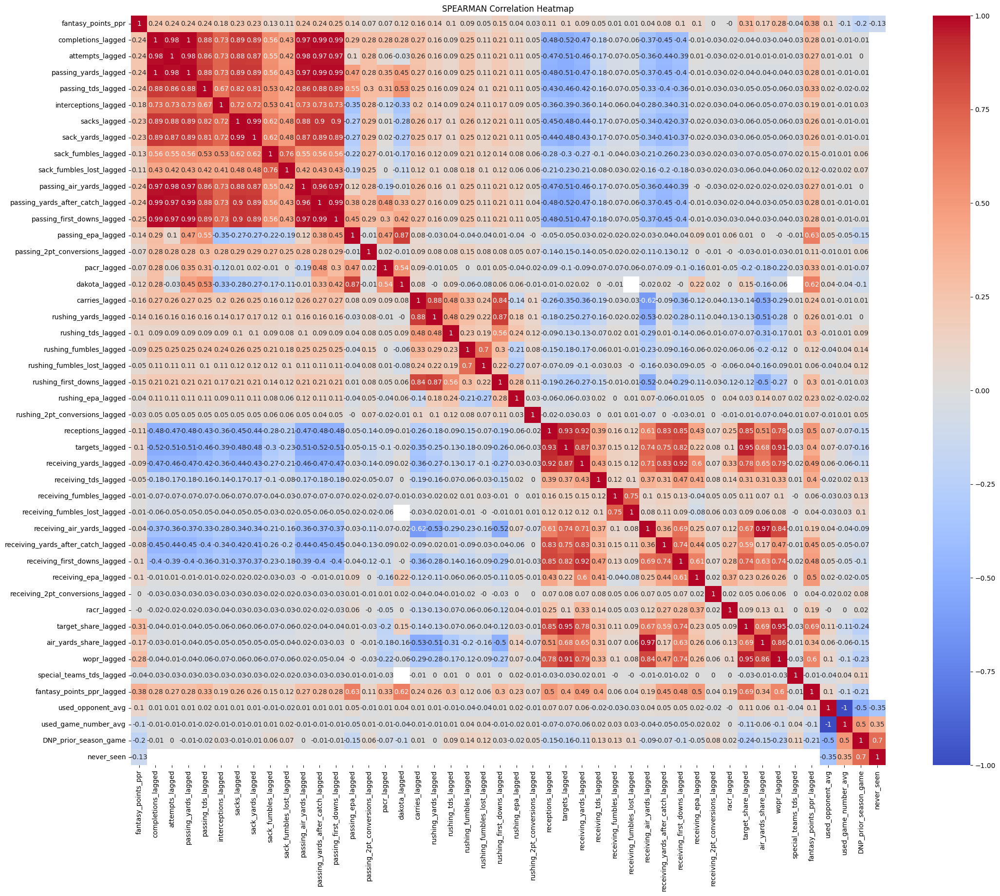

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = lagged_stats.select_dtypes(include='number').columns.tolist()

# Compute correlation matrix
corr = lagged_stats[cols_to_use].corr(method='spearman').round(2) ### ONLY using spearman as target variable is skewed

# Plot heatmap
plt.figure(figsize=(25, 20))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('SPEARMAN Correlation Heatmap')
plt.show()

In [20]:
pip install statsmodels


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


## By Position

### QBs

In [15]:
# Taking out receiving stats - irrelevant for the most part
qb_eda_df = lagged_stats[lagged_stats['position'] == 'QB'].iloc[:, list(range(0,35)) + list(range(51,56))]
qb_eda_df

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0004161,Jake Delhomme,1.0,QB,CLE,2010,1,TB,9.180000,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
3,00-0005106,Brett Favre,1.0,QB,MIN,2010,1,NO,8.840000,Thursday_Night,NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
7,00-0007091,Matt Hasselbeck,1.0,QB,SEA,2010,1,SF,19.200001,Sunday_Afternoon,SEA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
9,00-0010346,Peyton Manning,1.0,QB,IND,2010,1,HOU,29.320000,Sunday_Morning,HOU,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
11,00-0011022,Donovan McNabb,1.0,QB,WAS,2010,1,DAL,8.540000,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71954,00-0039732,Bo Nix,16.0,QB,DEN,2024,17,CIN,21.860001,Saturday_Afternoon,CIN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71963,00-0039851,Drake Maye,16.0,QB,NE,2024,17,LAC,9.880000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71974,00-0039910,Jayden Daniels,16.0,QB,WAS,2024,17,ATL,31.780001,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71977,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,11.220000,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


#### Null Counts

In [16]:
qb_eda_df.isnull().sum().to_frame('null_count').T

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
null_count,0,0,0,0,0,0,0,0,0,0,0,1941,1941,1941,1941,1941,1941,1941,1941,1941,1941,1941,1941,2149,1941,2163,2495,1941,1941,1941,1941,1941,1941,2671,1941,1941,0,0,0,0


Reasons for nulls:
- Rookies (no prior game data)
- Injured that game of prior year and didn't play team prior year either

How to deal with:
- Indicator variable for if it is a player's rookie season
- Indicator variable for if a player was injured/DNP the year prior for that game
    - If this indicator is 1, replace all lagged stats with averages across all games prior season

#### Summary Stats

In [17]:
qb_eda_df.describe()

,fantasy_points_ppr,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
count,8632.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6483.000000,6691.000000,6469.000000,6137.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,6691.000000,5961.000000,6691.000000,6691.000000,8632.000000,8632.000000,8632.000000,8632.000000
mean,13.883455,18.447055,29.235905,210.449341,1.313496,0.694083,1.949106,12.840508,0.295789,0.143424,242.102234,95.711441,10.140048,1.615741,0.055498,0.939553,0.102088,2.981317,12.583021,0.132775,0.164132,0.047891,0.950307,0.085730,0.007497,14.121841,0.288230,0.711770,0.382646,0.224861
std,8.965117,8.544700,12.890738,101.453125,1.104650,0.823712,1.554646,11.186320,0.514429,0.352879,120.482422,51.751907,5.071029,9.144935,0.220754,0.591098,0.102339,2.580728,18.018902,0.350180,0.376116,0.197346,1.215730,2.500479,0.079886,8.454957,0.452965,0.452965,0.486061,0.417515
min,-6.960000,0.000000,0.000000,-2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-13.000000,-2.000000,0.000000,-37.137157,0.000000,-0.083333,-0.180825,0.000000,-15.000000,0.000000,0.000000,0.000000,0.000000,-16.318796,0.000000,-3.760000,0.000000,0.000000,0.000000,0.000000
25%,7.300000,14.000000,24.000000,158.000000,0.333333,0.000000,1.000000,4.000000,0.000000,0.000000,176.000000,64.000000,7.000000,-3.755118,0.000000,0.699764,0.024158,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.119732,0.000000,8.340000,0.000000,0.000000,0.000000,0.000000
50%,13.950000,20.000000,31.000000,222.000000,1.000000,0.500000,2.000000,11.000000,0.000000,0.000000,251.000000,97.000000,10.833333,1.054443,0.000000,0.880682,0.089735,2.333333,6.000000,0.000000,0.000000,0.000000,0.750000,0.000000,0.000000,14.100000,0.000000,1.000000,0.000000,0.000000
75%,19.820000,24.000000,38.000000,278.000000,2.000000,1.000000,3.000000,19.000000,0.500000,0.000000,319.000000,129.000000,13.500000,7.439728,0.000000,1.081380,0.168449,4.000000,18.000000,0.000000,0.000000,0.000000,1.142857,1.276356,0.000000,19.600000,1.000000,1.000000,1.000000,0.000000
max,51.880001,45.000000,68.000000,527.000000,7.000000,5.000000,11.000000,91.000000,4.000000,3.000000,662.000000,287.000000,29.000000,41.582783,2.000000,22.000000,0.582595,26.000000,157.000000,3.000000,4.000000,2.000000,10.000000,15.164796,1.000000,49.320000,1.000000,1.000000,1.000000,1.000000


#### Histograms

In [18]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Sample dataframe
df = qb_eda_df  # Replace with your actual df

# Select numeric columns
numeric_cols = qb_eda_df.select_dtypes(include='number').columns.tolist()
num_plots = len(cols)

# Define grid size: 7 rows, 4 cols
rows = 8
cols_per_row = 4

# Create subplot figure
fig = make_subplots(rows=rows, cols=cols_per_row,
                    subplot_titles=numeric_cols[:rows*cols_per_row])

for i, col_name in enumerate(numeric_cols[:rows*cols_per_row]):
    r = (i // cols_per_row) + 1
    c = (i % cols_per_row) + 1

    fig.add_trace(
        go.Histogram(x=df[col_name], name=col_name, showlegend=False),
        row=r, col=c
    )

fig.update_layout(height=1400, width=1200, title_text="Histograms grid")
fig.show()

#### Correlation

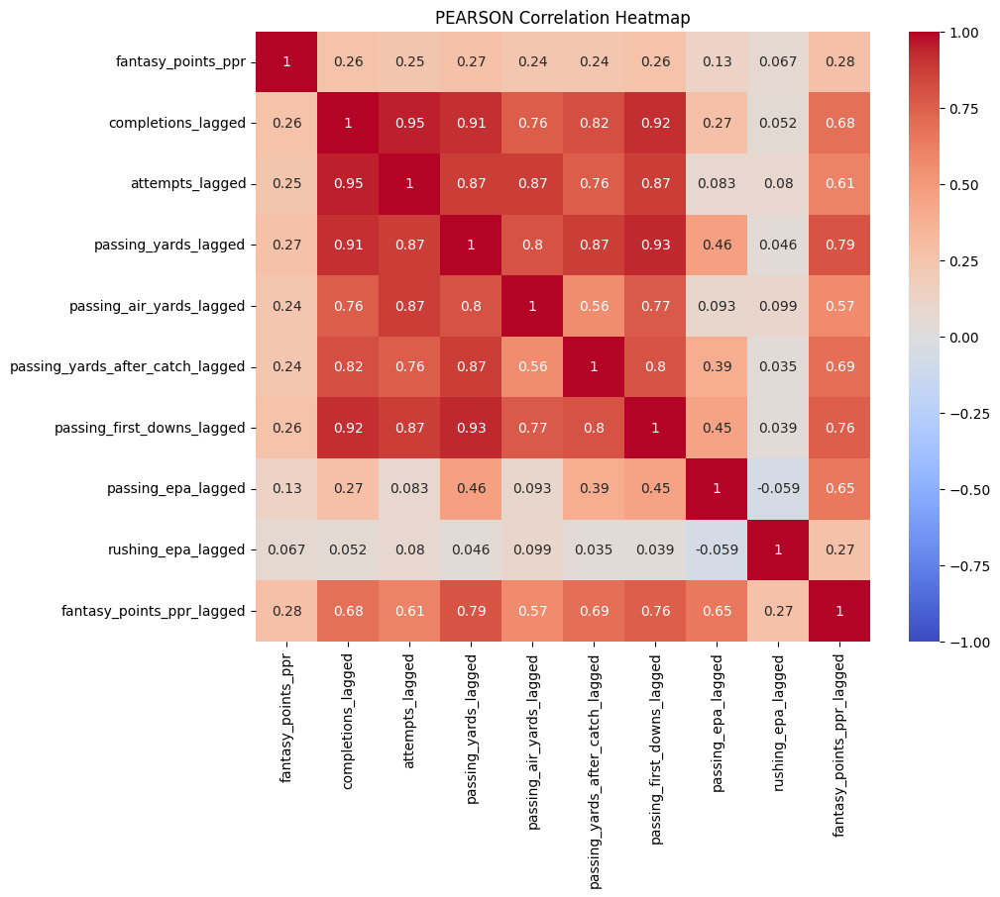

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = ['fantasy_points_ppr', 'completions_lagged', 'attempts_lagged', 'passing_yards_lagged', 'passing_air_yards_lagged', 'passing_yards_after_catch_lagged',
                        'passing_first_downs_lagged', 'passing_epa_lagged', 'rushing_epa_lagged', 'fantasy_points_ppr_lagged']

# Compute correlation matrix
corr = qb_eda_df[cols_to_use].corr(method='pearson').round(3)

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('PEARSON Correlation Heatmap')
plt.show()

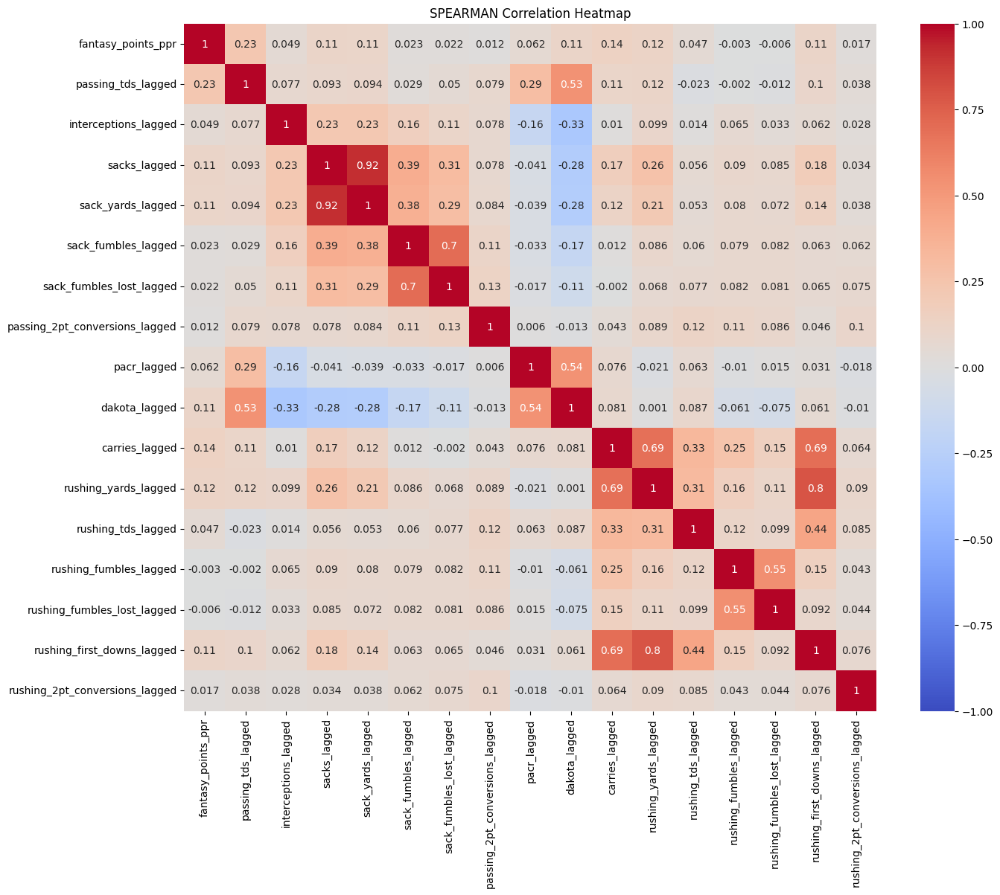

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = qb_eda_df.select_dtypes(include='number').drop(columns=['completions_lagged', 'attempts_lagged', 
                        'passing_yards_lagged', 'passing_air_yards_lagged', 'passing_yards_after_catch_lagged',
                        'passing_first_downs_lagged', 'passing_epa_lagged', 'rushing_epa_lagged', 'fantasy_points_ppr_lagged', 'used_opponent_avg', 'used_game_number_avg',
                        'DNP_prior_season_game', 'never_seen']).columns.tolist()

# Compute correlation matrix
corr = qb_eda_df[cols_to_use].corr(method='spearman').round(3) ### Looking at spearman as well because some variables are skewed

# Plot heatmap
plt.figure(figsize=(15, 12))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('SPEARMAN Correlation Heatmap')
plt.show()

### WRs

In [21]:
# Only keeping receiving stats - rushing/passing irrelevant for the most part
wr_eda_df = lagged_stats[lagged_stats['position'] == 'WR'].iloc[:, list(range(0,11)) + list(range(35, 56))]
wr_eda_df

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,14.000000,Sunday_Afternoon,PHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
4,00-0005231,Brian Finneran,1.0,WR,ATL,2010,1,PIT,0.000000,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
5,00-0005720,Joey Galloway,1.0,WR,WAS,2010,1,DAL,0.000000,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
10,00-0010500,Derrick Mason,1.0,WR,BAL,2010,1,NYJ,4.100000,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
12,00-0011754,Randy Moss,1.0,WR,NE,2010,1,CIN,10.900000,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71972,00-0039901,Keon Coleman,16.0,WR,BUF,2024,17,NYJ,11.700000,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71973,00-0039907,Ja'Lynn Polk,16.0,WR,NE,2024,17,LAC,0.000000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71975,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,29.400000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71976,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,28.700001,Monday_Night,SF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


#### Null Counts

In [22]:
wr_eda_df.isnull().sum().to_frame('null_count').T

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
null_count,0,0,0,0,0,0,0,0,0,0,0,7215,7215,7215,7215,7215,7215,7215,7215,7215,7441,7215,7472,7441,7441,7441,7215,7215,0,0,0,0


#### Summary Stats

In [23]:
wr_eda_df.describe()

,fantasy_points_ppr,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
count,28345.000000,21130.000000,21130.000000,21130.000000,21130.000000,21130.000000,21130.00000,21130.000000,21130.000000,21130.000000,20904.000000,21130.000000,20873.000000,20904.000000,20904.000000,20904.000000,21130.000000,21130.000000,28345.000000,28345.000000,28345.000000,28345.000000
mean,8.762276,3.273661,5.363094,42.733273,0.257692,0.033653,0.01840,59.632870,14.324631,2.050847,1.230115,0.009542,0.936981,0.160992,0.215151,0.392093,0.009029,9.290085,0.279097,0.720903,0.392556,0.254542
std,7.890453,2.445860,3.486932,36.228554,0.479321,0.168519,0.12339,46.184597,15.892762,1.739775,3.707499,0.089583,1.739763,0.096199,0.151077,0.237627,0.084114,7.597829,0.448563,0.448563,0.488328,0.435611
min,-3.000000,0.000000,0.000000,-7.000000,0.000000,0.000000,0.00000,-32.000000,-8.000000,0.000000,-23.140028,0.000000,-2.000000,0.015873,-0.220690,0.009724,0.000000,-2.780000,0.000000,0.000000,0.000000,0.000000
25%,2.500000,1.000000,2.500000,15.000000,0.000000,0.000000,0.00000,24.000000,3.000000,1.000000,-0.785849,0.000000,0.433962,0.081081,0.096059,0.195288,0.000000,3.400000,0.000000,0.000000,0.000000,0.000000
50%,6.700000,3.000000,5.000000,35.000000,0.000000,0.000000,0.00000,51.000000,9.500000,2.000000,0.865888,0.000000,0.743902,0.150485,0.195275,0.363758,0.000000,7.600000,0.000000,1.000000,0.000000,0.000000
75%,13.000000,5.000000,7.631119,62.000000,0.333333,0.000000,0.00000,86.000000,20.000000,3.000000,3.118169,0.000000,1.100000,0.225186,0.310475,0.549950,0.000000,13.400000,1.000000,1.000000,1.000000,1.000000
max,57.900002,18.000000,23.000000,300.000000,4.000000,2.000000,2.00000,314.000000,153.000000,13.000000,25.490833,2.000000,116.000000,0.590909,1.842105,1.789474,1.000000,57.900002,1.000000,1.000000,1.000000,1.000000


#### Histograms

In [24]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Sample dataframe
df = wr_eda_df  # Replace with your actual df

# Select numeric columns
numeric_cols = wr_eda_df.select_dtypes(include='number').columns.tolist()
num_plots = len(cols)

# Define grid size: 7 rows, 4 cols
rows = 6
cols_per_row = 4

# Create subplot figure
fig = make_subplots(rows=rows, cols=cols_per_row,
                    subplot_titles=numeric_cols[:rows*cols_per_row])

for i, col_name in enumerate(numeric_cols[:rows*cols_per_row]):
    r = (i // cols_per_row) + 1
    c = (i % cols_per_row) + 1

    fig.add_trace(
        go.Histogram(x=df[col_name], name=col_name, showlegend=False),
        row=r, col=c
    )

fig.update_layout(height=1400, width=1200, title_text="Histograms grid")
fig.show()

#### Correlation

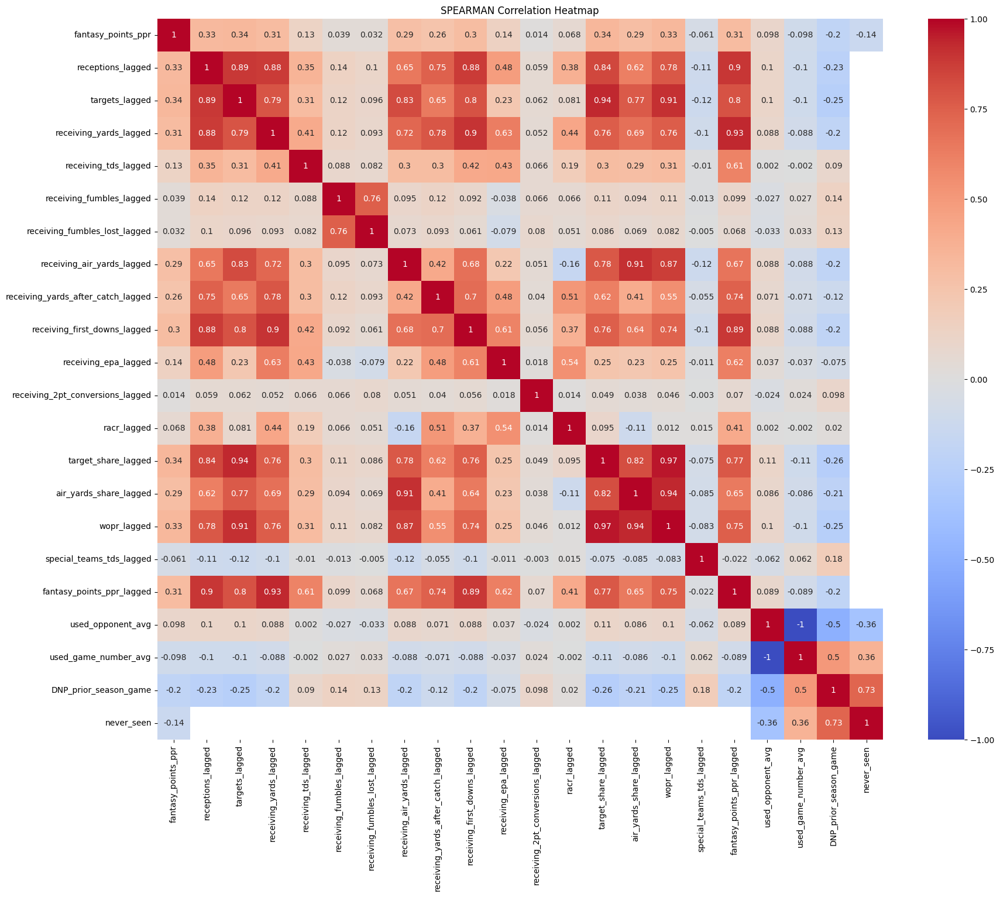

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = wr_eda_df.select_dtypes(include='number').columns.tolist()

# Compute correlation matrix
corr = wr_eda_df[cols_to_use].corr(method='spearman').round(3) ### ONLY looking at spearman because target variable is skewed

# Plot heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("SPEARMAN Correlation Heatmap")
plt.show()

### RBs/FBs

In [26]:
# Only keeping rushing/receiving stats - passing irrelevant for the most part
rb_eda_df = lagged_stats[lagged_stats['position'].isin(['RB', 'FB'])].iloc[:, list(range(0,11)) + list(range(27, 56))]
rb_eda_df

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
2,00-0005091,Kevin Faulk,1.0,RB,NE,2010,1,CIN,11.0,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
14,00-0013694,Tony Richardson,1.0,FB,NYJ,2010,1,BAL,2.9,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
16,00-0016098,Fred Taylor,1.0,RB,NE,2010,1,CIN,9.7,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
18,00-0017915,Ricky Williams,1.0,RB,MIA,2010,1,BUF,6.2,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
19,00-0019484,Sammy Morris,1.0,RB,NE,2010,1,CIN,0.2,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71955,00-0039738,Blake Corum,16.0,RB,LA,2024,17,ARI,-0.4,Saturday_Night,LA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71959,00-0039794,Braelon Allen,16.0,RB,NYJ,2024,17,BUF,2.6,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71960,00-0039796,Rasheen Ali,16.0,RB,BAL,2024,17,HOU,-0.3,Wednesday_Afternoon,HOU,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71961,00-0039798,Isaiah Davis,16.0,RB,NYJ,2024,17,BUF,5.3,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


#### Null Counts

In [27]:
rb_eda_df.isnull().sum().to_frame('null_count').T

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
null_count,0,0,0,0,0,0,0,0,0,0,0,5517,5517,5517,5517,5517,5517,6823,5517,5517,5517,5517,5517,5517,5517,5517,5517,5517,7751,5517,7886,7751,7751,7751,5517,5517,0,0,0,0


#### Summary Stats

In [28]:
rb_eda_df.describe()

,fantasy_points_ppr,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
count,20533.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,13710.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,15016.000000,12782.000000,15016.000000,12647.000000,12782.000000,12782.000000,12782.000000,15016.000000,15016.000000,20533.000000,20533.000000,20533.000000,20533.000000
mean,8.228588,8.441637,36.051937,0.245504,0.074314,0.044096,1.824823,-0.639104,0.007589,1.841406,2.450811,14.432546,0.067671,0.021699,0.010202,1.961093,14.140253,0.652019,0.084189,0.001610,0.240903,0.089574,0.006832,0.139143,0.003036,8.702289,0.263722,0.736278,0.423659,0.268689
std,7.904483,7.071124,35.454884,0.495610,0.248602,0.189242,1.904732,2.641750,0.083962,1.846477,2.266974,17.769648,0.243754,0.137264,0.092378,9.221778,17.246443,0.895203,2.020171,0.034455,7.884886,0.059868,0.045382,0.098151,0.048632,7.556914,0.440661,0.440661,0.494150,0.443289
min,-2.800000,0.000000,-11.000000,0.000000,0.000000,0.000000,0.000000,-17.034384,0.000000,0.000000,0.000000,-13.000000,0.000000,0.000000,0.000000,-51.000000,-5.000000,0.000000,-15.334975,0.000000,-95.000000,0.014706,-1.800000,-0.635000,0.000000,-2.600000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,2.000000,7.000000,0.000000,0.000000,0.000000,0.000000,-1.846540,0.000000,0.500000,1.000000,1.000000,0.000000,0.000000,0.000000,-2.000000,0.500000,0.000000,-0.816950,0.000000,-1.538822,0.041667,-0.011959,0.063677,0.000000,2.700000,0.000000,0.000000,0.000000,0.000000
50%,5.900000,7.000000,26.000000,0.000000,0.000000,0.000000,1.000000,-0.533364,0.000000,1.000000,2.000000,9.000000,0.000000,0.000000,0.000000,0.000000,8.500000,0.200000,-0.041459,0.000000,0.142857,0.074074,0.003685,0.113982,0.000000,6.650000,0.000000,1.000000,0.000000,0.000000
75%,12.400000,13.000000,56.000000,0.200000,0.000000,0.000000,3.000000,0.596231,0.000000,3.000000,3.600000,21.000000,0.000000,0.000000,0.000000,4.000000,21.000000,1.000000,0.986842,0.000000,2.200000,0.121951,0.020198,0.187557,0.000000,12.950000,1.000000,1.000000,1.000000,1.000000
max,59.500000,37.000000,238.000000,6.000000,2.000000,2.000000,14.000000,14.181790,2.000000,15.000000,20.000000,156.000000,3.000000,2.000000,1.000000,149.000000,156.000000,7.000000,13.652180,1.000000,150.000000,0.428571,0.518182,1.005584,1.000000,56.200001,1.000000,1.000000,1.000000,1.000000


#### Histograms

In [29]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Sample dataframe
df = rb_eda_df  # Replace with your actual df

# Select numeric columns
numeric_cols = rb_eda_df.select_dtypes(include='number').columns.tolist()
num_plots = len(cols)

# Define grid size: 7 rows, 4 cols
rows = 8
cols_per_row = 4

# Create subplot figure
fig = make_subplots(rows=rows, cols=cols_per_row,
                    subplot_titles=numeric_cols[:rows*cols_per_row])

for i, col_name in enumerate(numeric_cols[:rows*cols_per_row]):
    r = (i // cols_per_row) + 1
    c = (i % cols_per_row) + 1

    fig.add_trace(
        go.Histogram(x=df[col_name], name=col_name, showlegend=False),
        row=r, col=c
    )

fig.update_layout(height=1400, width=1200, title_text="Histograms grid")
fig.show()

#### Correlation

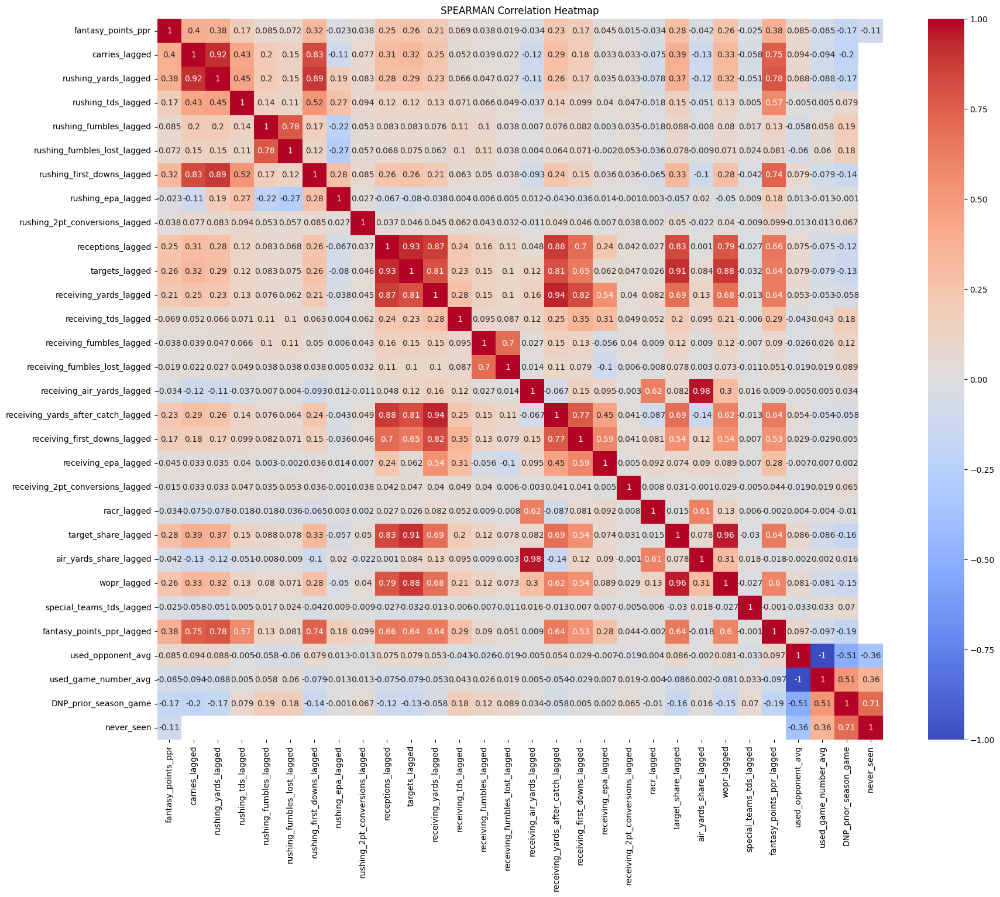

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = rb_eda_df.select_dtypes(include='number').columns.tolist()

# Compute correlation matrix
corr = rb_eda_df[cols_to_use].corr(method='spearman').round(3) ### ONLY looking at spearman because target variable is skewed

# Plot heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("SPEARMAN Correlation Heatmap")
plt.show()

### TEs

In [31]:
# Only keeping receiving stats - rushing/passing irrelevant for the most part
te_eda_df = lagged_stats[lagged_stats['position'] == 'TE'].iloc[:, list(range(0,11)) + list(range(35, 56))]
te_eda_df

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
6,00-0006101,Tony Gonzalez,1.0,TE,ATL,2010,1,PIT,5.5,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
8,00-0009323,Jimmy Kleinsasser,1.0,TE,MIN,2010,1,NO,1.6,Thursday_Night,NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
15,00-0014655,Mike Sellers,1.0,TE,WAS,2010,1,DAL,1.2,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
33,00-0020516,Todd Heap,1.0,TE,BAL,2010,1,NYJ,13.2,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
37,00-0021148,Jeremy Shockey,1.0,TE,NO,2010,1,MIN,5.3,Thursday_Night,NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71938,00-0039338,Brock Bowers,16.0,TE,LV,2024,17,NO,14.6,Sunday_Morning,NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71940,00-0039356,Ja'Tavion Sanders,16.0,TE,CAR,2024,17,TB,1.5,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71941,00-0039359,Cade Stover,16.0,TE,HOU,2024,17,BAL,1.1,Wednesday_Afternoon,HOU,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71953,00-0039631,Cam Grandy,16.0,TE,CIN,2024,17,DEN,1.7,Saturday_Afternoon,CIN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


#### Null Counts

In [32]:
te_eda_df.isnull().sum().to_frame('null_count').T

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
null_count,0,0,0,0,0,0,0,0,0,0,0,3367,3367,3367,3367,3367,3367,3367,3367,3367,3423,3367,3507,3423,3423,3423,3367,3367,0,0,0,0


#### Summary Stats

In [33]:
te_eda_df.describe()

,fantasy_points_ppr,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
count,14424.000000,11057.000000,11057.000000,11057.000000,11057.000000,11057.000000,11057.000000,11057.000000,11057.000000,11057.000000,11001.000000,11057.000000,10917.000000,11001.000000,11001.000000,11001.000000,11057.000000,11057.000000,14424.000000,14424.000000,14424.000000,14424.000000
mean,6.331412,2.486529,3.729680,27.406677,0.213662,0.027169,0.015826,28.060663,11.730103,1.411277,0.770623,0.008907,1.335781,0.111888,0.103755,0.240462,0.000098,6.565917,0.267540,0.732460,0.406961,0.233430
std,6.193554,2.008066,2.743930,26.212807,0.433783,0.153584,0.115800,27.342024,12.830843,1.401027,2.768183,0.085473,1.676981,0.077169,0.097868,0.176271,0.004820,6.033113,0.442692,0.442692,0.491284,0.423028
min,-2.000000,0.000000,0.000000,-6.000000,0.000000,0.000000,0.000000,-13.000000,-7.000000,0.000000,-15.294791,0.000000,-2.500000,0.015873,-0.121495,0.007336,0.000000,-2.000000,0.000000,0.000000,0.000000,0.000000
25%,1.800000,1.000000,1.571429,8.875000,0.000000,0.000000,0.000000,8.000000,3.000000,0.384615,-0.551518,0.000000,0.583333,0.048780,0.029777,0.098117,0.000000,2.150000,0.000000,0.000000,0.000000,0.000000
50%,4.300000,2.000000,3.000000,20.000000,0.000000,0.000000,0.000000,19.571428,8.000000,1.000000,0.540752,0.000000,1.014925,0.090909,0.075000,0.191595,0.000000,4.700000,0.000000,1.000000,0.000000,0.000000
75%,9.200000,3.500000,5.000000,39.000000,0.166667,0.000000,0.000000,41.000000,16.500000,2.000000,1.966459,0.000000,1.514490,0.159716,0.150704,0.344308,0.000000,9.200000,1.000000,1.000000,1.000000,0.000000
max,45.000000,15.000000,17.000000,210.000000,4.000000,2.000000,2.000000,208.000000,138.000000,11.000000,17.672009,1.000000,31.500000,0.481481,0.825397,1.129885,0.250000,41.900002,1.000000,1.000000,1.000000,1.000000


#### Histograms

In [34]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Sample dataframe
df = te_eda_df  # Replace with your actual df

# Select numeric columns
numeric_cols = te_eda_df.select_dtypes(include='number').columns.tolist()
num_plots = len(cols)

# Define grid size: 7 rows, 4 cols
rows = 6
cols_per_row = 4

# Create subplot figure
fig = make_subplots(rows=rows, cols=cols_per_row,
                    subplot_titles=numeric_cols[:rows*cols_per_row])

for i, col_name in enumerate(numeric_cols[:rows*cols_per_row]):
    r = (i // cols_per_row) + 1
    c = (i % cols_per_row) + 1

    fig.add_trace(
        go.Histogram(x=df[col_name], name=col_name, showlegend=False),
        row=r, col=c
    )

fig.update_layout(height=1400, width=1200, title_text="Histograms grid")
fig.show()

#### Correlation

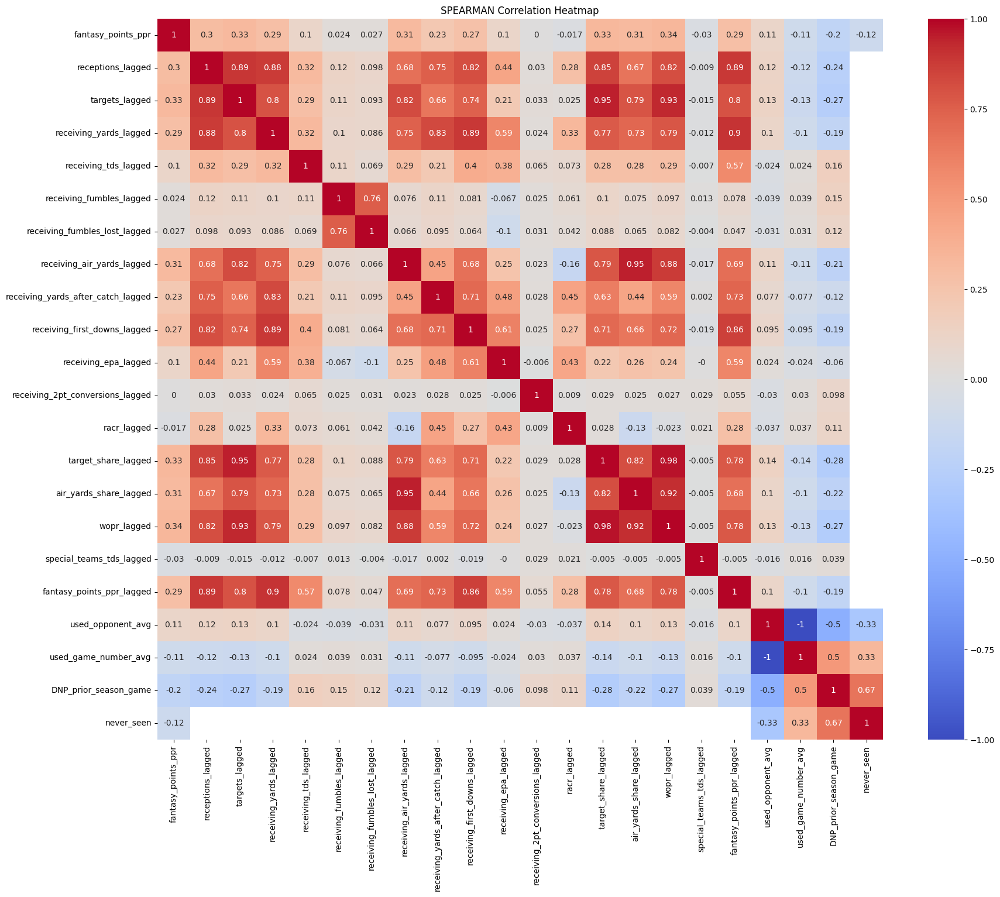

In [35]:
import seaborn as sns
import matplotlib.pyplot as plt

# Specify your columns of interest
cols_to_use = te_eda_df.select_dtypes(include='number').columns.tolist()

# Compute correlation matrix
corr = te_eda_df[cols_to_use].corr(method='spearman').round(3) ### ONLY looking at spearman because target variable is skewed

# Plot heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("SPEARMAN Correlation Heatmap")
plt.show()

# CatBoost Modeling

**Ideology**:

CatBoost is a gradient-boosting modeling method built to handle categorical features. It automatically pre-processes categorical features that are specified via target encoding, or calculating target statistics (i.e. mean) for each category. It additionally calculates these using an ordered subset of the data in order to target encode each row based on previous rows' values. This aids in avoiding target leakage as each row is target encoded without the knowledge of what that row's target variable is. As this dataset uses a number of categorical features that are important to factor in, CatBoost is naturally a good fit for ML modeling. As CatBoost also performs well on small to medium-sized datasets thanks to ordered boosting (constructing training sets for each tree to prevent target leakage and reduce overfitting) and other regularization techniques, 4 models will be created (one for each position group) to create overall predictions.

- Utilize a 70-15-15 train-validation-test split

In [42]:
pip install catboost


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [43]:
pip install scikit-learn


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [36]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error, mean_absolute_percentage_error
from catboost import CatBoostRegressor, cv, Pool
from itertools import product
from tqdm import tqdm

## QBs

In [37]:
# Training split
qb_train = qb_eda_df.sample(n=round(len(qb_eda_df)*.7), random_state=12)
qb_train_X = qb_train.loc[:, qb_train.columns!='fantasy_points_ppr']
qb_train_y = qb_train['fantasy_points_ppr']
qb_train_indices = qb_train.index

qb_nontrain = qb_eda_df.drop(qb_train.index)

# Test split
qb_test = qb_nontrain.sample(n=round(len(qb_nontrain)*.5), random_state=12)
qb_test_X = qb_test.loc[:, qb_test.columns!='fantasy_points_ppr']
qb_test_y = qb_test['fantasy_points_ppr']
qb_test_X_indices = qb_test_X.index

# Validation split
qb_val = qb_nontrain.drop(qb_test.index)
qb_val_X = qb_val.loc[:, qb_val.columns!='fantasy_points_ppr']
qb_val_y = qb_val['fantasy_points_ppr']
qb_val

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
7,00-0007091,Matt Hasselbeck,1.0,QB,SEA,2010,1,SF,19.200001,Sunday_Afternoon,SEA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
108,00-0023459,Aaron Rodgers,1.0,QB,GB,2010,1,PHI,12.420000,Sunday_Afternoon,PHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
201,00-0026158,Joe Flacco,1.0,QB,BAL,2010,1,NYJ,6.120000,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
382,00-0022787,Matt Schaub,2.0,QB,HOU,2010,2,WAS,30.080000,Sunday_Afternoon,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
384,00-0022803,Eli Manning,2.0,QB,NYG,2010,2,IND,9.040000,Sunday_Night,IND,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71879,00-0038400,Tanner McKee,16.0,QB,PHI,2024,17,DAL,9.960000,Sunday_Morning,PHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71892,00-0038579,Aidan O'Connell,16.0,QB,LV,2024,17,NO,17.580000,Sunday_Morning,NO,30.0,47.0,299.0,2.0,0.0,2.0,13.0,0.0,0.0,429.0,112.0,19.0,8.476912,0.0,0.696970,0.106150,2.0,3.0,0.0,0.0,0.0,1.0,-1.015410,0.0,20.26,0,1,0,0
71934,00-0039163,C.J. Stroud,16.0,QB,HOU,2024,17,BAL,6.100000,Wednesday_Afternoon,HOU,28.0,44.0,242.0,0.0,0.0,5.0,46.0,1.0,1.0,260.0,133.0,13.0,-11.156192,0.0,0.930769,0.002379,4.0,20.0,0.0,0.0,0.0,1.0,-0.588352,0.0,10.68,1,0,0,0
71963,00-0039851,Drake Maye,16.0,QB,NE,2024,17,LAC,9.880000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


### Cross Validation

In [38]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

qb_cv_results = []

qb_cvpool = Pool(data=qb_train_X, label=qb_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        qb_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        qb_cvscores = cv(pool=qb_cvpool, params = qb_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=11)
        best_qb_cvscore = qb_cvscores['test-MAE-mean'].min()
        qb_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_qb_cvscore})

qb_cv_results_df = pd.DataFrame(qb_cv_results)
best_params_qb = qb_cv_results_df.sort_values(by='mae').iloc[0]
best_params_qb

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [05:19<00:00, 17.77s/it]


iterations       1000.000000
learning_rate       0.030000
depth               6.000000
mae                 6.108728
Name: 13, dtype: float64

In [39]:
# Training Model on Full Training Set
final_qb_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_qb['iterations']),
    'learning_rate': float(best_params_qb['learning_rate']),
    'depth': int(best_params_qb['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

qb_catboost = CatBoostRegressor(**final_qb_params)
qb_catboost.fit(qb_train_X, qb_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(qb_val_X, qb_val_y))

In [40]:
qb_val_preds = qb_catboost.predict(qb_val_X)
print(f'Validation MAE: {mean_absolute_error(qb_val_y, qb_val_preds)}')
print(f'Validation R2: {r2_score(qb_val_y, qb_val_preds)}')

Validation MAE: 5.955763733268118
Validation R2: 0.2575433842264834


In [41]:
qb_test_preds = qb_catboost.predict(qb_test_X)
print(f'Test MAE: {mean_absolute_error(qb_test_y, qb_test_preds)}')
print(f'Test R2: {r2_score(qb_test_y, qb_test_preds)}')

# Predictions with indices
qb_test_preds_wind = np.column_stack((qb_test_X_indices, qb_test_preds))
qb_sorted_preds = qb_test_preds_wind[qb_test_preds_wind[:,0].argsort()]
qb_sorted_preds_df = pd.DataFrame(qb_sorted_preds, columns = ['index', 'prediction'])
qb_sorted_preds_df.set_index('index', inplace=True)
qb_sorted_preds_v_test = pd.concat([qb_test_X, qb_sorted_preds_df], axis = 1)
qb_test_preds_exp = pd.concat([qb_sorted_preds_v_test, qb_test_y], axis=1)
qb_test_preds_exp

Test MAE: 5.939019054381559
Test R2: 0.31621628792198975


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
60886.0,00-0034869,Sam Darnold,13.0,QB,CAR,2022,14,SEA,Sunday_Afternoon,SEA,19.454545,33.090909,209.818176,0.636364,1.090909,3.000000,17.454546,0.636364,0.181818,242.000000,112.181816,10.272727,-6.573395,0.090909,0.932098,0.040188,3.636364,18.454546,0.454545,0.090909,0.090909,1.909091,1.354638,0.0,12.965454,0,1,1,0,13.161040,11.80
27261.0,00-0024296,Charlie Whitehurst,13.0,QB,IND,2015,14,JAX,Sunday_Morning,JAX,20.500000,31.500000,260.000000,0.500000,0.000000,3.500000,19.000000,0.500000,0.000000,246.500000,97.000000,11.000000,2.992638,0.000000,1.081960,0.096804,2.500000,6.500000,0.000000,0.000000,0.000000,0.500000,-0.094627,0.0,13.050000,1,0,0,0,3.699607,-1.48
20845.0,00-0024226,Jay Cutler,8.0,QB,CHI,2014,8,NE,Sunday_Morning,NE,20.900000,33.100000,239.500000,1.700000,1.100000,1.800000,13.000000,0.400000,0.300000,296.799988,82.599998,11.700000,0.062747,0.300000,0.809315,0.112973,2.300000,11.800000,0.000000,0.100000,0.000000,0.700000,0.476893,0.0,15.360001,0,1,1,0,15.020247,21.68
45987.0,00-0034869,Sam Darnold,12.0,QB,NYJ,2019,13,CIN,Sunday_Morning,CIN,18.583333,32.166667,224.833328,1.416667,1.250000,2.166667,14.333333,0.000000,0.000000,293.833344,103.083336,10.166667,-0.256866,0.000000,0.829197,0.075765,3.500000,8.916667,0.083333,0.333333,0.083333,1.250000,-0.831336,0.0,13.384999,0,1,1,0,13.287729,10.46
40342.0,00-0030533,Matt Barkley,10.0,QB,BUF,2018,10,NYJ,Sunday_Morning,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,2.860645,21.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63301.0,00-0034857,Josh Allen,5.0,QB,BUF,2023,5,JAX,Sunday_global,global,20.000000,31.000000,424.000000,4.000000,1.000000,0.000000,0.000000,0.000000,0.000000,420.000000,202.000000,15.000000,24.854641,0.000000,1.009524,0.330383,5.000000,42.000000,0.000000,0.000000,0.000000,2.000000,2.863234,0.0,35.160000,0,1,0,0,18.023715,27.76
3928.0,00-0026993,Josh Freeman,13.0,QB,TB,2010,14,WAS,Sunday_Morning,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,15.452269,15.64
57741.0,00-0035710,Daniel Jones,3.0,QB,NYG,2022,3,DAL,Monday_Night,NYG,5.000000,13.000000,98.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,192.000000,36.000000,4.000000,0.887441,0.000000,0.510417,-0.051411,3.000000,9.000000,0.000000,0.000000,0.000000,1.000000,-0.780850,0.0,4.820000,1,0,0,0,15.084281,13.74
63952.0,00-0037077,Sam Howell,7.0,QB,WAS,2023,7,NYG,Sunday_Morning,NYG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,13.215383,9.46


### Exploring causes for errors

In [51]:
pip install shap


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [42]:
import shap
explainer_qb = shap.TreeExplainer(qb_catboost, feature_perturbation='tree_path_dependent')
shap_values_qb = explainer_qb(qb_test_X)
shap_values_qb

/Users/kevingarand/Desktop/VS code python/myenv3.10/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



.values =
array([[ 0.12718426, -0.02909622,  0.01079839, ..., -0.00625475,
        -0.05422574,  0.        ],
       [-3.61396261, -2.7365059 ,  0.04298625, ...,  0.04234179,
         0.02432914,  0.        ],
       [ 0.74639142,  0.06668904,  0.06701884, ..., -0.00861325,
        -0.02255906,  0.        ],
       ...,
       [ 0.98696398,  0.56557576, -0.04998133, ...,  0.00643863,
         0.01213931,  0.        ],
       [-0.27180811,  0.60021587, -0.065277  , ..., -0.00959056,
        -0.03073108,  0.        ],
       [ 1.84438444,  1.71662713,  0.05957254, ..., -0.01529152,
         0.03215778,  0.        ]])

.base_values =
array([13.35321344, 13.35321344, 13.35321344, ..., 13.35321344,
       13.35321344, 13.35321344])

.data =
array([['00-0034869', 'Sam Darnold', '13.0', ..., 1, 1, 0],
       ['00-0024296', 'Charlie Whitehurst', '13.0', ..., 0, 0, 0],
       ['00-0024226', 'Jay Cutler', '8.0', ..., 1, 1, 0],
       ...,
       ['00-0035710', 'Daniel Jones', '3.0', ..., 0, 0, 0

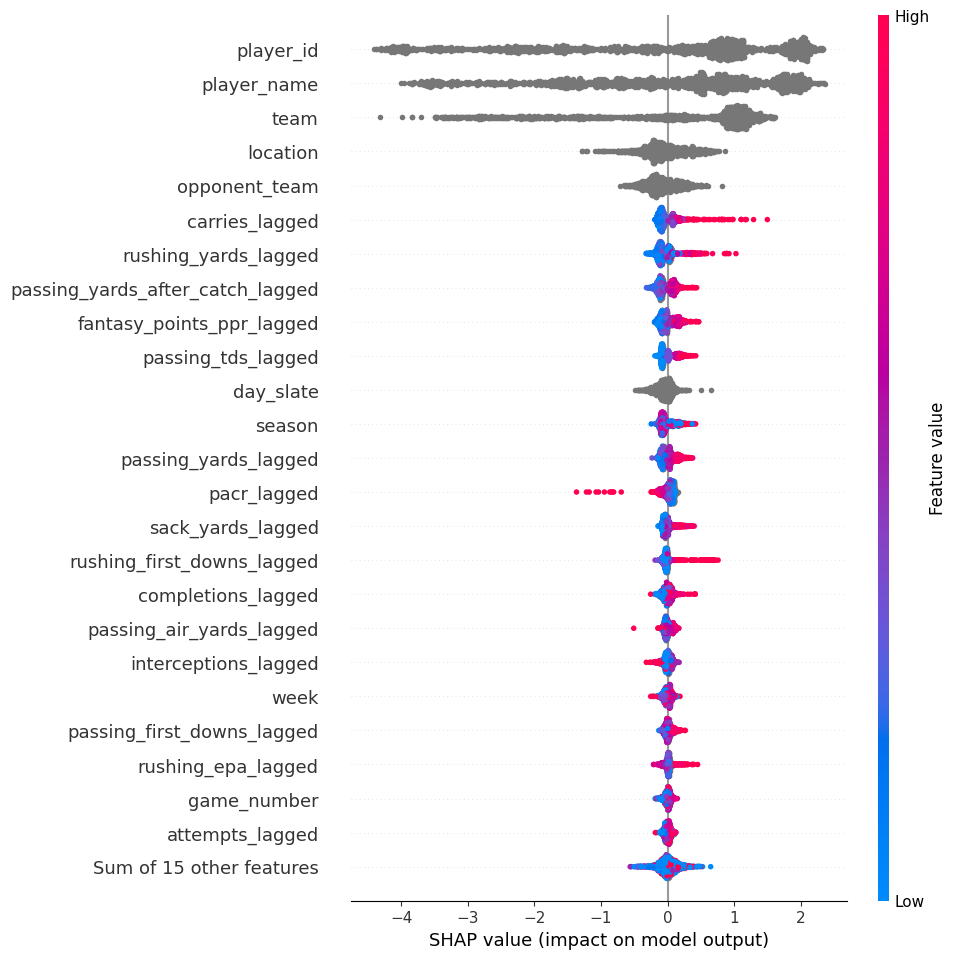

In [43]:
shap.plots.beeswarm(shap_values_qb, max_display = 25)

In [44]:
# Exploring causes for errors
qb_test_preds_exp['AE'] = abs(qb_test_preds_exp['prediction'] - qb_test_preds_exp['fantasy_points_ppr'])

print(f"% of instances where absolute error > 6 and QB has never been seen: {100 * len(qb_test_preds_exp[(qb_test_preds_exp['AE'] > 6) & (qb_test_preds_exp['never_seen'] == 1)]) / len(qb_test_preds_exp[qb_test_preds_exp['AE'] > 6]):.2f}%")
print(f"% of instances where absolute error > 6 and QB did not play in prior season game number (seen before though): {100 * len(qb_test_preds_exp[(qb_test_preds_exp['AE'] > 6) & (qb_test_preds_exp['DNP_prior_season_game'] == 1) & (qb_test_preds_exp['never_seen'] != 1)]) / len(qb_test_preds_exp[qb_test_preds_exp['AE'] > 6]):.2f}%")
print(f"Top 5 teams of QBs with largest MAE: {qb_test_preds_exp[['team', 'prediction', 'AE']].groupby(['team']).mean().sort_values('AE', ascending=False).reset_index()['team'].head(5).tolist()}")
print(f"Top 5 game locations of QBs with largest MAE: {qb_test_preds_exp[['location', 'prediction', 'AE']].groupby(['location']).mean().sort_values('AE', ascending=False).reset_index()['location'].head(5).tolist()}")
print(f"Top 5 game numbers of QBs with largest MAE: {qb_test_preds_exp[['game_number', 'prediction', 'AE']].groupby(['game_number']).mean().sort_values('AE', ascending=False).reset_index()['game_number'].head(5).tolist()}")
print(f"Top 5 seasons of QBs with largest MAE: {qb_test_preds_exp[['season', 'prediction', 'AE']].groupby(['season']).mean().sort_values('AE', ascending=False).reset_index()['season'].head(5).tolist()}")
print(f"Top 10 QBs with largest MAE: {qb_test_preds_exp[['player_name', 'prediction', 'AE']].groupby(['player_name']).mean().sort_values('AE', ascending=False).reset_index()['player_name'].head(10).tolist()}")

% of instances where absolute error > 6 and QB has never been seen: 22.52%
% of instances where absolute error > 6 and QB did not play in prior season game number (seen before though): 18.51%
Top 5 teams of QBs with largest MAE: ['GB', 'WAS', 'NYG', 'PHI', 'BUF']
Top 5 game locations of QBs with largest MAE: ['DAL', 'GB', 'PHI', 'NYG', 'NYJ']
Top 5 game numbers of QBs with largest MAE: ['8.0', '16.0', '10.0', '4.0', '6.0']
Top 5 seasons of QBs with largest MAE: ['2019', '2015', '2020', '2021', '2023']
Top 10 QBs with largest MAE: ['Malik Willis', 'Brett Favre', 'Jon Kitna', 'Bailey Zappe', 'Stephen McGee', 'Jake Browning', 'Sam Howell', 'Matt Moore', 'Drew Lock', 'Drake Maye']


## QBs with >=70 fantasy points in a season, seen before only

In [45]:
qb_season = lagged_stats[lagged_stats['position'] == 'QB'].groupby(['player_name', 'season']).agg(
    {'fantasy_points_ppr':'sum',
     'never_seen':'mean',
     'DNP_prior_season_game':'mean'}
).reset_index()
qb_season.describe()
## Median of target variable = ~70 points, so do QBs with 70+ points in a fantasy season only

,fantasy_points_ppr,never_seen,DNP_prior_season_game
count,1091.000000,1091.000000,1091.000000
mean,109.846001,0.292392,0.525917
std,111.257225,0.455070,0.436633
min,-7.280000,0.000000,0.000000
25%,8.280000,0.000000,0.000000
50%,68.160004,0.000000,0.500000
75%,206.639999,1.000000,1.000000
max,415.679993,1.000000,1.000000


In [46]:
qb_filter_df = qb_season[(qb_season['fantasy_points_ppr'] >= 70) & (qb_season['never_seen'] != 1) & (qb_season['DNP_prior_season_game'] != 1)]
qbs_filtered = qb_eda_df.merge(qb_filter_df[['player_name', 'season']], how='inner', on=['player_name', 'season'])
qbs_filtered

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0007091,Matt Hasselbeck,1.0,QB,TEN,2011,1,JAX,17.420000,Sunday_Morning,JAX,18.0,23.0,170.00,2.00,1.00,1.0,5.0,0.0,0.0,132.00,80.00,9.0,6.027418,0.0,1.287879,0.232092,2.00,4.0,1.0,0.0,0.0,1.00,0.632133,0.0,19.200001,0,1,0,0
1,00-0007091,Matt Hasselbeck,2.0,QB,TEN,2011,2,BAL,16.320000,Sunday_Morning,TEN,20.0,35.0,233.00,1.00,3.00,1.0,3.0,0.0,0.0,335.00,112.00,11.0,1.475178,0.0,0.695522,0.090619,3.00,21.0,1.0,0.0,0.0,2.00,5.171046,0.0,15.420000,0,1,0,0
2,00-0007091,Matt Hasselbeck,3.0,QB,TEN,2011,3,DEN,18.240000,Sunday_Morning,TEN,20.0,35.0,233.00,1.00,3.00,1.0,3.0,0.0,0.0,335.00,112.00,11.0,1.475178,0.0,0.695522,0.090619,3.00,21.0,1.0,0.0,0.0,2.00,5.171046,0.0,15.420000,1,0,0,0
3,00-0007091,Matt Hasselbeck,4.0,QB,TEN,2011,4,CLE,19.299999,Sunday_Morning,CLE,20.0,36.0,191.00,0.00,1.00,4.0,26.0,1.0,1.0,295.00,51.00,9.0,-18.075758,0.0,0.647458,-0.008021,1.00,3.0,0.0,0.0,0.0,0.00,-1.319311,0.0,3.940000,0,1,0,0
4,00-0007091,Matt Hasselbeck,5.0,QB,TEN,2011,5,PIT,12.780000,Sunday_Morning,PIT,25.0,40.0,242.00,1.00,0.00,0.0,0.0,0.0,0.0,270.00,69.00,14.0,2.947018,0.0,0.896296,0.070844,3.00,-3.0,0.0,0.0,0.0,0.00,-1.259380,0.0,13.380000,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5553,00-0035704,Drew Lock,11.0,QB,NYG,2024,12,TB,0.120000,Sunday_Morning,NYG,12.0,19.0,135.75,0.75,0.75,1.5,6.5,0.0,0.0,155.25,76.25,5.0,-0.163431,0.0,0.820123,0.025158,1.25,3.5,0.0,0.0,0.0,0.25,-0.070308,0.0,7.280000,0,1,1,0
5554,00-0035704,Drew Lock,12.0,QB,NYG,2024,13,DAL,14.820000,Thursday_Afternoon,DAL,12.0,19.0,135.75,0.75,0.75,1.5,6.5,0.0,0.0,155.25,76.25,5.0,-0.163431,0.0,0.820123,0.025158,1.25,3.5,0.0,0.0,0.0,0.25,-0.070308,0.0,7.280000,0,1,1,0
5555,00-0035704,Drew Lock,13.0,QB,NYG,2024,14,NO,14.980000,Sunday_Morning,NYG,22.0,31.0,269.00,2.00,2.00,4.0,15.0,0.0,0.0,235.00,167.00,11.0,-0.236313,0.0,1.144681,0.078055,3.00,5.0,0.0,0.0,0.0,0.00,-1.308873,0.0,15.260000,0,1,0,0
5556,00-0035704,Drew Lock,15.0,QB,NYG,2024,16,ATL,6.500000,Sunday_Morning,ATL,12.0,19.0,135.75,0.75,0.75,1.5,6.5,0.0,0.0,155.25,76.25,5.0,-0.163431,0.0,0.820123,0.025158,1.25,3.5,0.0,0.0,0.0,0.25,-0.070308,0.0,7.280000,0,1,1,0


In [47]:
# Training split
qbf_train = qbs_filtered.sample(n=round(len(qbs_filtered)*.7), random_state=10)
qbf_train_X = qbf_train.loc[:, qbf_train.columns!='fantasy_points_ppr']
qbf_train_y = qbf_train['fantasy_points_ppr']
qbf_train_indices = qbf_train.index

qbf_nontrain = qbs_filtered.drop(qbf_train.index)

# Test split
qbf_test = qbf_nontrain.sample(n=round(len(qbf_nontrain)*.5), random_state=10)
qbf_test_X = qbf_test.loc[:, qbf_test.columns!='fantasy_points_ppr']
qbf_test_y = qbf_test['fantasy_points_ppr']
qbf_test_X_indices = qbf_test_X.index

# Validation split
qbf_val = qbf_nontrain.drop(qbf_test.index)
qbf_val_X = qbf_val.loc[:, qbf_val.columns!='fantasy_points_ppr']
qbf_val_y = qbf_val['fantasy_points_ppr']
qbf_val


,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0007091,Matt Hasselbeck,1.0,QB,TEN,2011,1,JAX,17.420000,Sunday_Morning,JAX,18.0,23.0,170.000000,2.0,1.0,1.0,5.0,0.0,0.0,132.0,80.000000,9.0,6.027418,0.0,1.287879,0.232092,2.0,4.0,1.0,0.0,0.0,1.0,0.632133,0.0,19.200001,0,1,0,0
3,00-0007091,Matt Hasselbeck,4.0,QB,TEN,2011,4,CLE,19.299999,Sunday_Morning,CLE,20.0,36.0,191.000000,0.0,1.0,4.0,26.0,1.0,1.0,295.0,51.000000,9.0,-18.075758,0.0,0.647458,-0.008021,1.0,3.0,0.0,0.0,0.0,0.0,-1.319311,0.0,3.940000,0,1,0,0
10,00-0007091,Matt Hasselbeck,11.0,QB,TEN,2011,12,TB,6.200000,Sunday_Morning,TEN,3.0,4.0,24.000000,0.0,0.0,0.0,0.0,0.0,0.0,17.0,19.000000,0.0,1.429470,0.0,1.411765,NaN,1.0,1.0,1.0,0.0,0.0,1.0,1.555623,0.0,7.060000,1,0,0,0
14,00-0007091,Matt Hasselbeck,15.0,QB,TEN,2011,16,JAX,14.200000,Saturday_Morning,TEN,3.0,4.0,24.000000,0.0,0.0,0.0,0.0,0.0,0.0,17.0,19.000000,0.0,1.429470,0.0,1.411765,NaN,1.0,1.0,1.0,0.0,0.0,1.0,1.555623,0.0,7.060000,0,1,0,0
31,00-0020245,Mike Vick,2.0,QB,PHI,2011,2,ATL,14.180000,Sunday_Night,ATL,21.0,34.0,284.000000,2.0,0.0,6.0,37.0,2.0,0.0,384.0,125.000000,13.0,5.689315,0.0,0.739583,0.150807,7.0,37.0,0.0,0.0,0.0,2.0,1.385815,0.0,23.059999,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5533,00-0026158,Joe Flacco,10.0,QB,IND,2024,10,BUF,10.880000,Sunday_Morning,IND,24.6,40.8,323.200012,2.6,1.6,1.6,11.4,0.6,0.2,382.0,135.600006,12.0,-0.321518,0.2,0.976777,0.073575,1.8,0.4,0.0,0.2,0.0,0.6,-0.117486,0.0,20.167999,0,1,1,0
5541,00-0034771,Mason Rudolph,16.0,QB,TEN,2024,17,JAX,12.020000,Sunday_Morning,JAX,18.0,24.0,274.000000,0.0,0.0,1.0,8.0,0.0,0.0,182.0,119.000000,11.0,11.097580,0.0,1.505494,0.309049,6.0,5.0,0.0,0.0,0.0,3.0,-2.484749,0.0,11.460000,0,1,0,0
5544,00-0029263,Russell Wilson,9.0,QB,PIT,2024,10,WAS,18.100000,Sunday_Morning,WAS,18.0,32.0,308.000000,3.0,1.0,7.0,31.0,1.0,1.0,300.0,110.000000,8.0,3.346505,0.0,1.026667,0.148338,6.0,56.0,0.0,0.0,0.0,6.0,6.462872,0.0,25.920000,1,0,0,0
5552,00-0035704,Drew Lock,7.0,QB,NYG,2024,7,PHI,1.540000,Sunday_Morning,NYG,22.0,33.0,208.000000,1.0,0.0,2.0,11.0,0.0,0.0,247.0,83.000000,7.0,3.265448,0.0,0.842105,0.110262,1.0,-2.0,0.0,0.0,0.0,0.0,0.000000,0.0,12.120000,1,0,0,0


### Cross Validation

In [48]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

qbf_cv_results = []

qbf_cvpool = Pool(data=qbf_train_X, label=qbf_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        qb_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        qbf_cvscores = cv(pool=qbf_cvpool, params = qb_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=11)
        best_qbf_cvscore = qbf_cvscores['test-MAE-mean'].min()
        qbf_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_qbf_cvscore})

qbf_cv_results_df = pd.DataFrame(qbf_cv_results)
best_params_qbf = qbf_cv_results_df.sort_values(by='mae').iloc[0]
best_params_qbf

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [03:42<00:00, 12.36s/it]


iterations       500.000000
learning_rate      0.030000
depth              4.000000
mae                6.069722
Name: 3, dtype: float64

In [49]:
# Training Model on Full Training Set
final_qbf_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_qbf['iterations']),
    'learning_rate': float(best_params_qbf['learning_rate']),
    'depth': int(best_params_qbf['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

qbf_catboost = CatBoostRegressor(**final_qbf_params)
qbf_catboost.fit(qbf_train_X, qbf_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(qbf_val_X, qbf_val_y))

In [50]:
qbf_val_preds = qbf_catboost.predict(qbf_val_X)
print(f'Validation MAE: {mean_absolute_error(qbf_val_y, qbf_val_preds)}')
print(f'Validation R2: {r2_score(qbf_val_y, qbf_val_preds)}')

Validation MAE: 5.997673176453284
Validation R2: 0.11752783643652409


In [51]:
qbf_test_preds = qbf_catboost.predict(qbf_test_X)
print(f'Test MAE: {mean_absolute_error(qbf_test_y, qbf_test_preds)}')
print(f'Test R2: {r2_score(qbf_test_y, qbf_test_preds)}')

# Predictions with indices
qbf_test_preds_wind = np.column_stack((qbf_test_X_indices, qbf_test_preds))
qbf_sorted_preds = qbf_test_preds_wind[qbf_test_preds_wind[:,0].argsort()]
qbf_sorted_preds_df = pd.DataFrame(qbf_sorted_preds, columns = ['index', 'prediction'])
qbf_sorted_preds_df.set_index('index', inplace=True)
qbf_sorted_preds_v_test = pd.concat([qbf_test_X, qbf_sorted_preds_df], axis = 1)
qbf_test_preds_exp = pd.concat([qbf_sorted_preds_v_test, qbf_test_y], axis=1)
qbf_test_preds_exp

Test MAE: 5.952722080726591
Test R2: 0.09677953695651109


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
4669.0,00-0036971,Trevor Lawrence,7.0,QB,JAX,2022,7,NYG,Sunday_Morning,JAX,32.000000,54.000000,238.000000,1.000000,1.000000,1.0,11.000000,0.000000,0.000000,279.0,154.000000,17.000000,-7.699882,0.000000,0.853047,-0.010704,3.000000,11.000000,0.000000,0.000000,0.000000,0.000000,-1.292308,0.0,12.620000,0,1,0,0,14.209453,18.700001
1490.0,00-0030565,Geno Smith,1.0,QB,NYJ,2014,1,LV,Sunday_Morning,NYJ,16.000000,25.000000,219.000000,1.000000,1.000000,1.0,10.000000,0.000000,0.000000,131.0,123.000000,9.000000,4.915254,0.000000,1.671756,0.198605,5.000000,50.000000,1.000000,0.000000,0.000000,3.000000,6.536024,0.0,21.760000,1,0,0,0,15.429075,12.640000
412.0,00-0021429,Carson Palmer,2.0,QB,LV,2012,2,MIA,Sunday_Morning,MIA,20.000000,41.000000,273.000000,2.000000,1.000000,2.0,15.000000,0.000000,0.000000,437.0,88.000000,12.000000,-1.226834,0.000000,0.624714,0.002722,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.360314,0.0,17.120001,1,0,0,0,15.253438,17.620001
1721.0,00-0026158,Joe Flacco,1.0,QB,BAL,2015,1,DEN,Sunday_Afternoon,DEN,35.000000,62.000000,345.000000,1.000000,1.000000,3.0,16.000000,0.000000,0.000000,489.0,124.000000,16.000000,-4.871387,0.000000,0.705521,-0.023444,3.000000,7.000000,0.000000,0.000000,0.000000,2.000000,1.793058,0.0,16.500000,0,1,0,0,15.281090,0.680000
5349.0,00-0036212,Tua Tagovailoa,11.0,QB,MIA,2024,12,NE,Sunday_Morning,MIA,25.500000,37.500000,286.500000,2.000000,1.000000,1.5,8.500000,0.000000,0.000000,287.0,137.000000,16.000000,11.924225,0.000000,0.993973,0.159436,5.000000,5.500000,0.000000,1.500000,0.500000,0.500000,-5.464259,0.0,17.010000,1,0,0,0,15.815332,28.480000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5071.0,00-0037834,Brock Purdy,14.0,QB,SF,2023,15,ARI,Sunday_Afternoon,ARI,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,NaN,0.000000,NaN,NaN,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.314846,0.0,0.300000,1,0,0,0,17.403790,25.680000
44.0,00-0020531,Drew Brees,3.0,QB,NO,2011,3,HOU,Sunday_Morning,NO,30.000000,38.000000,365.000000,3.000000,2.000000,2.0,10.000000,0.000000,0.000000,281.0,206.000000,17.000000,8.612495,0.000000,1.298932,0.206769,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.0,22.600000,0,1,0,0,19.360854,26.700001
985.0,00-0027939,Cam Newton,10.0,QB,CAR,2013,11,NE,Monday_Night,CAR,16.000000,29.000000,252.000000,1.000000,0.000000,2.0,18.000000,0.000000,0.000000,291.0,115.000000,10.000000,6.545709,0.000000,0.865979,0.096505,11.000000,40.000000,0.000000,0.000000,0.000000,3.000000,0.216940,0.0,18.080000,0,1,0,0,17.970347,26.559999
674.0,00-0027946,Jake Locker,10.0,QB,TEN,2012,10,MIA,Sunday_Morning,MIA,9.000000,19.000000,140.000000,2.000000,0.000000,1.0,7.000000,0.000000,0.000000,191.0,42.000000,6.000000,9.031020,0.000000,0.732984,0.161103,1.000000,11.000000,0.000000,0.000000,0.000000,1.000000,1.875331,0.0,14.700000,0,1,0,0,12.935845,16.480000


## WRs

In [52]:
# Training split
wr_train = wr_eda_df.sample(n=round(len(wr_eda_df)*.7), random_state=18)
wr_train_X = wr_train.loc[:, wr_train.columns!='fantasy_points_ppr']
wr_train_y = wr_train['fantasy_points_ppr']
wr_train_indices = wr_train.index

wr_nontrain = wr_eda_df.drop(wr_train.index)

# Test split
wr_test = wr_nontrain.sample(n=round(len(wr_nontrain)*.5), random_state=18)
wr_test_X = wr_test.loc[:, wr_test.columns!='fantasy_points_ppr']
wr_test_y = wr_test['fantasy_points_ppr']
wr_test_X_indices = wr_test_X.index

# Validation split
wr_val = wr_nontrain.drop(wr_test.index)
wr_val_X = wr_val.loc[:, wr_val.columns!='fantasy_points_ppr']
wr_val_y = wr_val['fantasy_points_ppr']
wr_val


,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,14.0,Sunday_Afternoon,PHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
5,00-0005720,Joey Galloway,1.0,WR,WAS,2010,1,DAL,0.0,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
13,00-0012478,Terrell Owens,1.0,WR,CIN,2010,1,NE,12.3,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
29,00-0020498,Reggie Wayne,1.0,WR,IND,2010,1,HOU,22.9,Sunday_Morning,HOU,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
40,00-0021163,Jabar Gaffney,1.0,WR,DEN,2010,1,JAX,12.4,Sunday_Morning,JAX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71881,00-0038465,Malik Heath,16.0,WR,GB,2024,17,MIN,7.3,Sunday_Afternoon,MIN,1.0,2.0,13.0,0.0,0.0,0.0,23.0,6.0,1.0,1.385362,0.0,0.565217,0.058824,0.064426,0.133333,0.0,2.3,1,0,0,0
71889,00-0038559,Michael Wilson,16.0,WR,ARI,2024,17,LA,6.9,Saturday_Night,LA,3.0,4.0,62.0,0.0,0.0,0.0,60.0,7.0,3.0,5.991292,0.0,1.033333,0.105263,0.156658,0.267555,0.0,9.2,1,0,0,0
71896,00-0038606,Parker Washington,16.0,WR,JAX,2024,17,TEN,12.1,Sunday_Morning,JAX,1.0,1.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,-0.868680,0.0,1.000000,0.043478,0.013605,0.074741,0.0,1.2,0,1,0,0
71911,00-0038824,Ryan Miller,16.0,WR,TB,2024,17,CAR,4.6,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


### Cross Validation

In [53]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

wr_cv_results = []

wr_cvpool = Pool(data=wr_train_X, label=wr_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        wr_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        wr_cvscores = cv(pool=wr_cvpool, params = wr_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=18)
        best_wr_cvscore = wr_cvscores['test-MAE-mean'].min()
        wr_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_wr_cvscore})

wr_cv_results_df = pd.DataFrame(wr_cv_results)
best_params_wr = wr_cv_results_df.sort_values(by='mae').iloc[0]
best_params_wr

100%|██████████| 18/18 [08:24<00:00, 28.04s/it]


iterations       1000.00000
learning_rate       0.01000
depth               8.00000
mae                 4.98711
Name: 11, dtype: float64

In [54]:
# Training Model on Full Training Set
final_wr_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_wr['iterations']),
    'learning_rate': float(best_params_wr['learning_rate']),
    'depth': int(best_params_wr['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

wr_catboost = CatBoostRegressor(**final_wr_params)
wr_catboost.fit(wr_train_X, wr_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(wr_val_X, wr_val_y))

In [55]:
wr_val_preds = wr_catboost.predict(wr_val_X)
print(f'Validation MAE: {mean_absolute_error(wr_val_y, wr_val_preds)}')
print(f'Validation R2: {r2_score(wr_val_y, wr_val_preds)}')

Validation MAE: 5.055909806491361
Validation R2: 0.22335346606500162


In [56]:
wr_test_preds = wr_catboost.predict(wr_test_X)
print(f'Test MAE: {mean_absolute_error(wr_test_y, wr_test_preds)}')
print(f'Test R2: {r2_score(wr_test_y, wr_test_preds)}')

# Predictions with indices
wr_test_preds_wind = np.column_stack((wr_test_X_indices, wr_test_preds))
wr_sorted_preds = wr_test_preds_wind[wr_test_preds_wind[:,0].argsort()]
wr_sorted_preds_df = pd.DataFrame(wr_sorted_preds, columns = ['index', 'prediction'])
wr_sorted_preds_df.set_index('index', inplace=True)
wr_sorted_preds_v_test = pd.concat([wr_test_X, wr_sorted_preds_df], axis = 1)
wr_test_preds_exp = pd.concat([wr_sorted_preds_v_test, wr_test_y], axis=1)
wr_test_preds_exp

Test MAE: 4.974293749386388
Test R2: 0.23185263042535875


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
37272.0,00-0033307,Kendrick Bourne,14.0,WR,SF,2017,15,TEN,Sunday_Afternoon,SF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,4.368976,12.5
10162.0,00-0027681,Brandon LaFell,3.0,WR,CAR,2012,3,NYG,Thursday_Night,CAR,2.428571,3.857143,41.857143,0.214286,0.000000,0.000000,50.714287,16.142857,1.500000,1.954026,0.0,0.984467,0.125931,0.193018,0.324008,0.0,7.900000,0,1,1,0,9.580862,3.7
51852.0,00-0029000,Cole Beasley,1.0,WR,BUF,2021,1,PIT,Sunday_Morning,BUF,5.000000,10.000000,41.000000,0.000000,0.000000,0.000000,83.000000,26.000000,2.000000,-2.304453,0.0,0.493976,0.238095,0.182418,0.484835,0.0,9.100000,1,0,0,0,8.759766,14.0
23962.0,00-0030460,Markus Wheaton,2.0,WR,PIT,2015,2,SF,Sunday_Morning,PIT,5.000000,8.000000,38.000000,0.000000,0.000000,0.000000,45.000000,28.000000,2.000000,0.804461,0.0,0.844444,0.216216,0.202703,0.466216,0.0,11.000000,0,1,0,0,6.133824,8.7
10577.0,00-0029707,Justin Blackmon,4.0,WR,JAX,2012,4,CIN,Sunday_Afternoon,JAX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,9.331889,10.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66278.0,00-0037487,Deven Thompkins,14.0,WR,TB,2023,15,GB,Sunday_Morning,GB,1.000000,1.000000,7.000000,0.000000,0.000000,0.000000,4.000000,3.000000,0.000000,-0.060864,0.0,1.750000,0.023810,0.012903,0.044747,0.0,2.600000,0,1,0,0,2.446278,-0.1
20049.0,00-0027918,Andrew Hawkins,4.0,WR,CLE,2014,5,TEN,Sunday_Morning,TEN,1.285714,1.857143,17.857143,0.000000,0.000000,0.000000,8.714286,12.714286,0.571429,0.524039,0.0,2.672961,0.068853,0.032394,0.125955,0.0,3.114286,0,1,1,0,5.927177,5.6
63491.0,00-0030279,Keenan Allen,5.0,WR,LAC,2023,6,DAL,Monday_Night,LAC,6.444444,8.666667,72.222221,0.222222,0.111111,0.111111,75.444443,23.444445,3.444444,2.028409,0.0,1.198994,0.231277,0.293491,0.552360,0.0,14.866667,0,1,1,0,15.698590,21.5
60940.0,00-0036358,CeeDee Lamb,13.0,WR,DAL,2022,14,HOU,Sunday_Morning,DAL,7.000000,10.000000,61.000000,0.000000,0.000000,0.000000,60.000000,39.000000,4.000000,-0.434593,0.0,1.016667,0.256410,0.246914,0.557455,0.0,14.600000,0,1,0,0,15.806026,8.3


### Exploring causes for errors

In [57]:
import shap
explainer_wr = shap.TreeExplainer(wr_catboost, feature_perturbation='tree_path_dependent')
shap_values_wr = explainer_wr(wr_test_X)
shap_values_wr

.values =
array([[-0.69830458, -0.83741373, -0.05679496, ..., -0.00612945,
        -0.0513467 ,  0.        ],
       [ 1.01245883,  1.18579801,  0.05486811, ..., -0.00345628,
        -0.11083167,  0.        ],
       [ 0.00663768, -0.09179858,  0.07614193, ...,  0.00935648,
         0.03508649,  0.        ],
       ...,
       [ 2.79426841,  2.52643826,  0.0178823 , ...,  0.00531601,
        -0.14469944,  0.        ],
       [ 2.76191841,  2.43458291, -0.0574296 , ..., -0.01076694,
         0.02864976,  0.        ],
       [-0.29674974, -0.23489613, -0.01230635, ..., -0.00455926,
         0.02181111,  0.        ]])

.base_values =
array([7.32176643, 7.32176643, 7.32176643, ..., 7.32176643, 7.32176643,
       7.32176643])

.data =
array([['00-0033307', 'Kendrick Bourne', '14.0', ..., 1, 1, 1],
       ['00-0027681', 'Brandon LaFell', '3.0', ..., 1, 1, 0],
       ['00-0029000', 'Cole Beasley', '1.0', ..., 0, 0, 0],
       ...,
       ['00-0030279', 'Keenan Allen', '5.0', ..., 1, 1, 0],
  

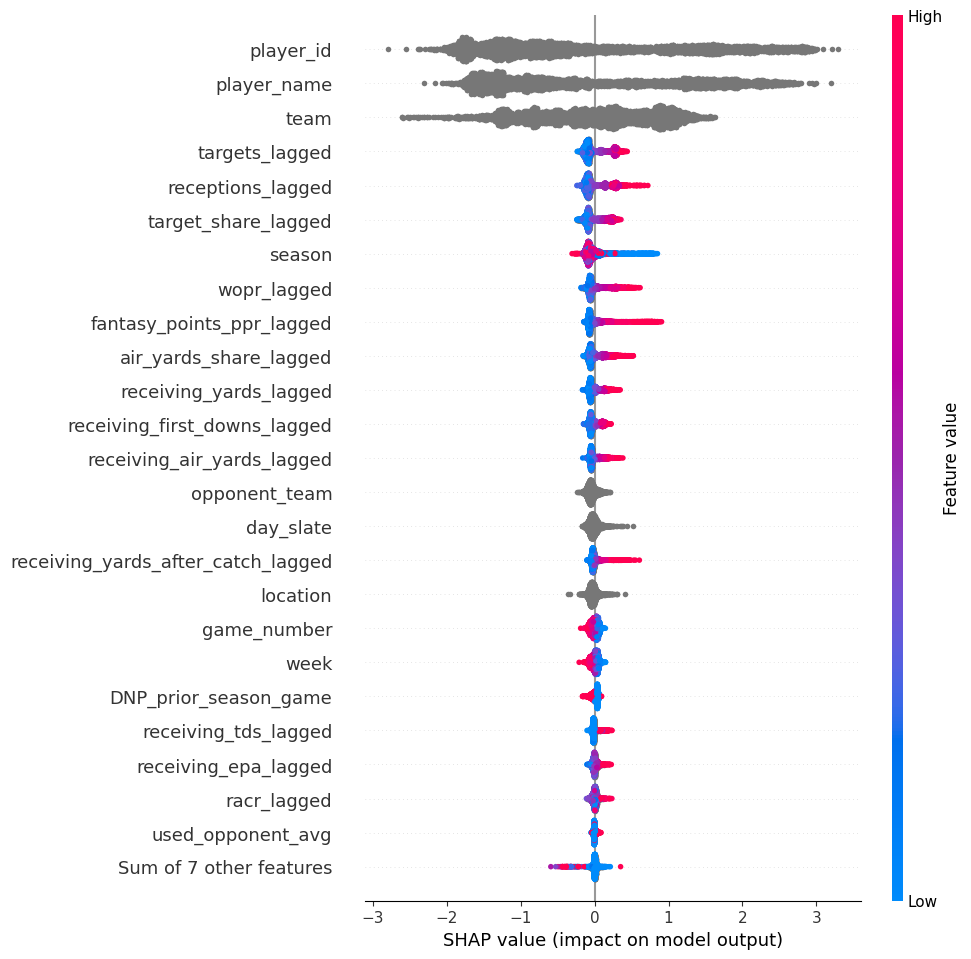

In [58]:
shap.plots.beeswarm(shap_values_wr, max_display = 25)

## RBs

In [59]:
# Training split
rb_train = rb_eda_df.sample(n=round(len(rb_eda_df)*.7), random_state=30)
rb_train_X = rb_train.loc[:, rb_train.columns!='fantasy_points_ppr']
rb_train_y = rb_train['fantasy_points_ppr']
rb_train_indices = rb_train.index

rb_nontrain = rb_eda_df.drop(rb_train.index)

# Test split
rb_test = rb_nontrain.sample(n=round(len(rb_nontrain)*.5), random_state=30)
rb_test_X = rb_test.loc[:, rb_test.columns!='fantasy_points_ppr']
rb_test_y = rb_test['fantasy_points_ppr']
rb_test_X_indices = rb_test_X.index

# Validation split
rb_val = rb_nontrain.drop(rb_test.index)
rb_val_X = rb_val.loc[:, rb_val.columns!='fantasy_points_ppr']
rb_val_y = rb_val['fantasy_points_ppr']
rb_val


,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
35,00-0020536,LaDainian Tomlinson,1.0,RB,NYJ,2010,1,BAL,9.8,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
56,00-0021755,Earnest Graham,1.0,RB,TB,2010,1,CLE,0.8,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
72,00-0022405,Lousaka Polite,1.0,FB,MIA,2010,1,BUF,3.8,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
83,00-0022821,Michael Turner,1.0,RB,ATL,2010,1,PIT,5.9,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
85,00-0022897,Greg Jones,1.0,RB,JAX,2010,1,DEN,0.9,Sunday_Morning,JAX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71947,00-0039384,Tyrone Tracy,16.0,RB,NYG,2024,17,IND,9.3,Sunday_Morning,NYG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71948,00-0039391,Kimani Vidal,16.0,RB,LAC,2024,17,NE,2.4,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71955,00-0039738,Blake Corum,16.0,RB,LA,2024,17,ARI,-0.4,Saturday_Night,LA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71959,00-0039794,Braelon Allen,16.0,RB,NYJ,2024,17,BUF,2.6,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


### Cross Validation

In [60]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

rb_cv_results = []

rb_cvpool = Pool(data=rb_train_X, label=rb_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        rb_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        rb_cvscores = cv(pool=rb_cvpool, params = rb_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=30)
        best_rb_cvscore = rb_cvscores['test-MAE-mean'].min()
        rb_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_rb_cvscore})

rb_cv_results_df = pd.DataFrame(rb_cv_results)
best_params_rb = rb_cv_results_df.sort_values(by='mae').iloc[0]
best_params_rb

100%|██████████| 18/18 [08:47<00:00, 29.30s/it]


iterations       1000.000000
learning_rate       0.030000
depth               6.000000
mae                 4.677777
Name: 13, dtype: float64

In [61]:
# Training Model on Full Training Set
final_rb_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_rb['iterations']),
    'learning_rate': float(best_params_rb['learning_rate']),
    'depth': int(best_params_rb['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

rb_catboost = CatBoostRegressor(**final_rb_params)
rb_catboost.fit(rb_train_X, rb_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(rb_val_X, rb_val_y))

In [62]:
rb_val_preds = rb_catboost.predict(rb_val_X)
print(f'Validation MAE: {mean_absolute_error(rb_val_y, rb_val_preds)}')
print(f'Validation R2: {r2_score(rb_val_y, rb_val_preds)}')

Validation MAE: 4.654278213949994
Validation R2: 0.28995476588807134


In [63]:
rb_test_preds = rb_catboost.predict(rb_test_X)
print(f'Test MAE: {mean_absolute_error(rb_test_y, rb_test_preds)}')
print(f'Test R2: {r2_score(rb_test_y, rb_test_preds)}')

# Predictions with indices
rb_test_preds_wind = np.column_stack((rb_test_X_indices, rb_test_preds))
rb_sorted_preds = rb_test_preds_wind[rb_test_preds_wind[:,0].argsort()]
rb_sorted_preds_df = pd.DataFrame(rb_sorted_preds, columns = ['index', 'prediction'])
rb_sorted_preds_df.set_index('index', inplace=True)
rb_sorted_preds_v_test = pd.concat([rb_test_X, rb_sorted_preds_df], axis = 1)
rb_test_preds_exp = pd.concat([rb_sorted_preds_v_test, rb_test_y], axis=1)
rb_test_preds_exp

Test MAE: 4.630191167189465
Test R2: 0.2870807451387195


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
24028.0,00-0031493,Jarryd Hayne,2.0,RB,SF,2015,2,PIT,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,2.126136,0.300000
6218.0,00-0024559,D.J. Ware,6.0,RB,NYG,2011,6,BUF,Sunday_Morning,NYG,3.333333,12.166667,0.000000,0.000000,0.000000,1.166667,-0.491446,0.0,1.000000,1.333333,8.500000,0.0,0.0,0.0,4.500000,7.000000,0.333333,0.099140,0.0,0.064615,0.055585,0.014550,0.093562,0.0,3.066667,0,1,1,0,2.161232,1.900000
71813.0,00-0036875,Rhamondre Stevenson,16.0,RB,NE,2024,17,LAC,Saturday_Morning,NE,9.000000,39.000000,0.000000,1.000000,1.000000,3.000000,-2.257059,0.0,1.000000,1.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,-0.640769,0.0,NaN,0.041667,0.000000,0.062500,0.0,2.900000,1,0,0,0,9.278624,0.100000
41527.0,00-0031665,Zach Zenner,13.0,RB,DET,2018,14,ARI,Sunday_Afternoon,ARI,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-2.129197,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN,NaN,NaN,0.0,0.000000,0,1,0,0,2.997141,11.400000
57673.0,00-0034301,Darrel Williams,3.0,RB,ARI,2022,3,LA,Sunday_Afternoon,ARI,7.000000,28.000000,0.000000,0.000000,0.000000,3.000000,0.675689,0.0,2.000000,3.000000,11.000000,0.0,0.0,0.0,2.000000,9.000000,1.000000,0.198242,0.0,5.500000,0.075000,0.006042,0.116730,0.0,5.900000,0,1,0,0,3.327356,0.700000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27758.0,00-0030547,Denard Robinson,14.0,RB,JAX,2015,15,ATL,Sunday_Morning,JAX,10.384615,44.769230,0.307692,0.153846,0.153846,1.769231,-1.580904,0.0,1.769231,2.384615,9.538462,0.0,0.0,0.0,-6.307693,15.461538,0.461538,-0.270148,0.0,-0.643803,0.070407,-0.045913,0.073472,0.0,8.738461,0,1,1,0,4.593217,16.700001
16221.0,00-0027029,LeSean McCoy,8.0,RB,PHI,2013,8,NYG,Sunday_Morning,PHI,23.000000,123.000000,0.000000,1.000000,0.000000,6.000000,-1.806905,0.0,3.000000,4.000000,17.000000,0.0,0.0,0.0,-10.000000,21.000000,1.000000,-0.454453,0.0,-1.700000,0.148148,-0.040323,0.193996,0.0,17.000000,1,0,0,0,16.252660,10.500000
39688.0,00-0034109,Phillip Lindsay,7.0,RB,DEN,2018,7,ARI,Thursday_Night,ARI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,9.306647,16.600000
7753.0,00-0028087,Dion Lewis,10.0,RB,PHI,2011,11,NYG,Sunday_Night,NYG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,3.900717,0.100000


### Exploring causes for errors

In [64]:
explainer_rb = shap.TreeExplainer(rb_catboost, feature_perturbation='tree_path_dependent')
shap_values_rb = explainer_rb(rb_test_X)
shap_values_rb

.values =
array([[-8.90144498e-01, -1.85623913e+00, -1.02817668e-01, ...,
         7.36117638e-04,  5.06839548e-03,  0.00000000e+00],
       [-9.71368087e-01, -2.43072789e+00,  2.58798842e-04, ...,
         2.49013869e-03, -2.36623576e-03,  0.00000000e+00],
       [ 1.08222850e-01,  1.51540663e+00, -2.43688169e-02, ...,
        -2.83173195e-03,  1.19647038e-02,  0.00000000e+00],
       ...,
       [ 3.48726117e-01,  1.65733357e+00,  2.20498617e-02, ...,
         9.30666007e-04, -2.00520189e-03,  0.00000000e+00],
       [-1.57199576e-01, -1.18011709e+00,  2.88039260e-02, ...,
         2.17746360e-03, -2.50380372e-03,  0.00000000e+00],
       [-2.72943184e-01, -1.56685696e+00,  5.70091666e-02, ...,
         2.17746360e-03, -8.80324673e-03,  0.00000000e+00]])

.base_values =
array([6.79570243, 6.79570243, 6.79570243, ..., 6.79570243, 6.79570243,
       6.79570243])

.data =
array([['00-0031493', 'Jarryd Hayne', '2.0', ..., 1, 1, 1],
       ['00-0024559', 'D.J. Ware', '6.0', ..., 1, 1, 0],

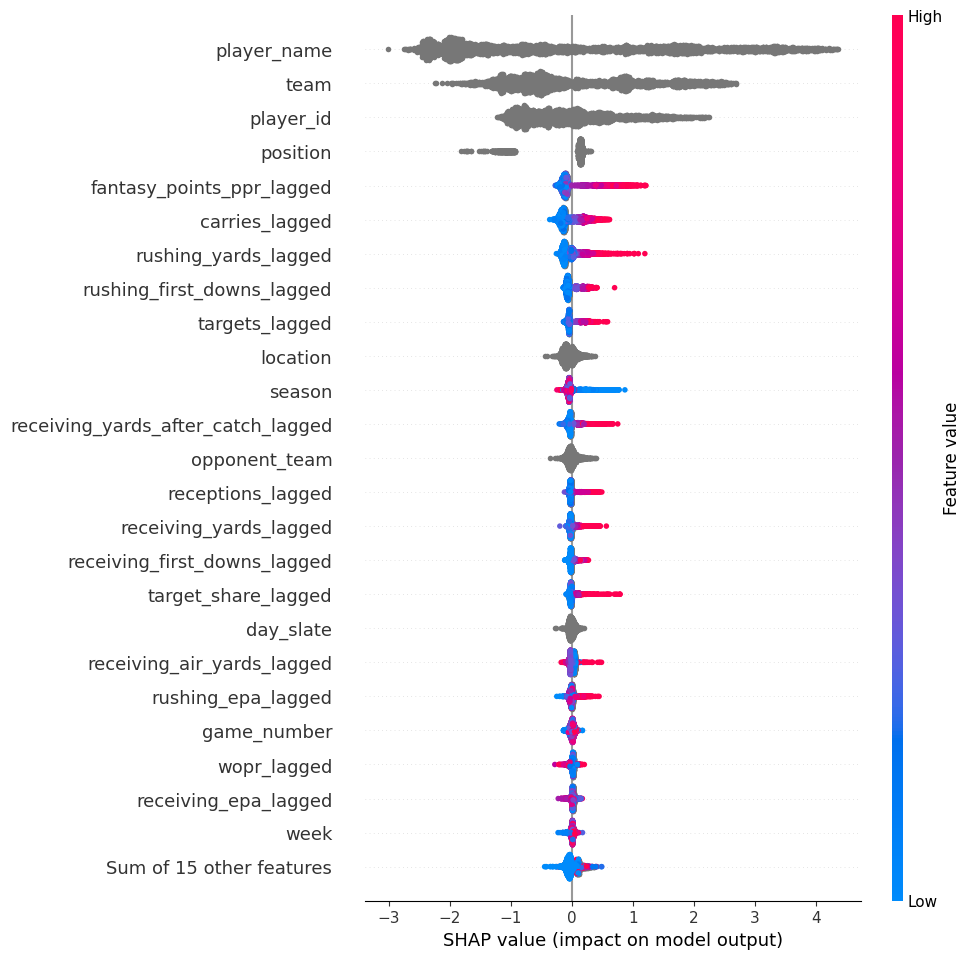

In [65]:
shap.plots.beeswarm(shap_values_rb, max_display = 25)

## TEs

In [66]:
# Training split
te_train = te_eda_df.sample(n=round(len(te_eda_df)*.7), random_state=87)
te_train_X = te_train.loc[:, te_train.columns!='fantasy_points_ppr']
te_train_y = te_train['fantasy_points_ppr']
te_train_indices = te_train.index

te_nontrain = te_eda_df.drop(te_train.index)

# Test split
te_test = te_nontrain.sample(n=round(len(te_nontrain)*.5), random_state=87)
te_test_X = te_test.loc[:, te_test.columns!='fantasy_points_ppr']
te_test_y = te_test['fantasy_points_ppr']
te_test_X_indices = te_test_X.index

# Validation split
te_val = te_nontrain.drop(te_test.index)
te_val_X = te_val.loc[:, te_val.columns!='fantasy_points_ppr']
te_val_y = te_val['fantasy_points_ppr']
te_val

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
15,00-0014655,Mike Sellers,1.0,TE,WAS,2010,1,DAL,1.2,Sunday_Night,WAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
33,00-0020516,Todd Heap,1.0,TE,BAL,2010,1,NYJ,13.2,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
92,00-0022943,Benjamin Watson,1.0,TE,CLE,2010,1,TB,4.5,Sunday_Morning,TB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
111,00-0023465,Heath Miller,1.0,TE,PIT,2010,1,ATL,8.0,Sunday_Morning,PIT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
123,00-0023752,Daniel Fells,1.0,TE,LA,2010,1,ARI,5.5,Sunday_Afternoon,LA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71814,00-0036876,Kylen Granson,16.0,TE,IND,2024,17,NYG,6.4,Sunday_Morning,NYG,1.000000,3.000000,13.000000,0.0,0.0,0.0,41.000,4.000000,1.0,0.752037,0.0,0.317073,0.150000,0.256250,0.404375,0.0,2.3000,0,1,0,0
71854,00-0037539,Lucas Krull,16.0,TE,DEN,2024,17,CIN,1.3,Saturday_Afternoon,CIN,2.000000,2.000000,14.000000,0.0,0.0,0.0,-3.000,17.000000,1.0,1.330240,0.0,0.000000,0.066667,-0.013699,0.090411,0.0,3.4000,0,1,0,0
71888,00-0038558,Darnell Washington,16.0,TE,PIT,2024,17,KC,1.8,Wednesday_Morning,PIT,0.875000,1.250000,7.625000,0.0,0.0,0.0,1.375,6.250000,0.5,0.148919,0.0,3.500000,0.043735,0.006603,0.070225,0.0,1.6375,0,1,1,0
71894,00-0038589,Josh Whyle,16.0,TE,TEN,2024,17,JAX,0.0,Sunday_Morning,JAX,1.000000,2.000000,7.000000,0.0,0.0,0.0,11.000,9.000000,0.0,-1.080012,0.0,0.636364,0.117647,0.082707,0.234365,0.0,1.7000,1,0,0,0


### Cross Validation

In [67]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

te_cv_results = []

te_cvpool = Pool(data=te_train_X, label=te_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        te_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        te_cvscores = cv(pool=te_cvpool, params = te_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=30)
        best_te_cvscore = te_cvscores['test-MAE-mean'].min()
        te_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_te_cvscore})

te_cv_results_df = pd.DataFrame(te_cv_results)
best_params_te = te_cv_results_df.sort_values(by='mae').iloc[0]
best_params_te

100%|██████████| 18/18 [05:10<00:00, 17.23s/it]


iterations       1000.000000
learning_rate       0.010000
depth               6.000000
mae                 3.857413
Name: 10, dtype: float64

In [68]:
# Training Model on Full Training Set
final_te_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_te['iterations']),
    'learning_rate': float(best_params_te['learning_rate']),
    'depth': int(best_params_te['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

te_catboost = CatBoostRegressor(**final_te_params)
te_catboost.fit(te_train_X, te_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(te_val_X, te_val_y))

In [69]:
te_val_preds = te_catboost.predict(te_val_X)
print(f'Validation MAE: {mean_absolute_error(te_val_y, te_val_preds)}')
print(f'Validation R2: {r2_score(te_val_y, te_val_preds)}')

Validation MAE: 3.8972673833812124
Validation R2: 0.20043526074798168


In [70]:
te_test_preds = te_catboost.predict(te_test_X)
print(f'Test MAE: {mean_absolute_error(te_test_y, te_test_preds)}')
print(f'Test R2: {r2_score(te_test_y, te_test_preds)}')

# Predictions with indices
te_test_preds_wind = np.column_stack((te_test_X_indices, te_test_preds))
te_sorted_preds = te_test_preds_wind[te_test_preds_wind[:,0].argsort()]
te_sorted_preds_df = pd.DataFrame(te_sorted_preds, columns = ['index', 'prediction'])
te_sorted_preds_df.set_index('index', inplace=True)
te_sorted_preds_v_test = pd.concat([te_test_X, te_sorted_preds_df], axis = 1)
te_test_preds_exp = pd.concat([te_sorted_preds_v_test, te_test_y], axis=1)
te_test_preds_exp

Test MAE: 3.8118629894961376
Test R2: 0.1928275544515755


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
1163.0,00-0027761,Brody Eldridge,4.0,TE,IND,2010,4,JAX,Sunday_Afternoon,JAX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,1.718054,2.000000
35269.0,00-0027061,Jared Cook,9.0,TE,LV,2017,9,MIA,Sunday_Night,MIA,2.888889,4.777778,35.666668,0.111111,0.111111,0.111111,46.000000,14.000000,1.777778,1.275925,0.0,0.698336,0.140991,0.153078,0.318642,0.0,6.900000,0,1,1,0,6.971167,20.600000
19493.0,00-0028042,Luke Stocker,3.0,TE,TB,2014,3,ATL,Thursday_Night,ATL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,2.189459,3.500000
45252.0,00-0031299,Jordan Matthews,10.0,TE,PHI,2019,11,NE,Sunday_Afternoon,PHI,3.000000,4.000000,37.000000,0.000000,0.000000,0.000000,40.000000,14.000000,2.000000,-0.274862,0.0,0.925000,0.121212,0.126984,0.270707,0.0,6.700000,0,1,0,0,8.217109,1.600000
38306.0,00-0028142,Virgil Green,3.0,TE,LAC,2018,3,LA,Sunday_Afternoon,LA,3.000000,3.000000,18.000000,0.000000,0.000000,0.000000,11.000000,7.000000,1.000000,0.273514,0.0,1.636364,0.075000,0.026699,0.131189,0.0,4.800000,0,1,0,0,2.725423,1.600000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32474.0,00-0031610,Darren Waller,14.0,TE,BAL,2016,15,PHI,Sunday_Morning,BAL,0.666667,2.000000,6.000000,0.000000,0.000000,0.000000,28.666666,4.333333,0.333333,-0.580328,0.0,0.208709,0.054064,0.103408,0.153482,0.0,1.266667,0,1,1,0,3.810845,2.100000
50361.0,00-0033357,Taysom Hill,11.0,TE,NO,2020,12,DEN,Sunday_Afternoon,DEN,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-4.000000,4.000000,0.000000,-1.949606,0.0,0.000000,0.026316,-0.010695,0.031987,0.0,1.000000,0,1,0,0,3.971295,17.520000
2043.0,00-0022127,Jason Witten,7.0,TE,DAL,2010,8,JAX,Sunday_Morning,DAL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,8.921994,25.700001
51408.0,00-0034988,Kaden Smith,14.0,TE,NYG,2020,15,CLE,Sunday_Night,NYG,3.000000,3.000000,38.000000,0.000000,0.000000,0.000000,24.000000,14.000000,1.000000,1.339205,0.0,1.583333,0.103448,0.082192,0.212707,0.0,6.800000,0,1,0,0,2.926350,1.000000


### Exploring causes for errors

In [71]:
explainer_te = shap.TreeExplainer(te_catboost, feature_perturbation='tree_path_dependent')
shap_values_te = explainer_te(te_test_X)
shap_values_te

.values =
array([[-1.34097510e+00, -8.81559999e-01, -8.50072097e-04, ...,
        -4.18072525e-03, -4.58215485e-02,  0.00000000e+00],
       [ 1.03628328e+00,  7.10146367e-01, -9.24352913e-03, ...,
        -7.89735589e-03, -1.49020723e-01,  0.00000000e+00],
       [-1.04616212e+00, -7.27929274e-01,  1.80522028e-03, ...,
        -6.32297324e-03, -6.91807153e-02,  0.00000000e+00],
       ...,
       [ 2.17740840e+00,  1.61442279e+00,  1.31405546e-03, ...,
        -2.23466740e-02, -1.87429663e-01,  0.00000000e+00],
       [-1.23955879e+00, -6.80632689e-01,  1.64181763e-03, ...,
        -4.51309325e-03,  3.31184060e-02,  0.00000000e+00],
       [ 6.48646683e-01,  1.69732952e-01,  1.29791283e-03, ...,
         1.49564316e-02,  6.49123789e-02,  0.00000000e+00]])

.base_values =
array([5.07490613, 5.07490613, 5.07490613, ..., 5.07490613, 5.07490613,
       5.07490613])

.data =
array([['00-0027761', 'Brody Eldridge', '4.0', ..., 1, 1, 1],
       ['00-0027061', 'Jared Cook', '9.0', ..., 1, 1, 

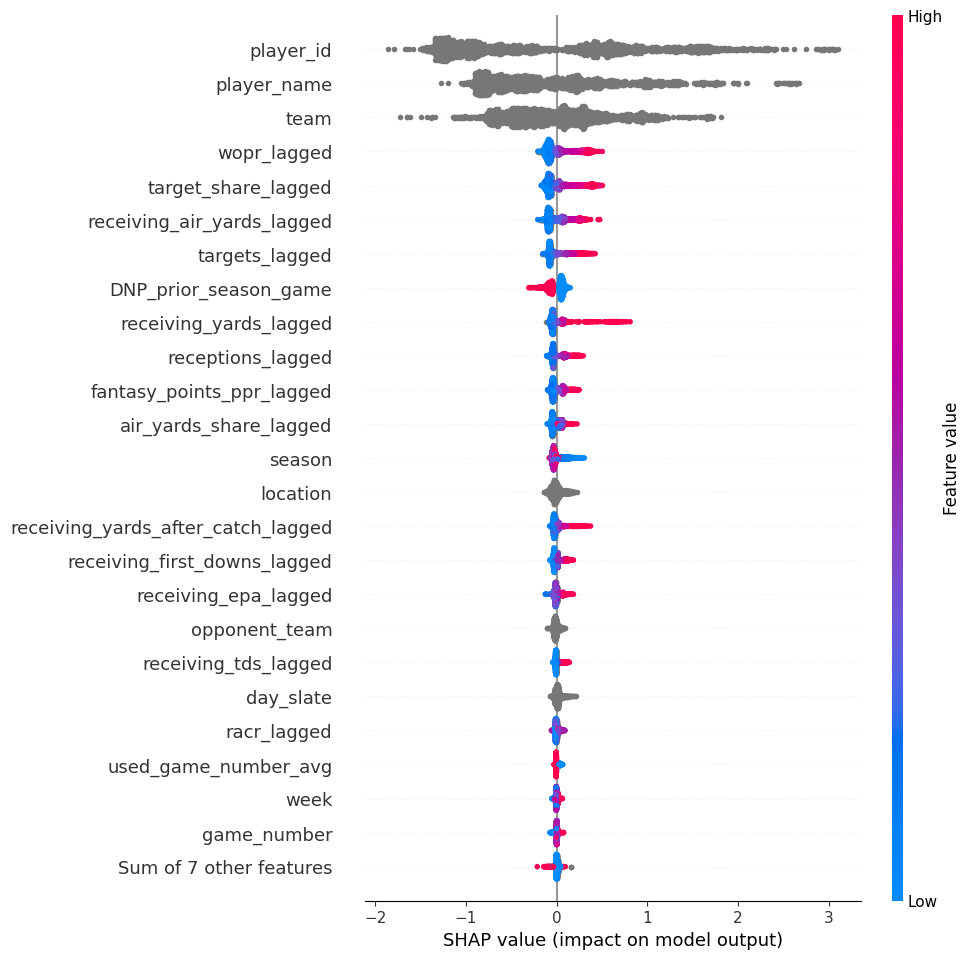

In [72]:
shap.plots.beeswarm(shap_values_te, max_display = 25)

## All players attempt

In [73]:
all_catboost_df = lagged_stats.copy()
all_catboost_df['season'] = all_catboost_df['season'].astype(str)
all_catboost_df['week'] = all_catboost_df['week'].astype(str)
all_catboost_df['game_number'] = all_catboost_df['game_number'].astype(str)

# Training split
all_train = all_catboost_df.sample(n=round(len(all_catboost_df)*.7), random_state=99)
all_train_X = all_train.loc[:, all_train.columns!='fantasy_points_ppr']
all_train_y = all_train['fantasy_points_ppr']
all_train_indices = all_train.index

all_nontrain = all_catboost_df.drop(all_train.index)

# test split
all_test = all_nontrain.sample(n=round(len(all_nontrain)*.5), random_state=99)
all_test_X = all_test.loc[:, all_test.columns!='fantasy_points_ppr']
all_test_y = all_test['fantasy_points_ppr']
all_test_X_indices = all_test_X.index

# Validation split
all_val = all_nontrain.drop(all_test.index)
all_val_X = all_val.loc[:, all_val.columns!='fantasy_points_ppr']
all_val_y = all_val['fantasy_points_ppr']
all_val

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
18,00-0017915,Ricky Williams,1.0,RB,MIA,2010,1,BUF,6.200000,Sunday_Morning,BUF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
33,00-0020516,Todd Heap,1.0,TE,BAL,2010,1,NYJ,13.200000,Monday_Afternoon,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
36,00-0020679,Shaun Hill,1.0,QB,DET,2010,1,CHI,-0.880000,Sunday_Morning,CHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
46,00-0021231,David Garrard,1.0,QB,JAX,2010,1,DEN,19.799999,Sunday_Morning,JAX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
51,00-0021429,Carson Palmer,1.0,QB,CIN,2010,1,NE,20.700001,Sunday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71946,00-0039379,Jamari Thrash,16.0,WR,CLE,2024,17,MIA,0.000000,Sunday_Afternoon,CLE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71948,00-0039391,Kimani Vidal,16.0,RB,LAC,2024,17,NE,2.400000,Saturday_Morning,NE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71954,00-0039732,Bo Nix,16.0,QB,DEN,2024,17,CIN,21.860001,Saturday_Afternoon,CIN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1
71962,00-0039849,Marvin Harrison,16.0,WR,ARI,2024,17,LA,15.600000,Saturday_Night,LA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1


### Cross Validation

In [74]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

all_cv_results = []

all_cvpool = Pool(data=all_train_X, label=all_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        all_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        all_cvscores = cv(pool=all_cvpool, params = all_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=30)
        best_all_cvscore = all_cvscores['test-MAE-mean'].min()
        all_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_all_cvscore})

all_cv_results_df = pd.DataFrame(all_cv_results)
best_params_all = all_cv_results_df.sort_values(by='mae').iloc[0]
best_params_all

100%|██████████| 18/18 [24:49<00:00, 82.78s/it] 


iterations       1000.000000
learning_rate       0.030000
depth               6.000000
mae                 4.796267
Name: 13, dtype: float64

In [75]:
# Training Model on Full Training Set
final_all_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_all['iterations']),
    'learning_rate': float(best_params_all['learning_rate']),
    'depth': int(best_params_all['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

all_catboost = CatBoostRegressor(**final_all_params)
all_catboost.fit(all_train_X, all_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(all_val_X, all_val_y))

In [76]:
all_val_preds = all_catboost.predict(all_val_X)
print(f'Validation MAE: {mean_absolute_error(all_val_y, all_val_preds)}')
print(f'Validation R2: {r2_score(all_val_y, all_val_preds)}')

Validation MAE: 4.760621630165713
Validation R2: 0.31058318805401275


In [77]:
all_test_preds = all_catboost.predict(all_test_X)
print(f'test MAE: {mean_absolute_error(all_test_y, all_test_preds)}')
print(f'test R2: {r2_score(all_test_y, all_test_preds)}')

# Predictions with indices
all_test_preds_wind = np.column_stack((all_test_X_indices, all_test_preds))
all_sorted_preds = all_test_preds_wind[all_test_preds_wind[:,0].argsort()]
all_sorted_preds_df = pd.DataFrame(all_sorted_preds, columns = ['index', 'prediction'])
all_sorted_preds_df.set_index('index', inplace=True)
all_sorted_preds_v_test = pd.concat([all_test_X, all_sorted_preds_df], axis = 1)
all_test_preds_exp = pd.concat([all_sorted_preds_v_test, all_test_y], axis=1)
all_test_preds_exp

test MAE: 4.810515250800812
test R2: 0.3193426864681951


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
38623.0,00-0029141,Alfred Morris,4.0,RB,SF,2018,4,LAC,Sunday_Afternoon,LAC,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,9.000,36.00,0.0,0.0,0.0,0.00,-0.586857,0.0,1.000,1.0,13.0,0.0,0.0,0.0,-4.000000,17.00,0.000,1.381309,0.0,-3.250000,0.040000,-0.019139,0.046603,0.0,5.90,1,0,0,0,3.168494,2.800000
7587.0,00-0025463,Jason Hill,10.0,WR,JAX,2011,11,CLE,Sunday_Morning,CLE,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.000,0.00,0.0,0.0,0.0,0.00,NaN,0.0,1.600,3.4,36.0,0.2,0.0,0.0,63.200001,3.60,1.400,1.337559,0.0,0.627408,0.100328,0.248784,0.324641,0.0,6.40,0,1,1,0,4.520901,7.900000
67430.0,00-0036212,Tua Tagovailoa,2.0,QB,MIA,2024,2,BUF,Thursday_Night,MIA,25.0,35.0,282.0,1.0,1.0,4.0,31.0,1.0,0.0,188.0,134.0,12.0,-3.484106,0.0,1.500000,0.063745,2.000,7.00,0.0,0.0,0.0,1.00,0.550477,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.000000,0.00,0.000,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.98,1,0,0,0,17.481883,5.500000
48234.0,00-0036145,Lawrence Cager,4.0,TE,NYJ,2020,4,DEN,Thursday_Night,NYJ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,1.870466,0.000000
67410.0,00-0035341,Trenton Irwin,2.0,WR,CIN,2024,2,KC,Sunday_Afternoon,KC,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.000,0.00,0.0,0.0,0.0,0.00,NaN,0.0,1.000,2.0,4.0,0.0,0.0,0.0,25.000000,0.00,0.000,-1.106347,0.0,0.160000,0.064516,0.104167,0.169691,0.0,1.40,1,0,0,0,2.827927,1.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49723.0,00-0030578,Cordarrelle Patterson,10.0,RB,CHI,2020,10,MIN,Monday_Night,CHI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,2.000,4.00,0.0,0.0,0.0,1.00,-0.910965,0.0,1.000,1.0,3.0,0.0,0.0,0.0,-2.000000,5.00,0.000,-0.350358,0.0,-1.500000,0.030303,-0.009756,0.038625,0.0,1.70,1,0,0,0,3.834467,12.900000
55639.0,00-0035864,Kendall Hinton,12.0,WR,DEN,2021,13,KC,Sunday_Night,KC,1.0,9.0,13.0,0.0,2.0,1.0,1.0,0.0,0.0,134.0,16.0,1.0,-11.930539,0.0,0.097015,-0.128963,2.000,7.00,0.0,0.0,0.0,0.00,-1.408619,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.000000,0.00,0.000,NaN,0.0,NaN,NaN,NaN,NaN,0.0,-2.78,0,1,1,0,1.887540,1.700000
23510.0,00-0026286,Jerome Felton,1.0,FB,BUF,2015,1,IND,Sunday_Morning,BUF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.750,6.00,0.0,0.0,0.0,0.25,0.073349,0.0,0.000,0.5,0.0,0.0,0.0,0.0,-0.500000,0.00,0.000,-0.429878,0.0,0.000000,0.025016,-0.004401,0.034443,0.0,0.60,0,1,1,0,0.844864,0.000000
29828.0,00-0030496,Le'Veon Bell,6.0,RB,PIT,2016,6,MIA,Sunday_Morning,MIA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,24.000,88.00,0.0,0.0,0.0,5.00,-5.887273,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.00000

### Exploring causes for errors

In [78]:
explainer_all = shap.TreeExplainer(all_catboost, feature_perturbation='tree_path_dependent')
shap_values_all = explainer_all(all_test_X)
shap_values_all

.values =
array([[ 1.13992813e-01, -2.09576267e+00, -7.85204658e-03, ...,
        -1.57291643e-02,  4.13812665e-02, -3.35678138e-04],
       [-7.15732720e-01, -1.26657054e+00, -1.91032380e-02, ...,
         1.41020834e-03,  1.32839234e-02, -3.35678138e-04],
       [ 1.25002261e+00,  3.66298376e+00, -1.03755686e-01, ...,
        -2.02982350e-02,  6.79289673e-02, -3.35678138e-04],
       ...,
       [-3.68746538e-01, -2.12202149e+00, -5.15444101e-02, ...,
        -6.25791788e-03, -4.46963980e-02, -1.03321552e-03],
       [ 8.34025070e-01,  3.62403903e+00,  3.21448225e-02, ...,
         4.28819542e-03,  6.02918386e-02,  2.76964966e-04],
       [-3.43979700e-01, -1.91570773e+00, -3.90298041e-03, ...,
        -5.73140218e-03, -6.69356767e-02, -3.35678138e-04]])

.base_values =
array([7.36996025, 7.36996025, 7.36996025, ..., 7.36996025, 7.36996025,
       7.36996025])

.data =
array([['00-0029141', 'Alfred Morris', '4.0', ..., 0, 0, 0],
       ['00-0025463', 'Jason Hill', '10.0', ..., 1, 1, 

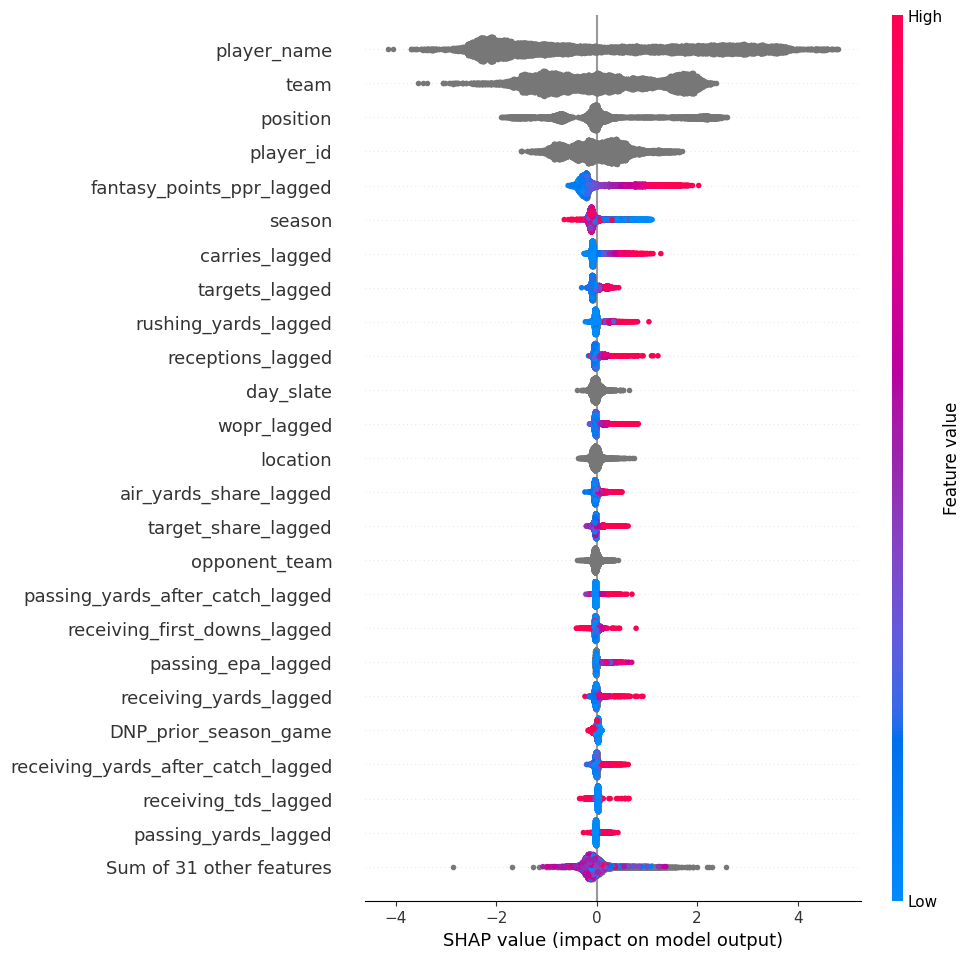

In [79]:
shap.plots.beeswarm(shap_values_all, max_display = 25)

## Players with >=11 fantasy points in a season, seen before only

In [80]:
by_season = lagged_stats.groupby(['player_name', 'season']).agg(
    {'fantasy_points_ppr':'sum',
     'never_seen':'mean',
     'DNP_prior_season_game':'mean'}
).reset_index()
by_season.describe()
## 25th percentile of target variable = ~11 points, so do QBs with 40+ points in a fantasy season only

,fantasy_points_ppr,never_seen,DNP_prior_season_game
count,8235.000000,8235.000000,8235.000000
mean,76.319427,0.316958,0.502008
std,82.078316,0.465257,0.431771
min,-7.280000,0.000000,0.000000
25%,10.700000,0.000000,0.000000
50%,44.799999,0.000000,0.428571
75%,120.400002,1.000000,1.000000
max,448.399994,1.000000,1.000000


In [81]:
all_filter_df = by_season[(by_season['fantasy_points_ppr'] >= 11) & (by_season['never_seen'] != 1) & (by_season['DNP_prior_season_game'] != 1)]
all_filtered = lagged_stats.merge(all_filter_df[['player_name', 'season']], how='inner', on=['player_name', 'season'])
all_filtered

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0003292,Kerry Collins,1.0,QB,IND,2011,1,HOU,7.88,Sunday_Morning,HOU,14.0,24.0,237.0,2.0,1.0,3.0,25.0,0.0,0.0,330.0,38.0,12.0,11.256248,0.0,0.718182,0.240972,2.0,-2.0,0.0,0.0,0.0,0.0,-1.636152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,15.280000,1,0,0,0
1,00-0003292,Kerry Collins,2.0,QB,IND,2011,2,CLE,7.54,Sunday_Morning,IND,17.0,25.0,149.0,1.0,1.0,2.0,5.0,2.0,1.0,220.0,25.0,9.0,0.543270,1.0,0.677273,0.131788,2.0,-1.0,0.0,0.0,0.0,0.0,-2.320931,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,7.860000,0,1,0,0
2,00-0003292,Kerry Collins,3.0,QB,IND,2011,3,PIT,3.72,Sunday_Night,IND,17.0,25.0,149.0,1.0,1.0,2.0,5.0,2.0,1.0,220.0,25.0,9.0,0.543270,1.0,0.677273,0.131788,2.0,-1.0,0.0,0.0,0.0,0.0,-2.320931,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,7.860000,1,0,0,0
3,00-0004541,Donald Driver,1.0,WR,GB,2011,1,NO,8.10,Thursday_Night,GB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,5.0,7.0,30.0,1.0,0.0,0.0,54.0,2.0,4.0,1.204149,0.0,0.555556,0.233333,0.168224,0.467757,0.0,14.000000,0,1,0,0
4,00-0004541,Donald Driver,2.0,WR,GB,2011,2,CAR,2.00,Sunday_Morning,CAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,4.0,5.0,38.0,1.0,0.0,0.0,41.0,12.0,3.0,3.403702,0.0,0.926829,0.172414,0.146429,0.361121,0.0,13.800000,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50498,00-0033110,Tyler Higbee,16.0,TE,LA,2024,17,ARI,2.90,Saturday_Night,LA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,3.5,4.0,23.5,1.0,0.0,0.0,17.5,8.5,1.0,1.184914,0.0,1.379934,0.152074,0.095039,0.294638,0.0,11.849999,1,0,0,0
50499,00-0035662,Marquise Brown,15.0,WR,KC,2024,16,HOU,9.50,Saturday_Morning,KC,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,1.0,-6.0,0.0,0.0,0.0,0.0,-1.322328,0.0,2.0,5.0,18.0,0.0,0.0,0.0,78.0,2.0,1.0,-3.218636,0.0,0.230769,0.172414,0.348214,0.502371,0.0,3.200000,1,0,0,0
50500,00-0035662,Marquise Brown,16.0,WR,KC,2024,17,PIT,8.60,Wednesday_Morning,PIT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,3.0,0.0,0.0,0.0,0.0,14.0,0.0,0.0,-2.788815,0.0,0.000000,0.130435,0.080925,0.252300,0.0,0.000000,1,0,0,0
50501,00-0036924,Michael Carter,15.0,RB,ARI,2024,16,CAR,9.80,Sunday_Morning,CAR,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,-0.758748,0.0,0.000000,0.027027,0.013575,0.050043,0.0,0.000000,0,1,0,0


In [82]:
# Training split
allf_train = all_filtered.sample(n=round(len(all_filtered)*.7), random_state=5)
allf_train_X = allf_train.loc[:, allf_train.columns!='fantasy_points_ppr']
allf_train_y = allf_train['fantasy_points_ppr']
allf_train_indices = allf_train.index

allf_nontrain = all_filtered.drop(allf_train.index)

# Test split
allf_test = allf_nontrain.sample(n=round(len(allf_nontrain)*.5), random_state=5)
allf_test_X = allf_test.loc[:, allf_test.columns!='fantasy_points_ppr']
allf_test_y = allf_test['fantasy_points_ppr']
allf_test_X_indices = allf_test_X.index

# Validation split
allf_val = allf_nontrain.drop(allf_test.index)
allf_val_X = allf_val.loc[:, allf_val.columns!='fantasy_points_ppr']
allf_val_y = allf_val['fantasy_points_ppr']
allf_val


,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
10,00-0004541,Donald Driver,8.0,WR,GB,2011,9,LAC,3.800000,Sunday_Afternoon,LAC,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,3.0,0.0,0.0,0.0,0.0,18.0,0.0,0.0,-3.304491,0.0,0.000000,0.088235,0.050562,0.167746,0.0,0.000000,0,1,0,0
11,00-0004541,Donald Driver,9.0,WR,GB,2011,10,MIN,6.600000,Monday_Night,GB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,2.0,4.0,15.5,0.0,0.0,0.0,22.0,12.5,1.0,-0.410726,0.0,0.442857,0.123661,0.081594,0.242607,0.0,3.550000,1,0,0,0
15,00-0004541,Donald Driver,13.0,WR,GB,2011,14,LV,11.500000,Sunday_Afternoon,GB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,2.0,8.0,12.0,0.0,0.0,0.0,118.0,0.0,0.0,-9.228486,0.0,0.101695,0.216216,0.333333,0.557658,0.0,3.200000,0,1,0,0
26,00-0006101,Tony Gonzalez,9.0,TE,ATL,2011,10,NO,19.100000,Sunday_Morning,ATL,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,5.0,6.0,61.0,0.5,0.0,0.0,51.0,22.0,3.5,8.097827,0.0,0.957529,0.212438,0.214133,0.468550,0.0,14.100000,1,0,0,0
37,00-0007091,Matt Hasselbeck,5.0,QB,TEN,2011,5,PIT,12.780000,Sunday_Morning,PIT,25.0,40.0,242.0,1.0,0.0,0.0,0.0,0.0,0.0,270.0,69.0,14.0,2.947018,0.0,0.896296,0.070844,3.0,-3.0,0.0,0.0,0.0,0.0,-1.259380,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.380000,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50485,00-0038611,Chris Rodriguez,15.0,RB,WAS,2024,16,PHI,0.500000,Sunday_Morning,WAS,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,10.0,58.0,2.0,0.0,0.0,4.0,4.043178,0.0,1.0,1.0,7.0,0.0,0.0,0.0,-2.0,9.0,0.0,0.067896,0.0,-3.500000,0.031250,-0.013605,0.037351,0.0,19.500000,0,1,0,0
50487,00-0033280,Christian McCaffrey,9.0,RB,SF,2024,10,TB,16.700001,Sunday_Morning,TB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,21.0,78.0,0.0,0.0,0.0,4.0,-5.436401,0.0,5.0,5.0,25.0,1.0,0.0,0.0,8.0,17.0,2.0,2.288877,0.0,3.125000,0.200000,0.039801,0.327861,0.0,21.299999,1,0,0,0
50490,00-0033280,Christian McCaffrey,12.0,RB,SF,2024,13,BUF,8.700000,Sunday_Night,BUF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,17.0,93.0,1.0,0.0,0.0,7.0,5.639732,0.0,3.0,4.0,40.0,0.0,0.0,0.0,33.0,19.0,1.0,1.379360,0.0,1.212121,0.160000,0.239130,0.407391,0.0,22.299999,0,1,0,0
50493,00-0036862,Ben Skowronek,14.0,WR,PIT,2024,15,PHI,2.700000,Sunday_Afternoon,PHI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,14.0,0.0,0.0,-0.519312,0.0,0.000000,0.029412,0.041667,0.073284,0.0,0.000000,1,0,0,0


### Cross Validation

In [83]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

allf_cv_results = []

allf_cvpool = Pool(data=allf_train_X, label=allf_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        all_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        allf_cvscores = cv(pool=allf_cvpool, params = all_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=5)
        best_allf_cvscore = allf_cvscores['test-MAE-mean'].min()
        allf_cv_results.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_allf_cvscore})

allf_cv_results_df = pd.DataFrame(allf_cv_results)
best_params_allf = allf_cv_results_df.sort_values(by='mae').iloc[0]
best_params_allf

100%|██████████| 18/18 [21:05<00:00, 70.28s/it] 


iterations       1000.00000
learning_rate       0.03000
depth               6.00000
mae                 5.07422
Name: 13, dtype: float64

In [84]:
# Training Model on Full Training Set
final_allf_params = {
    'loss_function':'MAE',
    'iterations': int(best_params_allf['iterations']),
    'learning_rate': float(best_params_allf['learning_rate']),
    'depth': int(best_params_allf['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

allf_catboost = CatBoostRegressor(**final_allf_params)
allf_catboost.fit(allf_train_X, allf_train_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location'], 
                eval_set=(allf_val_X, allf_val_y))

In [85]:
allf_val_preds = allf_catboost.predict(allf_val_X)
print(f'Validation MAE: {mean_absolute_error(allf_val_y, allf_val_preds)}')
print(f'Validation R2: {r2_score(allf_val_y, allf_val_preds)}')

Validation MAE: 5.131577748906053
Validation R2: 0.27700435434086523


In [86]:
allf_test_preds = allf_catboost.predict(allf_test_X)
print(f'Test MAE: {mean_absolute_error(allf_test_y, allf_test_preds)}')
print(f'Test R2: {r2_score(allf_test_y, allf_test_preds)}')

# Predictions with indices
allf_test_preds_wind = np.column_stack((allf_test_X_indices, allf_test_preds))
allf_sorted_preds = allf_test_preds_wind[allf_test_preds_wind[:,0].argsort()]
allf_sorted_preds_df = pd.DataFrame(allf_sorted_preds, columns = ['index', 'prediction'])
allf_sorted_preds_df.set_index('index', inplace=True)
allf_sorted_preds_v_test = pd.concat([allf_test_X, allf_sorted_preds_df], axis = 1)
allf_test_preds_exp = pd.concat([allf_sorted_preds_v_test, allf_test_y], axis=1)
allf_test_preds_exp

Test MAE: 5.1044939256398
Test R2: 0.2773448827651671


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction,fantasy_points_ppr
3433.0,00-0025708,Matt Moore,5.0,QB,MIA,2011,6,NYJ,Monday_Night,NYJ,5.0,10.0,35.0,0.0,2.0,0.0,0.0,0.0,0.0,83.0,11.0,2.0,-4.838793,0.0,0.421687,0.000462,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,-2.600000,0,1,0,0,12.227106,4.160000
19787.0,00-0031062,James White,15.0,RB,NE,2016,16,NYJ,Saturday_Morning,NE,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,2.0,4.0,0.0,0.0,0.0,0.5,-0.312680,0.0,4.0,5.0,27.0,0.5,0.0,0.0,11.0,24.0,2.0,2.064640,0.0,2.866667,0.126941,0.035052,0.214949,0.0,10.100000,1,0,0,0,10.510996,13.600000
49169.0,00-0038041,Jake Ferguson,7.0,TE,DAL,2024,8,SF,Sunday_Night,SF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,3.0,3.0,28.0,0.0,0.0,0.0,5.0,23.0,1.0,1.450288,0.0,5.600000,0.115385,0.016393,0.184552,0.0,5.800000,1,0,0,0,6.551242,8.300000
7513.0,00-0023437,Ronnie Brown,4.0,RB,LAC,2013,4,DAL,Sunday_Afternoon,LAC,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,3.0,3.0,50.0,0.0,0.0,0.0,16.0,34.0,2.0,3.993453,0.0,3.125000,0.130435,0.099379,0.265217,0.0,8.000000,0,1,0,0,3.775029,0.700000
30236.0,00-0033839,Dede Westbrook,2.0,WR,JAX,2019,2,HOU,Sunday_Morning,HOU,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,4.0,4.0,17.0,0.0,0.0,0.0,13.0,4.0,2.0,1.473923,0.0,1.307692,0.100000,0.056769,0.189738,0.0,5.700000,1,0,0,0,10.498238,1.300000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10543.0,00-0020337,Steve Smith,9.0,WR,BAL,2014,9,PIT,Sunday_Night,PIT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,6.0,11.0,63.0,0.0,0.0,0.0,126.0,11.0,4.0,-1.600571,0.0,0.500000,0.343750,0.386503,0.786177,0.0,12.300000,0,1,0,0,13.510208,8.600000
37382.0,00-0034855,Baker Mayfield,2.0,QB,CLE,2021,2,HOU,Sunday_Morning,CLE,12.0,20.0,132.0,0.0,0.0,1.0,7.0,0.0,0.0,165.0,55.0,5.0,-3.269064,0.0,0.800000,0.018554,3.0,1.0,0.0,0.0,0.0,0.0,-6.779699,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,5.380000,1,0,0,0,16.614061,17.520000
29853.0,00-0032950,Carson Wentz,11.0,QB,PHI,2019,12,SEA,Sunday_Morning,PHI,20.0,28.0,236.0,1.0,0.0,3.0,22.0,0.0,0.0,159.0,125.0,11.0,8.937419,0.0,1.484277,0.134911,2.0,-2.0,0.0,0.0,0.0,0.0,-1.712713,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.240000,0,1,0,0,17.242601,8.940000
27450.0,00-0033906,Alvin Kamara,1.0,RB,NO,2018,1,TB,Sunday_Morning,NO,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,10.0,68.0,1.0,1.0,1.0,4.0,-0.752347,0.0,6.0,7.0,84.0,1.0,0.0,0.0,11.0,80.0,4.0,4.271715,0.0,7.636364,0.259259,0.053922,0.426634,0.0,31.200001,1,0,

# Neural Network Modeling

Idea: create a multi-layer perceptron (MLP) model with tensorflow.
- Just to teach myself and explore a deep learning methodology
- CatBoost models aren't performing very well either

## Pre-processing dataset

In [87]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder

deep_lagged_stats = lagged_stats.copy()
deep_lagged_stats.drop(columns=['player_name'], inplace=True)

# Getting position dummies
deep_lagged_stats = pd.get_dummies(deep_lagged_stats, columns=['position'], prefix = 'cat')
deep_lagged_stats[['cat_QB', 'cat_WR', 'cat_RB', 'cat_FB', 'cat_TE']] = deep_lagged_stats[['cat_QB', 'cat_WR', 'cat_RB', 'cat_FB', 'cat_TE']].astype(int)

# Label Encoding
game_number_encoder = LabelEncoder()
team_encoder = LabelEncoder()
week_encoder = LabelEncoder()
opponent_team_encoder = LabelEncoder()

# Ordinal Encoding - variables that will have previously unseen values (season, player_id, and location)
ordinal_encoder = OrdinalEncoder(
    handle_unknown = 'use_encoded_value',
    unknown_value=-1
)

deep_lagged_stats['game_number_encoded'] = game_number_encoder.fit_transform(deep_lagged_stats['game_number'])
deep_lagged_stats['team_encoded'] = team_encoder.fit_transform(deep_lagged_stats['team'])
deep_lagged_stats['week_encoded'] = week_encoder.fit_transform(deep_lagged_stats['week'])
deep_lagged_stats['opponent_team_encoded'] = opponent_team_encoder.fit_transform(deep_lagged_stats['opponent_team'])
deep_lagged_stats[['player_id_encoded', 'season_encoded', 'location_encoded', 'day_slate_encoded']] = ordinal_encoder.fit_transform(deep_lagged_stats[['player_id', 'season', 'location', 'day_slate']])
deep_lagged_stats[['player_id_encoded', 'season_encoded', 'location_encoded', 'day_slate_encoded']] += 1

# Get number of unique values for each categorical variable
num_player_id = deep_lagged_stats['player_id_encoded'].nunique()
print(f'Number of unique player_id: {num_player_id}')
num_game_number = deep_lagged_stats['game_number_encoded'].nunique()
print(f'Number of unique game_number: {num_game_number}')
num_team = deep_lagged_stats['team_encoded'].nunique()
print(f'Number of unique team: {num_team}')
num_season = deep_lagged_stats['season_encoded'].nunique()
print(f'Number of unique season: {num_season}')
num_week = deep_lagged_stats['week_encoded'].nunique()
print(f'Number of unique week: {num_week}')
num_opponent_team = deep_lagged_stats['opponent_team_encoded'].nunique()
print(f'Number of unique opponent_team: {num_opponent_team}')
num_day_slate = deep_lagged_stats['day_slate_encoded'].nunique()
print(f'Number of unique day_slate: {num_day_slate}')
num_location = deep_lagged_stats['location_encoded'].nunique()
print(f'Number of unique location: {num_location}')

# Prepare features and target
X_deep = deep_lagged_stats.drop(columns=['fantasy_points_ppr'])
y_deep = deep_lagged_stats['fantasy_points_ppr']
X_deep_training, X_deep_test, y_deep_training, y_deep_test = train_test_split(X_deep, y_deep, test_size = 0.2, random_state = 9)
X_deep_training.fillna(0, inplace=True)
y_deep_training.fillna(0, inplace=True)
X_deep_test.fillna(0, inplace=True)
y_deep_test.fillna(0, inplace=True)

Number of unique player_id: 2247
Number of unique game_number: 16
Number of unique team: 32
Number of unique season: 15
Number of unique week: 17
Number of unique opponent_team: 32
Number of unique day_slate: 22
Number of unique location: 33


In [98]:
pip install tensorflow


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


## Creating Model

Heuristics for output_dim of embedding layers:
- Rule of thumb: min(50, round(n^0.25))
- n <= 100: 4-8
- 500 <= n <= 5000: 8-32
- n > 5000: 32 - 128+

In [88]:
from tensorflow.keras import Input, Model
from tensorflow.keras.layers import Embedding, Flatten, Concatenate, Dense
import tensorflow.keras.layers as layers  # use this consistently
from tensorflow.keras.regularizers import l1_l2

# Define output_dim values
print(f'Rule of Thumb player_id: {min(50, round(num_player_id)**0.25)}')
embedding_dim_player_id = 16
embedding_dim_game_number = 4
embedding_dim_team = 4
embedding_dim_season = 4
embedding_dim_week = 4
embedding_dim_opponent_team = 4
embedding_dim_day_slate = 4
embedding_dim_location = 4

# Input layers
player_id_input = Input(shape=(1,), name='player_id_input')
game_number_input = Input(shape=(1,), name='game_number_input')
team_input = Input(shape=(1,), name='team_input')
season_input = Input(shape=(1,), name='season_input')
week_input = Input(shape=(1,), name='week_input')
opponent_team_input = Input(shape=(1,), name='opponent_team_input')
day_slate_input = Input(shape=(1,), name='day_slate_input')
location_input = Input(shape=(1,), name='location_input')
numeric_inputs = Input(shape=(50,), name='numeric_input') # shape is all numeric columns besides encoded columns

# Embedding layers applied to inputs
player_id_emb = Flatten()(Embedding(input_dim=num_player_id + 2, output_dim=embedding_dim_player_id)(player_id_input))
game_number_emb = Flatten()(Embedding(input_dim=num_game_number + 1, output_dim=embedding_dim_game_number)(game_number_input))
team_emb = Flatten()(Embedding(input_dim=num_team + 1, output_dim=embedding_dim_team)(team_input))
season_emb = Flatten()(Embedding(input_dim=num_season + 2, output_dim=embedding_dim_season)(season_input))
week_emb = Flatten()(Embedding(input_dim=num_week + 1, output_dim=embedding_dim_week)(week_input))
opponent_team_emb = Flatten()(Embedding(input_dim=num_opponent_team + 1, output_dim=embedding_dim_opponent_team)(opponent_team_input))
day_slate_emb = Flatten()(Embedding(input_dim=num_day_slate + 2, output_dim=embedding_dim_day_slate)(day_slate_input))
location_emb = Flatten()(Embedding(input_dim=num_location + 2, output_dim=embedding_dim_location)(location_input))

# Concatenate all features
concatenated = Concatenate()([
    player_id_emb,
    game_number_emb,
    team_emb,
    season_emb,
    week_emb,
    opponent_team_emb,
    day_slate_emb,
    location_emb,
    numeric_inputs
])

# Dense layers
## Originally had 3 layers, but that caused overfitting
x = Dense(128, activation='relu', kernel_regularizer = l1_l2(l1=0.000001, l2=0.001))(concatenated) # Added in elastic net regularization with more powerful L2 than L1 to preserve features more
x = Dense(64, activation='relu', kernel_regularizer = l1_l2(l1=0.000001, l2=0.001))(x)
output = Dense(1)(x)

# Build model
deep_model = Model(inputs=[
    player_id_input, game_number_input, team_input, season_input,
    week_input, opponent_team_input, day_slate_input, location_input,
    numeric_inputs
], outputs=output)

deep_model.compile(optimizer='adam', loss='mean_absolute_error', metrics=['mae']) # adam optimizer is most robust for regression tasks

# Prepare the input data
player_id_input_train = X_deep_training['player_id_encoded'].values
game_number_input_train = X_deep_training['game_number_encoded'].values
team_input_train = X_deep_training['team_encoded'].values
season_input_train = X_deep_training['season_encoded'].values
week_input_train = X_deep_training['week_encoded'].values
opponent_team_input_train = X_deep_training['opponent_team_encoded'].values
day_slate_input_train = X_deep_training['day_slate_encoded'].values
location_input_train = X_deep_training['location_encoded'].values
numeric_features_train = X_deep_training[['completions_lagged', 'attempts_lagged', 'passing_yards_lagged',
       'passing_tds_lagged', 'interceptions_lagged', 'sacks_lagged',
       'sack_yards_lagged', 'sack_fumbles_lagged', 'sack_fumbles_lost_lagged',
       'passing_air_yards_lagged', 'passing_yards_after_catch_lagged',
       'passing_first_downs_lagged', 'passing_epa_lagged',
       'passing_2pt_conversions_lagged', 'pacr_lagged', 'dakota_lagged',
       'carries_lagged', 'rushing_yards_lagged', 'rushing_tds_lagged',
       'rushing_fumbles_lagged', 'rushing_fumbles_lost_lagged',
       'rushing_first_downs_lagged', 'rushing_epa_lagged',
       'rushing_2pt_conversions_lagged', 'receptions_lagged', 'targets_lagged',
       'receiving_yards_lagged', 'receiving_tds_lagged',
       'receiving_fumbles_lagged', 'receiving_fumbles_lost_lagged',
       'receiving_air_yards_lagged', 'receiving_yards_after_catch_lagged',
       'receiving_first_downs_lagged', 'receiving_epa_lagged',
       'receiving_2pt_conversions_lagged', 'racr_lagged',
       'target_share_lagged', 'air_yards_share_lagged', 'wopr_lagged',
       'special_teams_tds_lagged', 'fantasy_points_ppr_lagged',
       'used_opponent_avg', 'used_game_number_avg', 'DNP_prior_season_game',
       'never_seen', 'cat_FB', 'cat_QB', 'cat_RB', 'cat_TE', 'cat_WR']].values

# Train the model
deep_model.fit([
    player_id_input_train, game_number_input_train, team_input_train, season_input_train, week_input_train, opponent_team_input_train, day_slate_input_train, location_input_train,
    numeric_features_train],
    y_deep_training,
    epochs = 50,
    batch_size=32,
    validation_split=0.2,
    verbose=False
    )

# Evaluate on training set
train_loss, train_mae = deep_model.evaluate([
    player_id_input_train, game_number_input_train, team_input_train, season_input_train,
    week_input_train, opponent_team_input_train, day_slate_input_train, location_input_train,
    numeric_features_train
], y_deep_training, verbose=0)
print(f"Train MAE: {train_mae:.4f}")

# Evaluate the model
player_id_input_test = X_deep_test['player_id_encoded'].values
game_number_input_test = X_deep_test['game_number_encoded'].values
team_input_test = X_deep_test['team_encoded'].values
season_input_test = X_deep_test['season_encoded'].values
week_input_test = X_deep_test['week_encoded'].values
opponent_team_input_test = X_deep_test['opponent_team_encoded'].values
day_slate_input_test = X_deep_test['day_slate_encoded'].values
location_input_test = X_deep_test['location_encoded'].values
numeric_features_test = X_deep_test[['completions_lagged', 'attempts_lagged', 'passing_yards_lagged',
       'passing_tds_lagged', 'interceptions_lagged', 'sacks_lagged',
       'sack_yards_lagged', 'sack_fumbles_lagged', 'sack_fumbles_lost_lagged',
       'passing_air_yards_lagged', 'passing_yards_after_catch_lagged',
       'passing_first_downs_lagged', 'passing_epa_lagged',
       'passing_2pt_conversions_lagged', 'pacr_lagged', 'dakota_lagged',
       'carries_lagged', 'rushing_yards_lagged', 'rushing_tds_lagged',
       'rushing_fumbles_lagged', 'rushing_fumbles_lost_lagged',
       'rushing_first_downs_lagged', 'rushing_epa_lagged',
       'rushing_2pt_conversions_lagged', 'receptions_lagged', 'targets_lagged',
       'receiving_yards_lagged', 'receiving_tds_lagged',
       'receiving_fumbles_lagged', 'receiving_fumbles_lost_lagged',
       'receiving_air_yards_lagged', 'receiving_yards_after_catch_lagged',
       'receiving_first_downs_lagged', 'receiving_epa_lagged',
       'receiving_2pt_conversions_lagged', 'racr_lagged',
       'target_share_lagged', 'air_yards_share_lagged', 'wopr_lagged',
       'special_teams_tds_lagged', 'fantasy_points_ppr_lagged',
       'used_opponent_avg', 'used_game_number_avg', 'DNP_prior_season_game',
       'never_seen', 'cat_FB', 'cat_QB', 'cat_RB', 'cat_TE', 'cat_WR']].values

test_loss, test_mae = deep_model.evaluate([
    player_id_input_test, game_number_input_test, team_input_test, season_input_test, week_input_test, opponent_team_input_test, day_slate_input_test, location_input_test,
    numeric_features_test], y_deep_test)
print(f"Test MAE: {test_mae:.4f}")

# Make predictions
predictions = deep_model.predict([
    player_id_input_test, game_number_input_test, team_input_test, season_input_test, week_input_test, opponent_team_input_test, day_slate_input_test, location_input_test,
    numeric_features_test])
predictions

2025-06-24 11:55:41.069680: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


Rule of Thumb player_id: 6.8849496423696035
Train MAE: 4.5069
450/450 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 5.0012 - mae: 4.9574
Test MAE: 4.8846
450/450 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


array([[ 8.431002 ],
       [ 3.9771852],
       [ 5.788801 ],
       ...,
       [ 1.8462148],
       [ 7.87333  ],
       [16.727718 ]], dtype=float32)

# Generating 2025 Predictions

Methodology:
- Take all players from 2024 season training, their teams, and their stats from prior season on a weekly basis
- Clean 2025 schedule to match format of training data
- Merge 2025 schedule to them and lagged stats from prior year accordingly
- Feed through models

Goals:
- See top 10 by position
    - See how much they changed from previous year
    - See how much top 10 from previous year changed

## 2025 DF creation

### Roster data

In [89]:
roster25 = nfl.import_seasonal_rosters([2025])[['player_id', 'player_name', 'season', 'team', 'depth_chart_position', 'entry_year', 'rookie_year']]
roster25 = roster25[(roster25['depth_chart_position'].isin(['QB', 'TE', 'RB', 'FB', 'WR'])) & (roster25['entry_year'] != 2025) & (roster25['rookie_year'] != 2025)]
roster25['season'] = roster25['season'].astype(str)
roster25.rename(columns={'depth_chart_position':'position'}, inplace=True)
roster25

,player_id,player_name,season,team,position,entry_year,rookie_year
0,00-0023459,Aaron Rodgers,2025,PIT,QB,2005,2005
2,00-0024243,Marcedes Lewis,2025,CHI,TE,2006,2006
5,00-0026158,Joe Flacco,2025,CLE,QB,2008,2008
7,00-0026300,Josh Johnson,2025,WAS,QB,2008,2008
8,00-0026498,Matthew Stafford,2025,LA,QB,2009,2009
...,...,...,...,...,...,...,...
2487,00-0039919,Rome Odunze,2025,CHI,WR,2024,2024
2488,00-0039920,Malachi Corley,2025,NYJ,WR,2024,2024
2489,00-0039921,Trey Benson,2025,ARI,RB,2024,2024
2490,00-0039923,J.J. McCarthy,2025,MIN,QB,2024,2024


### Schedule data + cleaning

In [90]:
schedule25 = pd.read_csv('NFL Schedule 2025 - Sheet1.csv')
schedule25 = schedule25.iloc[1:].reset_index(drop=True)

# Creating team_abbreviation mapping
team_abbrev = {
    'Philadelphia Eagles':'PHI', 'Los Angeles Chargers': 'LAC', 'Atlanta Falcons': 'ATL', 'Cleveland Browns': 'CLE', 'Indianapolis Colts': 'IND',
    'Jacksonville Jaguars': 'JAX', 'New England Patriots': 'NE', 'New Orleans Saints': 'NO', 'New York Jets': 'NYJ', 'Washington Commanders': 'WAS',
    'Denver Broncos': 'DEN', 'Seattle Seahawks': 'SEA', 'Green Bay Packers': 'GB', 'Los Angeles Rams': 'LA', 'Buffalo Bills': 'BUF', 'Chicago Bears': 'CHI',
    'Baltimore Ravens': 'BAL', 'Cincinnati Bengals': 'CIN', 'Dallas Cowboys': 'DAL', 'Detroit Lions': 'DET', 'Miami Dolphins': 'MIA', 'Pittsburgh Steelers': 'PIT',
    'Tennessee Titans': 'TEN', 'Arizona Cardinals': 'ARI', 'Kansas City Chiefs': 'KC', 'Minnesota Vikings': 'MIN', 'Houston Texans': 'HOU',
    'Las Vegas Raiders': 'LV', 'Carolina Panthers': 'CAR', 'Tampa Bay Buccaneers': 'TB', 'San Francisco 49ers': 'SF', 'New York Giants': 'NYG'
}

# Cleaning messy old file
schedule25['home_team'] = schedule25['Unnamed: 4'].map(team_abbrev)
schedule25['away_team'] = schedule25['Unnamed: 5'].map(team_abbrev)
schedule25['location'] = np.where(
    schedule25['Unnamed: 3'].isin(['Wembley Stadium', 'Santiago Bernabeu Stadium', 'Tottenham Hotspur Stadium',
                                  'Arena Corinthians', 'Croke Park', 'Olympic Stadium']), 'global', schedule25['home_team'])

# Adding season column
schedule25['season'] = str(2025)

# Adding day_slate column 
schedule25['time'] = pd.to_datetime(schedule25['Unnamed: 6'])
schedule25['weekday'] = schedule25['time'].dt.day_name()
schedule25['hour'] = schedule25['time'].dt.hour
schedule25['slate'] = np.where(
    schedule25['hour'].isin([12, 13, 14]),
    'Morning',
    np.where(
        schedule25['hour'].isin([15]),
        'Noon',
        np.where(
            schedule25['hour'].isin([16, 17, 18, 19]),
            'Afternoon',
            np.where(
                schedule25['hour'].isin([20, 21, 22, 23]),
                'Night',
                'global'
            )
        )
    )
)
schedule25['day_slate'] = schedule25['weekday'] + '_' + schedule25['slate']
schedule25['week'] = schedule25['Unnamed: 1'].astype(str)
schedule25

,NFL 2025 Fixture,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,home_team,away_team,location,season,time,weekday,hour,slate,day_slate,week
0,1,1,9/4/25 20:20,Lincoln Financial Field,Philadelphia Eagles,Dallas Cowboys,9/4/25 20:20,PHI,DAL,PHI,2025,2025-09-04 20:20:00,Thursday,20,Night,Thursday_Night,1
1,2,1,9/5/25 20:00,Arena Corinthians,Los Angeles Chargers,Kansas City Chiefs,9/5/25 20:00,LAC,KC,global,2025,2025-09-05 20:00:00,Friday,20,Night,Friday_Night,1
2,3,1,9/7/25 13:00,Mercedes-Benz Stadium,Atlanta Falcons,Tampa Bay Buccaneers,9/7/25 13:00,ATL,TB,ATL,2025,2025-09-07 13:00:00,Sunday,13,Morning,Sunday_Morning,1
3,4,1,9/7/25 13:00,Huntington Bank Field,Cleveland Browns,Cincinnati Bengals,9/7/25 13:00,CLE,CIN,CLE,2025,2025-09-07 13:00:00,Sunday,13,Morning,Sunday_Morning,1
4,5,1,9/7/25 13:00,Lucas Oil Stadium,Indianapolis Colts,Miami Dolphins,9/7/25 13:00,IND,MIA,IND,2025,2025-09-07 13:00:00,Sunday,13,Morning,Sunday_Morning,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,268,18,1/5/26 0:00,MetLife Stadium,New York Giants,Dallas Cowboys,1/4/2026 19:00:00,NYG,DAL,NYG,2025,2026-01-04 19:00:00,Sunday,19,Afternoon,Sunday_Afternoon,18
268,269,18,1/5/26 0:00,Lincoln Financial Field,Philadelphia Eagles,Washington Commanders,1/4/2026 19:00:00,PHI,WAS,PHI,2025,2026-01-04 19:00:00,Sunday,19,Afternoon,Sunday_Afternoon,18
269,270,18,1/5/26 0:00,Acrisure Stadium,Pittsburgh Steelers,Baltimore Ravens,1/4/2026 19:00:00,PIT,BAL,PIT,2025,2026-01-04 19:00:00,Sunday,19,Afternoon,Sunday_Afternoon,18
270,271,18,1/5/26 0:00,Levi's Stadium,San Francisco 49ers,Seattle Seahawks,1/4/2026 19:00:00,SF,SEA,SF,2025,2026-01-04 19:00:00,Sunday,19,Afternoon,Sunday_Afternoon,18


In [91]:
# Formatting schedule df to merge with roster df
## Creating home dataframe for home teams
home25 = schedule25.copy()
home25['team'] = home25['home_team']
home25['opponent_team'] = home25['away_team']
home25['is_home'] = True

## Creating away dataframe for away teams
away25 = schedule25.copy()
away25['team'] = away25['away_team']
away25['opponent_team'] = away25['home_team']
away25['is_away'] = True

## Joining home and away dataframes to be able to merge with roster df
schedule25_long = pd.concat([home25, away25], ignore_index=True)
schedule25_long[schedule25_long['opponent_team'].isna()]
roster_schedule25 = pd.merge(roster25.drop(columns=['entry_year', 'rookie_year']), schedule25_long[['team', 'season','week', 'opponent_team', 'day_slate', 'location']], 
                             on=['season', 'team'], how='inner')

# game_number column creation
gn_rs25 = roster_schedule25.copy()
gn_rs25['week'] = gn_rs25['week'].astype(int)
game_no = gn_rs25[['season', 'week', 'team', 'location']].groupby(['season', 'team', 'week']).agg({'location': 'first'})
game_no['game_number'] = game_no.groupby(['season', 'team']).cumcount() + 1
game_no.reset_index(inplace=True)
game_no['week'] = game_no['week'].astype(str)

roster_schedule25 = roster_schedule25.merge(game_no, how='left', on=['season', 'team', 'location', 'week'])
roster_schedule25

,player_id,player_name,season,team,position,week,opponent_team,day_slate,location,game_number
0,00-0023459,Aaron Rodgers,2025,PIT,QB,2,SEA,Sunday_Morning,PIT,2
1,00-0023459,Aaron Rodgers,2025,PIT,QB,4,MIN,Sunday_global,global,4
2,00-0023459,Aaron Rodgers,2025,PIT,QB,6,CLE,Sunday_Morning,PIT,5
3,00-0023459,Aaron Rodgers,2025,PIT,QB,8,GB,Sunday_Night,PIT,7
4,00-0023459,Aaron Rodgers,2025,PIT,QB,9,IND,Sunday_Morning,PIT,8
...,...,...,...,...,...,...,...,...,...,...
12864,00-0039811,MarShawn Lloyd,2025,GB,RB,11,NYG,Sunday_Morning,NYG,10
12865,00-0039811,MarShawn Lloyd,2025,GB,RB,13,DET,Thursday_Morning,DET,12
12866,00-0039811,MarShawn Lloyd,2025,GB,RB,15,DEN,Sunday_Afternoon,DEN,14
12867,00-0039811,MarShawn Lloyd,2025,GB,RB,16,CHI,Sunday_Afternoon,CHI,15


### Stats data

In [92]:
players25 = weekly_stats[weekly_stats['season'] == 2024]
players25.rename(columns={'player_display_name':'player_name'}, inplace=True)
players25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/3418235261.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,player_id,player_name,game_number,position,team,season,week,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,day_slate,location
66996,00-0023459,Aaron Rodgers,1.0,QB,NYJ,2024,1,SF,13,21,167.0,1,1.0,1.0,5.0,0,0,164.0,93.0,8.0,3.258283,0,1.018293,0.066574,1,-1.0,0,0.0,0.0,0.0,0.000000,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,8.580000,8.580000,Monday_Night,SF
66997,00-0026498,Matthew Stafford,1.0,QB,LA,2024,1,DET,34,49,317.0,1,1.0,2.0,13.0,0,0,290.0,171.0,15.0,4.536421,0,1.093103,0.106137,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,14.680000,14.680000,Sunday_Night,DET
66998,00-0027973,Andy Dalton,1.0,QB,CAR,2024,1,NO,0,1,0.0,0,0.0,0.0,-0.0,0,0,6.0,0.0,0.0,-0.621024,0,0.000000,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,Sunday_Morning,NO
66999,00-0028118,Tyrod Taylor,1.0,QB,NYJ,2024,1,SF,6,8,36.0,1,0.0,0.0,-0.0,0,0,31.0,24.0,3.0,3.210536,0,1.161290,0.242823,1,7.0,0,0.0,0.0,0.0,0.772778,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,6.140000,6.140000,Monday_Night,SF
67000,00-0029604,Kirk Cousins,1.0,QB,ATL,2024,1,PIT,16,26,155.0,1,2.0,2.0,18.0,0,0,140.0,73.0,8.0,-11.084852,0,1.107143,0.015108,1,0.0,0,0.0,0.0,0.0,-5.980317,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,6.200000,6.200000,Sunday_Morning,ATL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71975,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,8,10,94.0,2,0.0,0.0,113.0,21.0,4.0,5.864735,0,0.831858,0.250000,0.298942,0.584259,0.0,21.400000,29.400000,Saturday_Morning,NE
71976,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,0,1,0.0,0,0.0,0.0,-0.0,0,0,10.0,0.0,0.0,-0.530975,0,0.000000,NaN,2,6.0,0,0.0,0.0,0.0,-0.737734,0,8,10,141.0,1,0.0,0.0,134.0,37.0,7.0,1.708887,0,1.052239,0.277778,0.400000,0.696667,0.0,20.700001,28.700001,Monday_Night,SF
71977,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,19,35,223.0,1,1.0,2.0,12.0,2,0,437.0,83.0,11.0,-0.642952,0,0.510297,0.036004,2,3.0,0,0.0,0.0,0.0,-0.584434,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,11.220000,11.220000,Sunday_Night,WAS
71978,00-0039918,Caleb Williams,16.0,QB,CHI,2024,17,SEA,16,28,122.0,0,1.0,7.0,46.0,1,0,202.0,108.0,7.0,-10.225746,0,0.603960,-0.000481,5,37.0,0,0.0,0.0,1.0,1.389207,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,6.580000,6.580000,Thursday_Night,CHI


In [93]:
# Average 2024 stats by player + opponent
player_vs_opp_avg = (
    players25
    .groupby(['player_id', 'player_name', 'opponent_team'])
    .mean(numeric_only=True)  # restrict to numeric columns (stats)
    .reset_index()
)

# Merge 2025 schedule with opponent-based stats
merged = roster_schedule25.merge(
    player_vs_opp_avg,
    how='left',
    on=['player_id', 'player_name', 'opponent_team'],
    suffixes=('', '_opp_avg')
)
merged.drop(columns=['game_number_opp_avg', 'season_opp_avg', 'week_opp_avg'], inplace=True)

# Identify where opponent-based stats are missing
missing_mask = merged['fantasy_points_ppr'].isna()

# Get fallback stats by game_number
fallback_stats = players25.copy()
merged_fallback = roster_schedule25[missing_mask].merge(
    fallback_stats,
    how='left',
    on=['player_id', 'player_name', 'game_number'],
    suffixes=('', '_fallback')
)
merged_fallback.drop(columns=['position_fallback', 'team_fallback', 'season_fallback', 
                              'week_fallback', 'opponent_team_fallback', 'day_slate_fallback', 'location_fallback'], inplace=True)

# Combine both: start with merged (has opponent-based stats), fill in missing with fallback
final_scoring = merged.copy()
# Align indices to ensure correct assignment
merged_fallback.index = final_scoring[missing_mask].index
for col in [c for c in players25.columns if c not in ['player_id', 'player_name', 'game_number']]:
    if col in final_scoring.columns and col in merged_fallback.columns:
        final_scoring.loc[missing_mask, col] = merged_fallback[col]

# Create indicator columns
final_scoring['used_opponent_avg'] = (~missing_mask).astype(int)
final_scoring['used_game_number_avg'] = (missing_mask).astype(int)

# Rename all stat columns to end in _lagged
rename_dict = {col: f"{col}_lagged" for col in stat_cols if col in final_scoring.columns}
final_scoring.rename(columns=rename_dict, inplace=True)

# Identify DNPs where no lagged stat data exists
final_scoring['DNP_prior_season_game'] = final_scoring[f"{stat_cols[0]}_lagged"].isna().astype(int)

# Compute prior season averages for each player
prior_season_avg = (
    players25
    .groupby('player_id')[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_avg_season" for col in stat_cols})
)

# Create lookup for players missing lagged stats
season_avg_df = final_scoring.loc[final_scoring['DNP_prior_season_game'] == 1, ['player_id']].copy()
season_avg_df = season_avg_df.merge(prior_season_avg, how='left', on='player_id')

# Fill missing values from season average
for col in stat_cols:
    col_lagged = f"{col}_lagged"
    col_avg = f"{col}_lag_avg_season"
    final_scoring.loc[final_scoring['DNP_prior_season_game'] == 1, col_lagged] = season_avg_df[col_avg].values

# Identify players who appeared in prior season data
seen_players = set(players25['player_id'].unique())

# Create never_seen column based on whether player_id was in 2024 data
final_scoring['never_seen'] = final_scoring['player_id'].apply(lambda pid: 0 if pid in seen_players else 1)
final_scoring.drop(columns=['fantasy_points_lagged'], inplace=True)
final_scoring['game_number'] = final_scoring['game_number'].astype(float)
final_scoring['game_number'] = final_scoring['game_number'].astype(str)
final_scoring = final_scoring[final_scoring['game_number'] != '17.0']
final_scoring

,player_id,player_name,season,team,position,week,opponent_team,day_slate,location,game_number,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen
0,00-0023459,Aaron Rodgers,2025,PIT,QB,2,SEA,Sunday_Morning,PIT,2.0,21.0,39.0,185.0,2.0,1.0,2.0,16.0,0.0,0.0,305.0,122.0,12.0,-14.039031,0.0,0.606557,-0.032007,2.0,6.0,0.0,0.0,0.0,1.0,1.097523,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,14.000000,1,0,0,0
1,00-0023459,Aaron Rodgers,2025,PIT,QB,4,MIN,Sunday_global,global,4.0,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,11.760000,1,0,0,0
2,00-0023459,Aaron Rodgers,2025,PIT,QB,6,CLE,Sunday_Morning,PIT,5.0,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,11.760000,0,1,0,0
3,00-0023459,Aaron Rodgers,2025,PIT,QB,8,GB,Sunday_Night,PIT,7.0,24.0,39.0,276.0,1.0,2.0,1.0,7.0,0.0,0.0,203.0,186.0,13.0,-0.968279,1.0,1.359606,0.024145,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.040000,0,1,0,0
4,00-0023459,Aaron Rodgers,2025,PIT,QB,9,IND,Sunday_Morning,PIT,8.0,22.0,29.0,184.0,2.0,0.0,3.0,22.0,1.0,0.0,124.0,122.0,7.0,-0.448178,0.0,1.483871,0.056732,1.0,7.0,0.0,0.0,0.0,0.0,-0.353923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,16.059999,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12863,00-0039811,MarShawn Lloyd,2025,GB,RB,8,PIT,Sunday_Night,PIT,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0
12864,00-0039811,MarShawn Lloyd,2025,GB,RB,11,NYG,Sunday_Morning,NYG,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0
12865,00-0039811,MarShawn Lloyd,2025,GB,RB,13,DET,Thursday_Morning,DET,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0
12866,00-0039811,MarShawn Lloyd,2025,GB,RB,15,DEN,Sunday_Afternoon,DEN,14.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0


## 2025 DF Scorings

### CatBoost (all players only)

In [94]:
common_cols = [col for col in all_test_X.columns if col in final_scoring.columns]
final_scoring = final_scoring[common_cols]
final_scoring_indices = final_scoring.index
all_25_preds = all_catboost.predict(final_scoring)

all_25_catboost = final_scoring.copy()
all_25_catboost['prediction'] = all_25_preds
season_predictions25 = all_25_catboost.groupby(['player_name', 'season']).sum().reset_index()
season_predictions25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/14465142.py:8: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,player_name,season,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction
0,A.J. Barner,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,32.346154,44.576923,252.461548,1.461538,0.0,0.0,158.846161,145.576920,16.653847,1.569527,0.0,33.860535,1.389639,0.876495,2.698004,0.0,66.361542,7,9,2,0,43.415744
1,A.J. Brown,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,81.807692,114.423077,1318.000000,9.576923,0.0,0.0,1383.692261,413.807678,63.846153,85.014107,0.0,15.834282,5.399290,8.319300,13.922444,0.0,271.069214,7,9,2,0,234.540318
2,A.J. Dillon,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,42.832999
3,A.T. Perry,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,31.218986
4,Aaron Jones,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,259.00,1304.00,9.00,1.0,1.0,57.5,0.581283,0.0,43.000000,52.000000,399.000000,1.000000,0.0,0.0,79.500000,358.500000,19.500000,20.500946,0.0,28.504810,1.788492,0.276181,2.876065,0.0,271.299988,8,8,0,0,198.693876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
752,Zamir White,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,146.75,420.25,1.75,6.5,6.5,10.0,-101.826530,0.0,10.500000,14.000000,28.500000,0.000000,0.0,0.0,-37.750000,52.500000,1.500000,-9.526148,0.0,-8.409091,0.636607,-0.294303,0.748898,0.0,52.875000,4,12,6,0,51.299977
753,Zavier Scott,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,30.798918
754,Zay Flowers,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.50,51.50,0.00,0.0,0.0,1.0,3.050954,0.0,71.500000,117.000000,1097.500000,3.500000,0.0,0.0,1394.000000,467.000000,50.500000,52.228844,0.0,12.753320,4.297002,5.083618,10.004036,0.0,207.399994,8,8,0,0,187.448584
755,Zay Jones,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,13.200000,19.800000,138.399994,0.000000,0.0,0.0,212.199997,48.200001,10.400001,-3.913983,0.0,8.364285,0.571616,1.168927,1.675672,0.0,27.040001,3,13,9,0,37.474360


### Neural Network (all players only)

#### Pre-processing

In [95]:
deep_final_scoring = final_scoring.copy()
deep_final_scoring['game_number'] = deep_final_scoring['game_number'].astype(float)
deep_final_scoring['game_number'] = deep_final_scoring['game_number'].astype(str)
deep_final_scoring.drop(columns=['player_name'], inplace=True)


# Getting position dummies
deep_final_scoring = pd.get_dummies(deep_final_scoring, columns=['position'], prefix = 'cat')
deep_final_scoring[['cat_QB', 'cat_WR', 'cat_RB', 'cat_FB', 'cat_TE']] = deep_final_scoring[['cat_QB', 'cat_WR', 'cat_RB', 'cat_FB', 'cat_TE']].astype(int)

deep_final_scoring['game_number_encoded'] = game_number_encoder.transform(deep_final_scoring['game_number'])
deep_final_scoring['team_encoded'] = team_encoder.transform(deep_final_scoring['team'])
deep_final_scoring['week_encoded'] = week_encoder.transform(deep_final_scoring['week'])
deep_final_scoring['opponent_team_encoded'] = opponent_team_encoder.transform(deep_final_scoring['opponent_team'])
deep_final_scoring[['player_id_encoded', 'season_encoded', 'location_encoded', 'day_slate_encoded']] = ordinal_encoder.transform(deep_final_scoring[['player_id', 'season', 'location', 'day_slate']])
deep_final_scoring[['player_id_encoded', 'season_encoded', 'location_encoded', 'day_slate_encoded']] += 1

# Get number of unique values for each categorical variable
num_player_id = deep_final_scoring['player_id_encoded'].nunique()
print(f'Number of unique player_id: {num_player_id}')
num_game_number = deep_final_scoring['game_number_encoded'].nunique()
print(f'Number of unique game_number: {num_game_number}')
num_team = deep_final_scoring['team_encoded'].nunique()
print(f'Number of unique team: {num_team}')
num_season = deep_final_scoring['season_encoded'].nunique()
print(f'Number of unique season: {num_season}')
num_week = deep_final_scoring['week_encoded'].nunique()
print(f'Number of unique week: {num_week}')
num_opponent_team = deep_final_scoring['opponent_team_encoded'].nunique()
print(f'Number of unique opponent_team: {num_opponent_team}')
num_day_slate = deep_final_scoring['day_slate_encoded'].nunique()
print(f'Number of unique day_slate: {num_day_slate}')
num_location = deep_final_scoring['location_encoded'].nunique()
print(f'Number of unique location: {num_location}')

# Prepare features and target
deep_final_scoring = deep_final_scoring.fillna(0)
deep_final_scoring

Number of unique player_id: 645
Number of unique game_number: 16
Number of unique team: 32
Number of unique season: 1
Number of unique week: 17
Number of unique opponent_team: 32
Number of unique day_slate: 12
Number of unique location: 33


,player_id,game_number,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,cat_FB,cat_QB,cat_RB,cat_TE,cat_WR,game_number_encoded,team_encoded,week_encoded,opponent_team_encoded,player_id_encoded,season_encoded,location_encoded,day_slate_encoded
0,00-0023459,2.0,PIT,2025,2,SEA,Sunday_Morning,PIT,21.0,39.0,185.0,2.0,1.0,2.0,16.0,0.0,0.0,305.0,122.0,12.0,-14.039031,0.0,0.606557,-0.032007,2.0,6.0,0.0,0.0,0.0,1.0,1.097523,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,14.000000,1,0,0,0,0,1,0,0,0,8,26,9,27,165.0,0.0,27.0,11.0
1,00-0023459,4.0,PIT,2025,4,MIN,Sunday_global,global,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,11.760000,1,0,0,0,0,1,0,0,0,10,26,11,20,165.0,0.0,33.0,13.0
2,00-0023459,5.0,PIT,2025,6,CLE,Sunday_Morning,PIT,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,11.760000,0,1,0,0,0,1,0,0,0,11,26,13,7,165.0,0.0,27.0,11.0
3,00-0023459,7.0,PIT,2025,8,GB,Sunday_Night,PIT,24.0,39.0,276.0,1.0,2.0,1.0,7.0,0.0,0.0,203.0,186.0,13.0,-0.968279,1.0,1.359606,0.024145,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,13.040000,0,1,0,0,0,1,0,0,0,13,26,15,11,165.0,0.0,27.0,12.0
4,00-0023459,8.0,PIT,2025,9,IND,Sunday_Morning,PIT,22.0,29.0,184.0,2.0,0.0,3.0,22.0,1.0,0.0,124.0,122.0,7.0,-0.448178,0.0,1.483871,0.056732,1.0,7.0,0.0,0.0,0.0,0.0,-0.353923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,16.059999,1,0,0,0,0,1,0,0,0,14,26,16,13,165.0,0.0,27.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12863,00-0039811,7.0,GB,2025,8,PIT,Sunday_Night,PIT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,0,0,1,0,0,13,11,15,26,2221.0,0.0,27.0,12.0
12864,00-0039811,10.0,GB,2025,11,NYG,Sunday_Morning,NYG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,0,0,1,0,0,1,11,2,23,2221.0,0.0,24.0,11.0
12865,00-0039811,12.0,GB,2025,13,DET,Thursday_Morning,DET,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072

#### Predictions

In [96]:
player_id_input_score = deep_final_scoring['player_id_encoded'].values
game_number_input_score = deep_final_scoring['game_number_encoded'].values
team_input_score = deep_final_scoring['team_encoded'].values
season_input_score = deep_final_scoring['season_encoded'].values
week_input_score = deep_final_scoring['week_encoded'].values
opponent_team_input_score = deep_final_scoring['opponent_team_encoded'].values
day_slate_input_score = deep_final_scoring['day_slate_encoded'].values
location_input_score = deep_final_scoring['location_encoded'].values

numeric_features_score = deep_final_scoring[[
    'completions_lagged', 'attempts_lagged', 'passing_yards_lagged',
    'passing_tds_lagged', 'interceptions_lagged', 'sacks_lagged',
    'sack_yards_lagged', 'sack_fumbles_lagged', 'sack_fumbles_lost_lagged',
    'passing_air_yards_lagged', 'passing_yards_after_catch_lagged',
    'passing_first_downs_lagged', 'passing_epa_lagged',
    'passing_2pt_conversions_lagged', 'pacr_lagged', 'dakota_lagged',
    'carries_lagged', 'rushing_yards_lagged', 'rushing_tds_lagged',
    'rushing_fumbles_lagged', 'rushing_fumbles_lost_lagged',
    'rushing_first_downs_lagged', 'rushing_epa_lagged',
    'rushing_2pt_conversions_lagged', 'receptions_lagged', 'targets_lagged',
    'receiving_yards_lagged', 'receiving_tds_lagged',
    'receiving_fumbles_lagged', 'receiving_fumbles_lost_lagged',
    'receiving_air_yards_lagged', 'receiving_yards_after_catch_lagged',
    'receiving_first_downs_lagged', 'receiving_epa_lagged',
    'receiving_2pt_conversions_lagged', 'racr_lagged',
    'target_share_lagged', 'air_yards_share_lagged', 'wopr_lagged',
    'special_teams_tds_lagged', 'fantasy_points_ppr_lagged',
    'used_opponent_avg', 'used_game_number_avg', 'DNP_prior_season_game',
    'never_seen', 'cat_FB', 'cat_QB', 'cat_RB', 'cat_TE', 'cat_WR'
]].values

# Score predictions
predictions_deep25 = deep_model.predict([
    player_id_input_score, game_number_input_score, team_input_score,
    season_input_score, week_input_score, opponent_team_input_score,
    day_slate_input_score, location_input_score, numeric_features_score
])
deep_final_scoring['prediction'] = predictions_deep25.flatten()
deep_final_scoring

379/379 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


,player_id,game_number,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,cat_FB,cat_QB,cat_RB,cat_TE,cat_WR,game_number_encoded,team_encoded,week_encoded,opponent_team_encoded,player_id_encoded,season_encoded,location_encoded,day_slate_encoded,prediction
0,00-0023459,2.0,PIT,2025,2,SEA,Sunday_Morning,PIT,21.0,39.0,185.0,2.0,1.0,2.0,16.0,0.0,0.0,305.0,122.0,12.0,-14.039031,0.0,0.606557,-0.032007,2.0,6.0,0.0,0.0,0.0,1.0,1.097523,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,14.000000,1,0,0,0,0,1,0,0,0,8,26,9,27,165.0,0.0,27.0,11.0,18.219862
1,00-0023459,4.0,PIT,2025,4,MIN,Sunday_global,global,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,11.760000,1,0,0,0,0,1,0,0,0,10,26,11,20,165.0,0.0,33.0,13.0,20.326523
2,00-0023459,5.0,PIT,2025,6,CLE,Sunday_Morning,PIT,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,11.760000,0,1,0,0,0,1,0,0,0,11,26,13,7,165.0,0.0,27.0,11.0,19.919510
3,00-0023459,7.0,PIT,2025,8,GB,Sunday_Night,PIT,24.0,39.0,276.0,1.0,2.0,1.0,7.0,0.0,0.0,203.0,186.0,13.0,-0.968279,1.0,1.359606,0.024145,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,13.040000,0,1,0,0,0,1,0,0,0,13,26,15,11,165.0,0.0,27.0,12.0,19.449270
4,00-0023459,8.0,PIT,2025,9,IND,Sunday_Morning,PIT,22.0,29.0,184.0,2.0,0.0,3.0,22.0,1.0,0.0,124.0,122.0,7.0,-0.448178,0.0,1.483871,0.056732,1.0,7.0,0.0,0.0,0.0,0.0,-0.353923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,16.059999,1,0,0,0,0,1,0,0,0,14,26,16,13,165.0,0.0,27.0,11.0,21.594437
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12863,00-0039811,7.0,GB,2025,8,PIT,Sunday_Night,PIT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,0,0,1,0,0,13,11,15,26,2221.0,0.0,27.0,12.0,5.757345
12864,00-0039811,10.0,GB,2025,11,NYG,Sunday_Morning,NYG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,0,0,1,0,0,1,11,2,23,2221.0,0.0,24.0,11.0,6.487184
12865,00-0039811,12.0,GB,2025,13,DET,Thursday_Morning,DET,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0

In [97]:
# Merging in player_name and grouping by season
deep_results25 = deep_final_scoring.copy()
deep_results25['player_name'] = final_scoring['player_name']
deep_season_predictions = deep_results25.groupby(['player_name', 'season']).sum().reset_index()
deep_season_predictions

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/219754331.py:4: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,player_name,season,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,cat_FB,cat_QB,cat_RB,cat_TE,cat_WR,game_number_encoded,team_encoded,week_encoded,opponent_team_encoded,player_id_encoded,season_encoded,location_encoded,day_slate_encoded,prediction
0,A.J. Barner,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,32.346154,44.576923,252.461548,1.461538,0.0,0.0,158.846161,145.576920,16.653847,1.569527,0.0,33.860535,1.389639,0.876495,2.698004,0.0,66.361542,7,9,2,0,0,0,0,16,0,120,432,121,262,35456.0,0.0,354.0,168.0,60.917286
1,A.J. Brown,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,81.807692,114.423077,1318.000000,9.576923,0.0,0.0,1383.692261,413.807678,63.846153,85.014107,0.0,15.834282,5.399290,8.319300,13.922444,0.0,271.069214,7,9,2,0,0,0,0,0,16,120,400,120,246,27536.0,0.0,348.0,165.0,269.939362
2,A.J. Dillon,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,0,0,16,0,0,120,400,120,246,28848.0,0.0,348.0,165.0,57.836212
3,A.T. Perry,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,0,0,0,0,16,120,144,133,280,33584.0,0.0,251.0,175.0,99.236671
4,Aaron Jones,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,259.00,1304.00,9.00,1.0,1.0,57.5,0.581283,0.0,43.000000,52.000000,399.000000,1.000000,0.0,0.0,79.500000,358.500000,19.500000,20.500946,0.0,28.504810,1.788492,0.276181,2.876065,0.0,271.299988,8,8,0,0,0,0,16,0,0,120,320,123,214,21472.0,0.0,321.0,184.0,226.311066
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
752,Zamir White,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,146.75,420.25,1.75,6.5,6.5,10.0,-101.826530,0.0,10.500000,14.000000,28.500000,0.000000,0.0,0.0,-37.750000,52.500000,1.500000,-9.526148,0.0,-8.409091,0.636607,-0.294303,0.748898,0.0,52.875000,4,12,6,0,0,0,16,0,0,120,288,121,256,32672.0,0.0,303.0,157.0,92.927666
753,Zavier Scott,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0,16,16,16,0,0,16,0,0,120,320,123,214,0.0,0.0,321.0,184.0,87.312401
754,Zay Flowers,2025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.50,51.50,0.00,0.0,0.0,1.0,3.050954,0.0,71.500000,117.000000,1097.500000,3.500000,0.0,0.0,1394.000000,467.000000,50.500000,52.22884

## Top 10s by Position

### QBs

In [98]:
# QBs 2024 Season totals
qbs_2024_season = weekly_stats[(weekly_stats['season'] == 2024) & (weekly_stats['position'] == 'QB')].groupby(['player_display_name', 'season']).sum().reset_index().rename(columns={'player_display_name':'player_name'})

# Top QBs - Neural Network
deep_topQBs = deep_season_predictions[deep_season_predictions['cat_QB'] == 16].sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
deep_topQBs = deep_topQBs.merge(qbs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Top QBs - CatBoost
catboost_topQBs = all_25_catboost[all_25_catboost['position'] == 'QB'].groupby(['player_name', 'season']).sum().reset_index().sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
catboost_topQBs = catboost_topQBs.merge(qbs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Full comparison df
top_QBs_25 = pd.DataFrame({
    'Rank': np.arange(1, 11),
    'CatBoost QB':catboost_topQBs['player_name'],
    'CatBoost 2025 Fantasy Points':catboost_topQBs['2025 Fantasy Points PPR'],
    'CatBoost QB 2024 Fantasy Points':catboost_topQBs['2024 Fantasy Points PPR'],
    'Neural Network QB':deep_topQBs['player_name'],
    'Neural Network 2025 Fantasy Points':deep_topQBs['2025 Fantasy Points PPR'],
    'Neural Network 2024 Fantasy Points':deep_topQBs['2024 Fantasy Points PPR'],
    '2024 QB':qbs_2024_season.sort_values('fantasy_points_ppr', ascending=False).head(10)['player_name'].values,
    '2024 QB Fantasy Points':qbs_2024_season[['player_name', 'fantasy_points_ppr']].sort_values('fantasy_points_ppr', ascending=False).head(10)['fantasy_points_ppr'].values
})
top_QBs_25.set_index('Rank', inplace=True)
top_QBs_25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/1169808053.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/1169808053.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,CatBoost QB,CatBoost 2025 Fantasy Points,CatBoost QB 2024 Fantasy Points,Neural Network QB,Neural Network 2025 Fantasy Points,Neural Network 2024 Fantasy Points,2024 QB,2024 QB Fantasy Points
Rank,,,,,,,,
1,Lamar Jackson,320.725420,407.399994,Jalen Hurts,367.313629,315.119995,Lamar Jackson,407.399994
2,Josh Allen,316.677465,372.339996,Lamar Jackson,348.037872,407.399994,Josh Allen,372.339996
3,Kyler Murray,314.890762,269.359985,Josh Allen,338.890747,372.339996,Joe Burrow,359.839996
4,Justin Herbert,311.388292,257.360016,Patrick Mahomes,332.876617,283.019989,Jayden Daniels,351.600006
5,Jalen Hurts,310.555803,315.119995,Kyler Murray,329.036957,269.359985,Baker Mayfield,344.160004
6,Patrick Mahomes,306.552962,283.019989,Joe Burrow,326.817993,359.839996,Jared Goff,315.220001
7,Joe Burrow,294.815278,359.839996,Jordan Love,320.277252,231.099991,Jalen Hurts,315.119995
8,Tua Tagovailoa,293.090861,181.580002,Brock Purdy,315.933533,266.860016,Sam Darnold,300.320007
9,Dak Prescott,281.102271,116.520004,Aaron Rodgers,315.812531,231.619995,Bo Nix,283.660004


### WRs

In [99]:
# WRs 2024 Season totals
wrs_2024_season = weekly_stats[(weekly_stats['season'] == 2024) & (weekly_stats['position'] == 'WR')].groupby(['player_display_name', 'season']).sum().reset_index().rename(columns={'player_display_name':'player_name'})

# Top WRs - Neural Network
deep_topWRs = deep_season_predictions[deep_season_predictions['cat_WR'] == 16].sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
deep_topWRs = deep_topWRs.merge(wrs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Top WRs - CatBoost
catboost_topWRs = all_25_catboost[all_25_catboost['position'] == 'WR'].groupby(['player_name', 'season']).sum().reset_index().sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
catboost_topWRs = catboost_topWRs.merge(wrs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Full comparison df
top_WRs_25 = pd.DataFrame({
    'Rank': np.arange(1, 11),
    'CatBoost WR':catboost_topWRs['player_name'],
    'CatBoost 2025 Fantasy Points':catboost_topWRs['2025 Fantasy Points PPR'],
    'CatBoost WR 2024 Fantasy Points':catboost_topWRs['2024 Fantasy Points PPR'],
    'Neural Network WR':deep_topWRs['player_name'],
    'Neural Network 2025 Fantasy Points':deep_topWRs['2025 Fantasy Points PPR'],
    'Neural Network 2024 Fantasy Points':deep_topWRs['2024 Fantasy Points PPR'],
    '2024 WR':wrs_2024_season.sort_values('fantasy_points_ppr', ascending=False).head(10)['player_name'].values,
    '2024 WR Fantasy Points':wrs_2024_season[['player_name', 'fantasy_points_ppr']].sort_values('fantasy_points_ppr', ascending=False).head(10)['fantasy_points_ppr'].values
})
top_WRs_25.set_index('Rank', inplace=True)
top_WRs_25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/1320571008.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/1320571008.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,CatBoost WR,CatBoost 2025 Fantasy Points,CatBoost WR 2024 Fantasy Points,Neural Network WR,Neural Network 2025 Fantasy Points,Neural Network 2024 Fantasy Points,2024 WR,2024 WR Fantasy Points
Rank,,,,,,,,
1,Ja'Marr Chase,261.747430,377.399994,Rashee Rice,378.356079,64.900002,Ja'Marr Chase,377.399994
2,Justin Jefferson,247.197554,309.080017,Amon-Ra St. Brown,337.724121,302.480011,Justin Jefferson,309.080017
3,CeeDee Lamb,242.578282,263.399994,Justin Jefferson,337.223236,309.080017,Amon-Ra St. Brown,302.480011
4,Mike Evans,238.848725,222.500000,Puka Nacua,333.984161,206.600006,Brian Thomas,266.700012
5,Terry McLaurin,238.347535,247.599991,CeeDee Lamb,318.362915,263.399994,CeeDee Lamb,263.399994
6,A.J. Brown,234.540318,216.899994,Ja'Marr Chase,301.477539,377.399994,Malik Nabers,256.200012
7,Amon-Ra St. Brown,234.106467,302.480011,Davante Adams,297.966003,220.500000,Jaxon Smith-Njigba,247.699997
8,Tyreek Hill,228.847087,214.199997,DK Metcalf,292.935120,176.899994,Terry McLaurin,247.599991
9,Chris Godwin,227.732478,137.800003,Deebo Samuel,283.767853,155.600006,Garrett Wilson,242.800003


### RBs

In [100]:
# RBs 2024 Season totals
rbs_2024_season = weekly_stats[(weekly_stats['season'] == 2024) & (weekly_stats['position'].isin(['RB', 'FB']))].groupby(['player_display_name', 'season']).sum().reset_index().rename(columns={'player_display_name':'player_name'})

# Top RBs - Neural Network
deep_topRBs = deep_season_predictions[(deep_season_predictions['cat_RB'] == 16) | (deep_season_predictions['cat_FB'] == 16)].sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
deep_topRBs = deep_topRBs.merge(rbs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Top RBs - CatBoost
catboost_topRBs = all_25_catboost[all_25_catboost['position'].isin(['RB', 'FB'])].groupby(['player_name', 'season']).sum().reset_index().sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
catboost_topRBs = catboost_topRBs.merge(rbs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Full comparison df
top_RBs_25 = pd.DataFrame({
    'Rank': np.arange(1, 11),
    'CatBoost RB':catboost_topRBs['player_name'],
    'CatBoost 2025 Fantasy Points':catboost_topRBs['2025 Fantasy Points PPR'],
    'CatBoost RB 2024 Fantasy Points':catboost_topRBs['2024 Fantasy Points PPR'],
    'Neural Network RB':deep_topRBs['player_name'],
    'Neural Network 2025 Fantasy Points':deep_topRBs['2025 Fantasy Points PPR'],
    'Neural Network 2024 Fantasy Points':deep_topRBs['2024 Fantasy Points PPR'],
    '2024 RB':rbs_2024_season.sort_values('fantasy_points_ppr', ascending=False).head(10)['player_name'].values,
    '2024 RB Fantasy Points':rbs_2024_season[['player_name', 'fantasy_points_ppr']].sort_values('fantasy_points_ppr', ascending=False).head(10)['fantasy_points_ppr'].values
})
top_RBs_25.set_index('Rank', inplace=True)
top_RBs_25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/2105499564.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/2105499564.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,CatBoost RB,CatBoost 2025 Fantasy Points,CatBoost RB 2024 Fantasy Points,Neural Network RB,Neural Network 2025 Fantasy Points,Neural Network 2024 Fantasy Points,2024 RB,2024 RB Fantasy Points
Rank,,,,,,,,
1,Alvin Kamara,286.006225,265.299988,Christian McCaffrey,357.399963,47.800003,Saquon Barkley,355.300018
2,Christian McCaffrey,253.567084,47.800003,Bijan Robinson,354.477997,310.399994,Bijan Robinson,310.399994
3,Jonathan Taylor,233.095463,221.699997,Jahmyr Gibbs,341.096924,308.899994,Jahmyr Gibbs,308.899994
4,David Montgomery,229.837736,221.720001,Alvin Kamara,300.254761,265.299988,Derrick Henry,306.299988
5,James Conner,229.664879,253.800003,Breece Hall,293.621521,222.699997,Devon Achane,281.799988
6,Kareem Hunt,216.403447,155.399994,Kyren Williams,292.006683,272.100006,Josh Jacobs,281.500000
7,Saquon Barkley,214.697060,355.300018,Jonathan Taylor,275.383698,221.699997,Kyren Williams,272.100006
8,Derrick Henry,213.331433,306.299988,Bucky Irving,273.310028,228.000000,Alvin Kamara,265.299988
9,Breece Hall,212.944621,222.699997,Kenneth Walker,264.775787,181.199997,James Cook,257.899994


### TEs

In [101]:
# TEs 2024 Season totals
TEs_2024_season = weekly_stats[(weekly_stats['season'] == 2024) & (weekly_stats['position'] == 'TE')].groupby(['player_display_name', 'season']).sum().reset_index().rename(columns={'player_display_name':'player_name'})

# Top TEs - Neural Network
deep_topTEs = deep_season_predictions[deep_season_predictions['cat_TE'] == 16].sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
deep_topTEs = deep_topTEs.merge(TEs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Top TEs - CatBoost
catboost_topTEs = all_25_catboost[all_25_catboost['position'] == 'TE'].groupby(['player_name', 'season']).sum().reset_index().sort_values('prediction', ascending=False).head(10)[['player_name', 'prediction']].reset_index(drop=True)
catboost_topTEs = catboost_topTEs.merge(TEs_2024_season[['player_name', 'fantasy_points_ppr']], how='left', on='player_name').rename(columns={'prediction':'2025 Fantasy Points PPR', 'fantasy_points_ppr':'2024 Fantasy Points PPR'})

# Full comparison df
top_TEs_25 = pd.DataFrame({
    'Rank': np.arange(1, 11),
    'CatBoost TE':catboost_topTEs['player_name'],
    'CatBoost 2025 Fantasy Points':catboost_topTEs['2025 Fantasy Points PPR'],
    'CatBoost TE 2024 Fantasy Points':catboost_topTEs['2024 Fantasy Points PPR'],
    'Neural Network TE':deep_topTEs['player_name'],
    'Neural Network 2025 Fantasy Points':deep_topTEs['2025 Fantasy Points PPR'],
    'Neural Network 2024 Fantasy Points':deep_topTEs['2024 Fantasy Points PPR'],
    '2024 TE':TEs_2024_season.sort_values('fantasy_points_ppr', ascending=False).head(10)['player_name'].values,
    '2024 TE Fantasy Points':TEs_2024_season[['player_name', 'fantasy_points_ppr']].sort_values('fantasy_points_ppr', ascending=False).head(10)['fantasy_points_ppr'].values
})
top_TEs_25.set_index('Rank', inplace=True)
top_TEs_25

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/2167315060.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/7t/jxkc73q943n1l8zb9xmqg9kc0000gn/T/ipykernel_1185/2167315060.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,CatBoost TE,CatBoost 2025 Fantasy Points,CatBoost TE 2024 Fantasy Points,Neural Network TE,Neural Network 2025 Fantasy Points,Neural Network 2024 Fantasy Points,2024 TE,2024 TE Fantasy Points
Rank,,,,,,,,
1,Travis Kelce,217.626596,195.399994,Travis Kelce,251.315414,195.399994,Brock Bowers,247.699997
2,George Kittle,187.373434,231.900009,George Kittle,246.789642,231.900009,George Kittle,231.900009
3,Pat Freiermuth,173.546287,145.800003,Mark Andrews,241.647049,173.399994,Trey McBride,224.300003
4,Mark Andrews,167.471897,173.399994,Brock Bowers,225.114166,247.699997,Jonnu Smith,203.699997
5,Sam LaPorta,164.449828,161.300003,Erick All,223.334000,35.799999,Travis Kelce,195.399994
6,T.J. Hockenson,163.930067,83.599998,Trey McBride,220.372559,224.300003,Mark Andrews,173.399994
7,Dallas Goedert,152.992022,94.099998,Sam LaPorta,215.898071,161.300003,Zach Ertz,162.000000
8,Brock Bowers,147.044759,247.699997,T.J. Hockenson,214.280060,83.599998,Sam LaPorta,161.300003
9,Trey McBride,142.400545,224.300003,Jake Ferguson,210.288605,101.199997,Tucker Kraft,155.699997


# LLM-Generated Analysis of Results

Idea: create an LLM that is RAG-backed by both the results dataframes of predictions, training dataframe, and fantasy football projection websites to give analysis on why the predictions for 2025 may be good or bad.
- Only rating top 10 for each model by position as LLM calls are limited

In [141]:
%pip install --upgrade google-generativeai

  Using cached protobuf-5.29.5-cp38-abi3-macosx_10_9_universal2.whl (418 kB)
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.8
    Uninstalling protobuf-4.25.8:
      Successfully uninstalled protobuf-4.25.8
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.16.2 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 5.29.5 which is incompatible.

[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [166]:
pip install --upgrade google-genai


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [143]:
pip install python-dotenv


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [102]:
from google import genai
client = genai.Client()

# Iterate through the pager to access individual models
for model in client.models.list():
    print(model.name)

models/embedding-gecko-001
models/gemini-1.0-pro-vision-latest
models/gemini-pro-vision
models/gemini-1.5-pro-latest
models/gemini-1.5-pro-002
models/gemini-1.5-pro
models/gemini-1.5-flash-latest
models/gemini-1.5-flash
models/gemini-1.5-flash-002
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-8b-001
models/gemini-1.5-flash-8b-latest
models/gemini-2.5-pro-exp-03-25
models/gemini-2.5-pro-preview-03-25
models/gemini-2.5-flash-preview-04-17
models/gemini-2.5-flash-preview-05-20
models/gemini-2.5-flash
models/gemini-2.5-flash-preview-04-17-thinking
models/gemini-2.5-flash-lite-preview-06-17
models/gemini-2.5-pro-preview-05-06
models/gemini-2.5-pro-preview-06-05
models/gemini-2.5-pro
models/gemini-2.0-flash-exp
models/gemini-2.0-flash
models/gemini-2.0-flash-001
models/gemini-2.0-flash-exp-image-generation
models/gemini-2.0-flash-lite-001
models/gemini-2.0-flash-lite
models/gemini-2.0-flash-preview-image-generation
models/gemini-2.0-flash-lite-preview-02-05
models/gemini-2.0-flash-lite-

## Function

In [133]:
import os
import pandas as pd
import google.generativeai as genai
from dotenv import load_dotenv

# Load Gemini API key from .env
load_dotenv()
genai.configure(api_key=os.getenv("GEMINI_API_KEY"))
model = genai.GenerativeModel(model_name="gemini-2.0-flash")

def build_context(player_id, season, predictions_df, training_df):
    pred_rows = predictions_df[(predictions_df['player_id'] == player_id) & (predictions_df['season'] == season)]
    train_rows = training_df[training_df['player_id'] == player_id]

    if pred_rows.empty or train_rows.empty:
        return None

    pred_rows = pred_rows.sort_values("week")
    train_rows = train_rows.sort_values("week")

    player_name = pred_rows['player_name'].iloc[0]

    pred_context = pred_rows[
        ['week', 'prediction', 'position', 'team', 'opponent_team', 'game_number',
         'day_slate', 'location', 'used_opponent_avg', 'used_game_number_avg', 
         'DNP_prior_season_game', 'never_seen']
        + [col for col in pred_rows.columns if col.endswith('_lagged')]
    ].to_string(index=False)

    train_context = train_rows[
        ['week', 'fantasy_points_ppr', 'position', 'team', 'opponent_team', 'game_number',
         'day_slate', 'location']
    ].to_string(index=False)

    context = f"""Player: {player_name}, Player ID: {player_id}, Season: {season}

Predictions (weekly):
{pred_context}

Training Data (weekly fantasy performance):
{train_context}

NOTES:
- Columns ending in '_lagged' represent the player's stats from the prior season used as model inputs.
- used_opponent_avg = 1 means prior-season stats were averaged from games against the same opponent.
- used_game_number_avg = 1 means stats were averaged based on same game number.
- DNP_prior_season_game = 1 means the player did not play the equivalent game the previous year.
- never_seen = 1 means the player had no historical data at all from prior seasons.
"""
    return context, player_name

def analyze_prediction(player_id, season, predictions_df, training_df):
    result = build_context(player_id, season, predictions_df, training_df)
    if result is None:
        return "No data available for this player-season.", None

    context, player_name = result

    total_pred = predictions_df[
        (predictions_df['player_id'] == player_id) & (predictions_df['season'] == season)
    ]['prediction'].sum()

    prompt = (
        f"{context}\n\n"
        f"Total predicted fantasy points for this player in {season}: {total_pred:.2f}.\n\n"
        "You are an expert fantasy football analyst writing brief reviews of some predictions on projections of some players' fantasy football points next year. "
        "You don't have understanding of machine learning or deep learning, only masterful understanding of football statistics, player performance, individual player statistics, and "
        "how all of these translate to fantasy football PPR scoring performance. "
        "Evaluate whether the season-long prediction is reasonable given the week-by-week context and the player's season-long totals in the past, "
        "including the features from the prior season used to inform each prediction (all columns ending in '_lagged'). This also means if a player does not have impressive season-long totals in prior seasons, "
        "they should not be expected impressive season-long totals in the future. Likewise with week-to-week performances: if a player does not have impressive stats on a weekly basis in prior seasons,"
        "they should not be expected impressive performances on a week-by-week basis either. Additionally, a player without many stats in the past, you cannot expect them to have great performances in the future. "
        "A player should not be expected a high season-long total if they have not had high season-long totals in the past, regardless of their position and/or team. "
        "Answer in this exact format (no extra line breaks or other formatting changes): "
        "'Rating: [rating out of 100, with 1 being the worst a fantasy prediction can be and 100 being a perfect prediction based on the player's prior season-long performances; "
        "be specific, and give a wide range of ratings (not just in the 65-75 range)]. First reasoning sentence: [reasoning of the rating related to the season-long prediction compared to previous season-long predictions of both the player and players in their position]. "
        "Second reasoning sentence: [reasoning of the rating related to the player's week-by-week performance, calling out certain weeks in which predictions are lower or higher than what might be reasonably "
        "expected given prior performances/lagged stats and how that may contribute to the overall season-long prediction being lower or higher than expected]. Third reasoning sentence: [example or two of any phenomenon or trend noticed "
        "and noted upon in the second reasoning sentence; do not mention any new trends, simply build upon the main trends already touched upon with concrete examples].' (end of example analysis, just the rating and those 3 sentences in that format) "
        "For example, let's say quarterback Matthew Stafford is projected 270 points next season, but has scored at least 300 points in the last several seasons like most quarterbacks of his caliber. "
        "In this next season prediction, he also has a few weeks where he is projected to only score 12 points, which is rather low. Additionally, these lower scoring weeks tend to be against teams "
        "where he has historically performed well, such as teams he has played often (used_opponent_avg = 1) as determined by his fantasy_points_ppr_lagged column against such teams, which is higher than "
        "his average of fantasy_points_ppr_lagged when used_opponent_avg = 0. The output in this case would look like this: "
        "Rating: 58/100. Matthew Stafford is projected to score 270 points, which is on the low end in comparison to the recent seasons where he has scored at least 300 points or more. Certain weeks "
        "he is projected lower point totals than would be expected, such as week 11 where he is projected only 11 points and week 14 where he is projected only 12 points. These lower scoring weeks "
        "are also against teams he has played in the previous season, where he scored 20 and 24 points against them respectively with 300+ yards passing and 3+ touchdowns in each, seeming out of "
        "the ordinary for him and possibly being a source of why his overall season-long prediction is seemingly low. "
    )

    response = model.generate_content(prompt)
    return response.text.strip(), player_name

def generate_analysis(predictions_df, training_df):
    results = []
    for _, row in predictions_df[['player_id', 'season']].drop_duplicates().iterrows():
        explanation, player_name = analyze_prediction(row['player_id'], row['season'], predictions_df, training_df)
        results.append({
            'player_id': row['player_id'],
            'player_name': player_name,
            'season': row['season'],
            'gemini_analysis': explanation
        })
    return pd.DataFrame(results)

## CatBoost Top 10s by Position

In [104]:
catboost_top_all = pd.concat([catboost_topQBs, catboost_topRBs, catboost_topWRs, catboost_topTEs])
catboost_top_all.reset_index(drop=True, inplace=True)
catboost_top_all

,player_name,2025 Fantasy Points PPR,2024 Fantasy Points PPR
0,Lamar Jackson,320.725420,407.399994
1,Josh Allen,316.677465,372.339996
2,Kyler Murray,314.890762,269.359985
3,Justin Herbert,311.388292,257.360016
4,Jalen Hurts,310.555803,315.119995
5,Patrick Mahomes,306.552962,283.019989
6,Joe Burrow,294.815278,359.839996
7,Tua Tagovailoa,293.090861,181.580002
8,Dak Prescott,281.102271,116.520004
9,Jared Goff,278.546773,315.220001


### QBs

In [105]:
analysis_catboost_qbs = generate_analysis(all_25_catboost[all_25_catboost['player_name'].isin(catboost_topQBs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(catboost_topQBs['player_name'].values)])
analysis_catboost_qbs

,player_id,player_name,season,gemini_analysis
0,00-0033873,Patrick Mahomes,2025,Rating: 72/100. A projection of 306.55 fantasy...
1,00-0034796,Lamar Jackson,2025,Rating: 72/100. Lamar Jackson is projected for...
2,00-0033106,Jared Goff,2025,Rating: 68/100. The projection of 278.55 fanta...
3,00-0034857,Josh Allen,2025,Rating: 68/100. The predicted total of 316.68 ...
4,00-0036355,Justin Herbert,2025,Rating: 71/100. The season-long projection of ...
5,00-0036389,Jalen Hurts,2025,Rating: 72/100. A 310.56 point projection is r...
6,00-0036212,Tua Tagovailoa,2025,Rating: 73/100. Tua Tagovailoa is projected to...
7,00-0033077,Dak Prescott,2025,Rating: 69/100. Dak Prescott's projection of 2...
8,00-0035228,Kyler Murray,2025,Rating: 68/100. Kyler Murray's projected 314.8...
9,00-0036442,Joe Burrow,2025,Rating: 72/100. A projection of 294.82 fantasy...


### WRs

In [106]:
analysis_catboost_wrs = generate_analysis(all_25_catboost[all_25_catboost['player_name'].isin(catboost_topWRs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(catboost_topWRs['player_name'].values)])
analysis_catboost_wrs

,player_id,player_name,season,gemini_analysis
0,00-0035659,Terry McLaurin,2025,Rating: 72/100. The projection of 238.35 fanta...
1,00-0036963,Amon-Ra St. Brown,2025,Rating: 72/100. The 234-point projection for A...
2,00-0031408,Mike Evans,2025,Rating: 73/100. Mike Evans is predicted to sco...
3,00-0033921,Chris Godwin,2025,Rating: 78/100. Chris Godwin is projected to s...
4,00-0034348,Courtland Sutton,2025,Rating: 70/100. Courtland Sutton is projected ...
5,00-0035676,A.J. Brown,2025,Rating: 68/100. A.J. Brown is predicted to sco...
6,00-0036322,Justin Jefferson,2025,Rating: 79/100. A total of 247.20 predicted fa...
7,00-0033040,Tyreek Hill,2025,Rating: 72/100. Tyreek Hill is projected for 2...
8,00-0036358,CeeDee Lamb,2025,Rating: 78/100. CeeDee Lamb is projected to sc...
9,00-0036900,Ja'Marr Chase,2025,Rating: 67/100. Ja'Marr Chase is projected to ...


### RBs

In [107]:
analysis_catboost_RBs = generate_analysis(all_25_catboost[all_25_catboost['player_name'].isin(catboost_topRBs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(catboost_topRBs['player_name'].values)])
analysis_catboost_RBs

,player_id,player_name,season,gemini_analysis
0,00-0038120,Breece Hall,2025,Rating: 68/100. Breece Hall's projection of 21...
1,00-0033280,Christian McCaffrey,2025,Rating: 62/100. The projection of 253.57 fanta...
2,00-0033923,Kareem Hunt,2025,Rating: 68/100. Kareem Hunt's predicted 216.40...
3,00-0032764,Derrick Henry,2025,Rating: 72/100. Derrick Henry's projection of ...
4,00-0033906,Alvin Kamara,2025,Rating: 68/100. Alvin Kamara is projected 286....
5,00-0035685,David Montgomery,2025,Rating: 72/100. The projected 229.84 fantasy p...
6,00-0037256,Rachaad White,2025,Rating: 68/100. Rachaad White is projected for...
7,00-0034844,Saquon Barkley,2025,Rating: 68/100. Saquon Barkley is projected 21...
8,00-0036223,Jonathan Taylor,2025,Rating: 78/100. Jonathan Taylor is projected f...
9,00-0033553,James Conner,2025,Rating: 78/100. The projection of 229.66 PPR p...


### TEs

In [113]:
analysis_catboost_TEs = generate_analysis(all_25_catboost[all_25_catboost['player_name'].isin(catboost_topTEs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(catboost_topTEs['player_name'].values)])
analysis_catboost_TEs

,player_id,player_name,season,gemini_analysis
0,00-0036894,Pat Freiermuth,2025,Rating: 68/100. Pat Freiermuth's projected tot...
1,00-0033288,George Kittle,2025,Rating: 72/100. The predicted 187.37 fantasy p...
2,00-0030506,Travis Kelce,2025,Rating: 72/100. Travis Kelce is projected to s...
3,00-0034753,Mark Andrews,2025,Rating: 72/100. The projection of 167.47 PPR p...
4,00-0039338,Brock Bowers,2025,Rating: 72/100. Brock Bowers is projected to s...
5,00-0039065,Sam LaPorta,2025,Rating: 72/100. The predicted total of 164.45 ...
6,00-0038933,Dalton Kincaid,2025,Rating: 70/100. The prediction of 137.43 fanta...
7,00-0034351,Dallas Goedert,2025,Rating: 68/100. Dallas Goedert's predicted 152...
8,00-0035229,T.J. Hockenson,2025,Rating: 72/100. T.J. Hockenson is projected to...
9,00-0037744,Trey McBride,2025,Rating: 67/100. The predicted total of 142.40 ...


## Neural Network Top 10s by Position

In [109]:
all_25_deep = all_25_catboost.drop(columns=['prediction'])
all_25_deep['prediction'] = deep_results25['prediction']
all_25_deep

,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg,used_game_number_avg,DNP_prior_season_game,never_seen,prediction
0,00-0023459,Aaron Rodgers,2.0,QB,PIT,2025,2,SEA,Sunday_Morning,PIT,21.0,39.0,185.0,2.0,1.0,2.0,16.0,0.0,0.0,305.0,122.0,12.0,-14.039031,0.0,0.606557,-0.032007,2.0,6.0,0.0,0.0,0.0,1.0,1.097523,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,14.000000,1,0,0,0,18.219862
1,00-0023459,Aaron Rodgers,4.0,QB,PIT,2025,4,MIN,Sunday_global,global,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,11.760000,1,0,0,0,20.326523
2,00-0023459,Aaron Rodgers,5.0,QB,PIT,2025,6,CLE,Sunday_Morning,PIT,29.0,54.0,244.0,2.0,3.0,3.0,26.0,1.0,0.0,410.0,123.0,13.0,-16.156328,0.0,0.595122,-0.019010,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,11.760000,0,1,0,0,19.919510
3,00-0023459,Aaron Rodgers,7.0,QB,PIT,2025,8,GB,Sunday_Night,PIT,24.0,39.0,276.0,1.0,2.0,1.0,7.0,0.0,0.0,203.0,186.0,13.0,-0.968279,1.0,1.359606,0.024145,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.040000,0,1,0,0,19.449270
4,00-0023459,Aaron Rodgers,8.0,QB,PIT,2025,9,IND,Sunday_Morning,PIT,22.0,29.0,184.0,2.0,0.0,3.0,22.0,1.0,0.0,124.0,122.0,7.0,-0.448178,0.0,1.483871,0.056732,1.0,7.0,0.0,0.0,0.0,0.0,-0.353923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,16.059999,1,0,0,0,21.594437
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12863,00-0039811,MarShawn Lloyd,7.0,RB,GB,2025,8,PIT,Sunday_Night,PIT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,5.757345
12864,00-0039811,MarShawn Lloyd,10.0,RB,GB,2025,11,NYG,Sunday_Morning,NYG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,6.487184
12865,00-0039811,MarShawn Lloyd,12.0,RB,GB,2025,13,DET,Thursday_Morning,DET,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,10.145401
12866,00-0039811,MarShawn Lloyd,14.0,RB,GB,2025,15,DEN,Sunday_Afternoon,DEN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,6.0,15.0,0.0,0.0,0.0,0.0,-1.805174,0.0,1.0,1.0,3.0,0.0,0.0,0.0,-5.0,8.0,0.0,-0.234167,0.0,-0.6,0.076923,-0.061728,0.072175,0.0,2.800000,0,1,1,0,5.747972


In [110]:
deep_top_all = pd.concat([deep_topQBs, deep_topRBs, deep_topWRs, deep_topTEs])
deep_top_all.reset_index(drop=True, inplace=True)
deep_top_all

,player_name,2025 Fantasy Points PPR,2024 Fantasy Points PPR
0,Jalen Hurts,367.313629,315.119995
1,Lamar Jackson,348.037872,407.399994
2,Josh Allen,338.890747,372.339996
3,Patrick Mahomes,332.876617,283.019989
4,Kyler Murray,329.036957,269.359985
5,Joe Burrow,326.817993,359.839996
6,Jordan Love,320.277252,231.099991
7,Brock Purdy,315.933533,266.860016
8,Aaron Rodgers,315.812531,231.619995
9,Carson Wentz,308.521606,0.800000


### QBs

In [112]:
analysis_deep_qbs = generate_analysis(all_25_deep[all_25_deep['player_name'].isin(deep_topQBs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(deep_topQBs['player_name'].values)])
analysis_deep_qbs

,player_id,player_name,season,gemini_analysis
0,00-0023459,Aaron Rodgers,2025,Rating: 68/100. Aaron Rodgers is projected for...
1,00-0037834,Brock Purdy,2025,Rating: 72/100. The projection of 315.93 fanta...
2,00-0032950,Carson Wentz,2025,Rating: 2/100. Carson Wentz is predicted to sc...
3,00-0033873,Patrick Mahomes,2025,Rating: 72/100. The projection of 332.88 fanta...
4,00-0034796,Lamar Jackson,2025,Rating: 69/100. The 348.04 point projection se...
5,00-0034857,Josh Allen,2025,Rating: 78/100. Josh Allen is projected for 33...
6,00-0036389,Jalen Hurts,2025,Rating: 72/100. Jalen Hurts is projected to sc...
7,00-0035228,Kyler Murray,2025,Rating: 68/100. The predicted total of 329.04 ...
8,00-0036442,Joe Burrow,2025,Rating: 70/100. A total of 326.82 fantasy poin...
9,00-0036264,Jordan Love,2025,Rating: 71/100. Jordan Love is projected to sc...


### WRs

In [138]:
analysis_deep_WRs = generate_analysis(all_25_deep[all_25_deep['player_name'].isin(deep_topWRs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(deep_topWRs['player_name'].values)])
analysis_deep_WRs

,player_id,player_name,season,gemini_analysis
0,00-0035640,DK Metcalf,2025,Rating: 70/100. DK Metcalf is projected to sco...
1,00-0035719,Deebo Samuel,2025,Rating: 79/100. Deebo Samuel is projected for ...
2,00-0031381,Davante Adams,2025,Rating: 79/100. Davante Adams is projected for...
3,00-0039075,Puka Nacua,2025,Rating: 72/100. Puka Nacua is projected for 33...
4,00-0039067,Rashee Rice,2025,Rating: 65/100. Rashee Rice's projected total ...
5,00-0037239,Chris Olave,2025,Rating: 68/100. Chris Olave is projected for 2...
6,00-0036963,Amon-Ra St. Brown,2025,Rating: 70/100. The predicted total of 337.72 ...
7,00-0036322,Justin Jefferson,2025,Rating: 72/100. A projection of 337.22 fantasy...
8,00-0036358,CeeDee Lamb,2025,Rating: 72/100. CeeDee Lamb's projection of 31...
9,00-0036900,Ja'Marr Chase,2025,Rating: 72/100. The predicted season-long tota...


### RBs

In [119]:
analysis_deep_RBs = generate_analysis(all_25_deep[all_25_deep['player_name'].isin(deep_topRBs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(deep_topRBs['player_name'].values)])
analysis_deep_RBs

,player_id,player_name,season,gemini_analysis
0,00-0037840,Kyren Williams,2025,Rating: 72/100. The predicted 292.01 fantasy p...
1,00-0038120,Breece Hall,2025,Rating: 72/100. Breece Hall is projected to sc...
2,00-0038542,Bijan Robinson,2025,Rating: 73/100. Bijan Robinson is projected fo...
3,00-0033280,Christian McCaffrey,2025,Rating: 72/100. A projection of 357.4 fantasy ...
4,00-0033906,Alvin Kamara,2025,Rating: 72/100. Alvin Kamara is projected to s...
5,00-0035685,David Montgomery,2025,Rating: 69/100. The predicted 260.50 fantasy p...
6,00-0039139,Jahmyr Gibbs,2025,Rating: 68/100. Jahmyr Gibbs is projected to s...
7,00-0039361,Bucky Irving,2025,Rating: 72/100. The projected 273.31 fantasy p...
8,00-0036223,Jonathan Taylor,2025,Rating: 75/100. A projection of 275.38 fantasy...
9,00-0038134,Kenneth Walker,2025,Rating: 72/100. A projection of 264.78 fantasy...


### TEs

In [136]:
analysis_deep_TEs = generate_analysis(all_25_deep[all_25_deep['player_name'].isin(deep_topTEs['player_name'].values)], 
                                      lagged_stats[lagged_stats['player_name'].isin(deep_topTEs['player_name'].values)])
analysis_deep_TEs

,player_id,player_name,season,gemini_analysis
0,00-0030061,Zach Ertz,2025,Rating: 69/100. A total of 196 fantasy points ...
1,00-0033288,George Kittle,2025,Rating: 72/100. A prediction of 246.79 fantasy...
2,00-0030506,Travis Kelce,2025,Rating: 67/100. Travis Kelce's 2025 projection...
3,00-0034753,Mark Andrews,2025,Rating: 69/100. Mark Andrews' projection of 24...
4,00-0039338,Brock Bowers,2025,Rating: 68/100. Brock Bowers is projected to s...
5,00-0039065,Sam LaPorta,2025,Rating: 72/100. Sam LaPorta is projected for 2...
6,00-0035229,T.J. Hockenson,2025,Rating: 78/100. T.J. Hockenson's predicted 214...
7,00-0038041,Jake Ferguson,2025,Rating: 62/100. Jake Ferguson is projected to ...
8,00-0037744,Trey McBride,2025,Rating: 68/100. A total of 220.37 fantasy poin...
9,00-0039814,Erick All,2025,Rating: 62/100. Erick All is projected for 223...


## Assembling Results + Analysis

### CatBoost

In [139]:
# Combining all analyzed Top 10s
analysis_catboost_all = pd.concat([analysis_catboost_qbs, analysis_catboost_wrs, analysis_catboost_RBs, analysis_catboost_TEs])

# Adding Rank and Position columns to MLP Top 10s
positions = ['QB'] * 10 + ['RB'] * 10 + ['WR'] * 10 + ['TE'] * 10
catboost_top_all['Position'] = positions

# Compute Position Rank (1 = highest points within that position)
catboost_top_all['Position Rank'] = catboost_top_all.groupby('Position')['2025 Fantasy Points PPR'].rank(method='first', ascending=False).astype(int)
catboost_top_all_analyzed = catboost_top_all.merge(analysis_catboost_all[['player_name', 'gemini_analysis']], how='left', on='player_name')
catboost_top_all_analyzed

,player_name,2025 Fantasy Points PPR,2024 Fantasy Points PPR,Position,Position Rank,gemini_analysis
0,Lamar Jackson,320.725420,407.399994,QB,1,Rating: 72/100. Lamar Jackson is projected for...
1,Josh Allen,316.677465,372.339996,QB,2,Rating: 68/100. The predicted total of 316.68 ...
2,Kyler Murray,314.890762,269.359985,QB,3,Rating: 68/100. Kyler Murray's projected 314.8...
3,Justin Herbert,311.388292,257.360016,QB,4,Rating: 71/100. The season-long projection of ...
4,Jalen Hurts,310.555803,315.119995,QB,5,Rating: 72/100. A 310.56 point projection is r...
5,Patrick Mahomes,306.552962,283.019989,QB,6,Rating: 72/100. A projection of 306.55 fantasy...
6,Joe Burrow,294.815278,359.839996,QB,7,Rating: 72/100. A projection of 294.82 fantasy...
7,Tua Tagovailoa,293.090861,181.580002,QB,8,Rating: 73/100. Tua Tagovailoa is projected to...
8,Dak Prescott,281.102271,116.520004,QB,9,Rating: 69/100. Dak Prescott's projection of 2...
9,Jared Goff,278.546773,315.220001,QB,10,Rating: 68/100. The projection of 278.55 fanta...


In [ ]:
!pip install tabulate


[notice] A new release of pip available: 22.2.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [ ]:
# Saving off as markdown file
with open("CatBoost Analyzed Results.md", "w") as f:
    f.write(catboost_top_all_analyzed.to_markdown(index=False))

### Neural Network

In [140]:
# Combining all analyzed Top 10s
analysis_deep_all = pd.concat([analysis_deep_qbs, analysis_deep_WRs, analysis_deep_RBs, analysis_deep_TEs])

# Adding Rank and Position columns to MLP Top 10s
positions = ['QB'] * 10 + ['RB'] * 10 + ['WR'] * 10 + ['TE'] * 10
deep_top_all['Position'] = positions

# Compute Position Rank (1 = highest points within that position)
deep_top_all['Position Rank'] = deep_top_all.groupby('Position')['2025 Fantasy Points PPR'].rank(method='first', ascending=False).astype(int)
deep_top_all_analyzed = deep_top_all.merge(analysis_deep_all[['player_name', 'gemini_analysis']], how='left', on='player_name')
deep_top_all_analyzed

,player_name,2025 Fantasy Points PPR,2024 Fantasy Points PPR,Position,Position Rank,gemini_analysis
0,Jalen Hurts,367.313629,315.119995,QB,1,Rating: 72/100. Jalen Hurts is projected to sc...
1,Lamar Jackson,348.037872,407.399994,QB,2,Rating: 69/100. The 348.04 point projection se...
2,Josh Allen,338.890747,372.339996,QB,3,Rating: 78/100. Josh Allen is projected for 33...
3,Patrick Mahomes,332.876617,283.019989,QB,4,Rating: 72/100. The projection of 332.88 fanta...
4,Kyler Murray,329.036957,269.359985,QB,5,Rating: 68/100. The predicted total of 329.04 ...
5,Joe Burrow,326.817993,359.839996,QB,6,Rating: 70/100. A total of 326.82 fantasy poin...
6,Jordan Love,320.277252,231.099991,QB,7,Rating: 71/100. Jordan Love is projected to sc...
7,Brock Purdy,315.933533,266.860016,QB,8,Rating: 72/100. The projection of 315.93 fanta...
8,Aaron Rodgers,315.812531,231.619995,QB,9,Rating: 68/100. Aaron Rodgers is projected for...
9,Carson Wentz,308.521606,0.800000,QB,10,Rating: 2/100. Carson Wentz is predicted to sc...


In [ ]:
# Saving off as markdown file
with open("Neural Network Analyzed Results.md", "w") as f:
    f.write(deep_top_all_analyzed.to_markdown(index=False))

# Adding in coach data and a few other features

**NOTE:**

Tried adding in completion_percentage, yards per carry, yards per attempt, yards per reception, but CatBoost only increased by 0.01 in test R2 and decreased by 0.04 in test MAE, so not much worth remodeling further.

In [149]:
import nfl_data_py as nfl
import pandas as pd
import numpy as np
weekly_stats_plus = nfl.import_weekly_data(years = range(2010, 2025))
weekly_stats_plus.rename(columns={'recent_team':'team'}, inplace=True)
weekly_stats_plus

Downcasting floats.


,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5592,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000
5593,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000
5594,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000
5595,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000


## Cleaning & adding game_number

In [150]:
schedules = nfl.import_schedules(years = range(2010, 2025))
schedules['time'] = pd.to_datetime(schedules['gametime'])
schedules['hour'] = schedules['time'].dt.hour
schedules['slate'] = np.where(
    schedules['hour'].isin([12, 13, 14]),
    'Morning',
    np.where(
        schedules['hour'].isin([15]),
        'Noon',
        np.where(
            schedules['hour'].isin([16, 17, 18, 19]),
            'Afternoon',
            np.where(
                schedules['hour'].isin([20, 21, 22, 23]),
                'Night',
                'global'
            )
        )
    )
)

# Unifying abbreviations of teams that have moved (and thus changed their abbrevaitions)
team_map = {'STL':'LA', 'SD':'LAC', 'OAK':'LV'}
schedules['home_team'] = schedules['home_team'].replace(team_map)
schedules['away_team'] = schedules['away_team'].replace(team_map)

schedules['day_slate'] = schedules['weekday'] + '_' + schedules['slate']

schedules['location'] = np.where(
    schedules['stadium'].isin(['Wembley Stadium', 'Rogers Centre', 'Twickenham Stadium', 'Azteca Stadium', 'Tottenham Stadium',
                                  'Allianz Arena', 'Deutsche Bank Park', 'Arena Corinthians']), 'global', schedules['home_team'])

schedules

,game_id,season,game_type,week,gameday,weekday,gametime,away_team,away_score,home_team,home_score,location,result,total,overtime,old_game_id,gsis,nfl_detail_id,pfr,pff,espn,ftn,away_rest,home_rest,away_moneyline,home_moneyline,spread_line,away_spread_odds,home_spread_odds,total_line,under_odds,over_odds,div_game,roof,surface,temp,wind,away_qb_id,home_qb_id,away_qb_name,home_qb_name,away_coach,home_coach,referee,stadium_id,stadium,time,hour,slate,day_slate
2913,2010_01_MIN_NO,2010,REG,1,2010-09-09,Thursday,20:30,MIN,9.0,NO,14.0,NO,5.0,23.0,0.0,2010090900,54863.0,NaN,201009090nor,1727.0,300909018.0,NaN,7,7,197.0,-220.0,4.5,-105.0,-103.0,48.5,-104.0,-106.0,0,dome,sportturf,NaN,NaN,00-0005106,00-0020531,Brett Favre,Drew Brees,Brad Childress,Sean Payton,Terry McAulay,NOR00,Louisiana Superdome,2025-06-24 20:30:00,20,Night,Thursday_Night
2914,2010_01_MIA_BUF,2010,REG,1,2010-09-12,Sunday,13:00,MIA,15.0,BUF,10.0,BUF,-5.0,25.0,0.0,2010091201,54864.0,NaN,201009120buf,1729.0,300912002.0,NaN,7,7,-155.0,140.0,-3.0,-106.0,-102.0,39.5,-110.0,100.0,1,outdoors,astroplay,62.0,7.0,00-0026197,00-0025479,Chad Henne,Trent Edwards,Tony Sparano,Chan Gailey,Clete Blakeman,BUF00,Ralph Wilson Stadium,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2915,2010_01_DET_CHI,2010,REG,1,2010-09-12,Sunday,13:00,DET,14.0,CHI,19.0,CHI,5.0,33.0,0.0,2010091207,54865.0,NaN,201009120chi,1736.0,300912003.0,NaN,7,7,248.0,-280.0,6.5,103.0,-111.0,44.5,-105.0,-105.0,1,outdoors,grass,75.0,10.0,00-0026498,00-0024226,Matthew Stafford,Jay Cutler,Jim Schwartz,Lovie Smith,Gene Steratore,CHI98,Soldier Field,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2916,2010_01_IND_HOU,2010,REG,1,2010-09-12,Sunday,13:00,IND,24.0,HOU,34.0,HOU,10.0,58.0,0.0,2010091203,54866.0,NaN,201009120htx,1731.0,300912034.0,NaN,7,7,-117.0,106.0,-1.0,-110.0,102.0,47.5,-102.0,-108.0,1,closed,grass,NaN,NaN,00-0010346,00-0022787,Peyton Manning,Matt Schaub,Jim Caldwell,Gary Kubiak,Ed Hochuli,HOU00,Reliant Stadium,2025-06-24 13:00:00,13,Morning,Sunday_Morning
2917,2010_01_DEN_JAX,2010,REG,1,2010-09-12,Sunday,13:00,DEN,17.0,JAX,24.0,JAX,7.0,41.0,0.0,2010091204,54867.0,NaN,201009120jax,1732.0,300912030.0,NaN,7,7,166.0,-185.0,3.0,109.0,-118.0,41.5,-110.0,100.0,0,outdoors,grass,90.0,10.0,00-0023541,00-0021231,Kyle Orton,David Garrard,Josh McDaniels,Jack Del Rio,Walt Coleman,JAX00,EverBank Field,2025-06-24 13:00:00,13,Morning,Sunday_Morning
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6986,2024_20_LA_PHI,2024,DIV,20,2025-01-19,Sunday,15:00,LA,22.0,PHI,28.0,PHI,6.0,50.0,0.0,2025011900,59837.0,NaN,202501190phi,NaN,401671937.0,NaN,6,7,260.0,-325.0,7.0,-112.0,-108.0,43.5,-110.0,-110.0,0,outdoors,grass,34.0,8.0,00-0026498,00-0036389,Matthew Stafford,Jalen Hurts,Sean McVay,Nick Sirianni,Shawn Smith,PHI00,Lincoln Financial Field,2025-06-24 15:00:00,15,Noon,Sunday_Noon
6987,2024_20_BAL_BUF,2024,DIV,20,2025-01-19,Sunday,18:30,BAL,25.0,BUF,27.0,BUF,2.0,52.0,0.0,2025011901,59838.0,NaN,202501190buf,NaN,401671886.0,NaN,8,7,-118.0,-102.0,-1.5,-102.0,-118.0,51.5,-105.0,-115.0,0,outdoors,a_turf,19.0,4.0,00-0034796,00-0034857,Lamar Jackson,Josh Allen,John Harbaugh,Sean McDermott,Carl Cheffers,BUF00,New Era Field,2025-06-24 18:30:00,18,Afternoon,Sunday_Afternoon
6988,2024_21_WAS_PHI,2024,CON,21,2025-01-26,Sunday,15:00,WAS,23.0,PHI,55.0,PHI,32.0,78.0,0.0,2025012600,59839.0,NaN,202501260phi,NaN,401671888.0,NaN,8,7,205.0,-250.0,6.0,-110.0,-110.0,46.5,-105.0,-115.0,1,outdoors,grass,40.0,11.0,00-0039910,00-0036389,Jayden Daniels,Jalen Hurts,Dan Quinn,Nick Sirianni,Shawn Hochuli,PHI00,Lincoln Financial Field,2025-06-24 15:00:00,15,Noon,Sunday_Noon
6989,2024_21_BUF_KC,2024,CON,21,2025-01-26,Sunday,18:30,BUF,29.0,KC,32.0,KC,3.0,61.0,0.0,2025012601,59840.0,NaN,202501260kan,NaN,401671887.0,NaN,7,8,-102.0,-118.0,1.5,-115.0,-105.0,49.5,-115.0,-105.0,0,outdoors,grass,31.0,8.0,00-0034857,00-00338

In [151]:
weekly_stats_plus['matchup'] = weekly_stats_plus.apply(lambda row: '_'.join(sorted([row['team'], row['opponent_team']])), axis=1)
schedules['matchup'] = schedules.apply(lambda row: '_'.join(sorted([row['home_team'], row['away_team']])), axis=1)
weekly_stats_plus = weekly_stats_plus.merge(schedules[['season', 'week', 'matchup', 'game_type', 'day_slate', 'location', 
                                             'div_game', 'home_coach', 'away_coach', 'home_team']], how='left', on=['season', 'week', 'matchup'])

weekly_stats_plus['at_home'] = np.where(weekly_stats_plus['team'] == weekly_stats_plus['location'], 1, 0)
weekly_stats_plus['coach'] = np.where(weekly_stats_plus['home_team'] == weekly_stats_plus['team'], weekly_stats_plus['home_coach'], weekly_stats_plus['away_coach'])
weekly_stats_plus['opponent_coach'] = np.where(weekly_stats_plus['home_team'] == weekly_stats_plus['team'], weekly_stats_plus['away_coach'], weekly_stats_plus['home_coach'])
weekly_stats_plus.drop(columns = ['home_coach', 'away_coach', 'home_team'], inplace=True)
weekly_stats_plus

,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location,div_game,at_home,coach,opponent_coach
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000,PIT_TEN,REG,Sunday_Morning,TEN,0.0,0,Mike Tomlin,Jeff Fisher
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001,PIT_TB,REG,Sunday_Morning,TB,0.0,0,Mike Tomlin,Raheem Morris
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000,BAL_PIT,REG,Sunday_Morning,PIT,1.0,1,Mike Tomlin,John Harbaugh
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS,1.0,1,Mike Shanahan,Wade Phillips
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000,JAX_KC,REG,Sunday_Morning,KC,0.0,0,Jack Del Rio,Todd Haley
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000,ARI_NYJ,REG,Sunday_Afternoon,ARI,0.0,1,Jonathan Gannon,Robert Saleh
80915,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000,ARI_SEA,REG,Sunday_Afternoon,SEA,1.0,0,Jonathan Gannon,Mike Macdonald
80916,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000,ARI_MIN,REG,Sunday_Morning,MIN,0.0,0,Jonathan Gannon,Kevin O'Connell
80917,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000,ARI_SEA,REG,Sunday_Afternoon,ARI,1.0,1,Jonathan Gannon,Mike Mac

In [152]:
game_no = weekly_stats_plus[['season', 'week', 'team', 'location']].groupby(['season', 'team', 'week']).agg({'location': 'first'})
game_no['game_number'] = game_no.groupby(['season', 'team']).cumcount() + 1
game_no.reset_index(inplace=True)
weekly_stats_plus = weekly_stats_plus.merge(game_no, how='left', on=['season', 'team', 'week', 'location'])
weekly_stats_plus

,player_id,player_name,player_display_name,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location,div_game,at_home,coach,opponent_coach,game_number
0,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,2,REG,TEN,5,11,25.0,0,0.0,2.0,6.0,0,0,107.0,24.0,0.0,-10.005162,0,0.233645,-0.004243,1,0.0,0,1.0,0.0,0.0,-0.982634,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.000000,1.000000,PIT_TEN,REG,Sunday_Morning,TEN,0.0,0,Mike Tomlin,Jeff Fisher,2.0
1,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,3,REG,TB,12,17,186.0,3,2.0,0.0,-0.0,0,0,153.0,55.0,7.0,7.614506,0,1.215686,0.332648,5,26.0,0,0.0,0.0,2.0,3.388114,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,18.040001,18.040001,PIT_TB,REG,Sunday_Morning,TB,0.0,0,Mike Tomlin,Raheem Morris,3.0
2,00-0000865,None,Charlie Batch,QB,QB,None,PIT,2010,4,REG,BAL,12,21,141.0,0,1.0,2.0,15.0,0,0,278.0,46.0,6.0,-0.152696,0,0.507194,0.053022,1,4.0,0,0.0,0.0,0.0,-0.714745,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,4.040000,4.040000,BAL_PIT,REG,Sunday_Morning,PIT,1.0,1,Mike Tomlin,John Harbaugh,4.0
3,00-0001231,None,Josh Bidwell,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS,1.0,1,Mike Shanahan,Wade Phillips,1.0
4,00-0001545,None,Todd Bouman,QB,QB,None,JAX,2010,7,REG,KC,18,34,222.0,2,2.0,1.0,6.0,0,0,250.0,121.0,12.0,-5.145036,0,0.888000,0.079166,2,8.0,0,0.0,0.0,1.0,2.377490,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,13.680000,13.680000,JAX_KC,REG,Sunday_Morning,KC,0.0,0,Jack Del Rio,Todd Haley,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,10,REG,NYJ,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,10,62.0,0,0.0,0.0,3.0,1.512646,0,2,2,25.0,0,0.0,0.0,-8.0,33.0,2.0,1.987017,0,-3.125,0.083333,-0.072072,0.074550,0.0,8.700000,10.700000,ARI_NYJ,REG,Sunday_Afternoon,ARI,0.0,1,Jonathan Gannon,Robert Saleh,10.0
80915,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,12,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,4,18.0,0,0.0,0.0,0.0,-0.326119,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,1.800000,1.800000,ARI_SEA,REG,Sunday_Afternoon,SEA,1.0,0,Jonathan Gannon,Mike Macdonald,11.0
80916,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,13,REG,MIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,20.0,0,0.0,0.0,1.0,0.515926,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,2.000000,2.000000,ARI_MIN,REG,Sunday_Morning,MIN,0.0,0,Jonathan Gannon,Kevin O'Connell,12.0
80917,00-0039921,T.Benson,Trey Benson,RB,RB,https://static.www.nfl.com/image/upload/f_auto...,ARI,2024,14,REG,SEA,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,2,15.0,0,0.0,0.0,1.0,0.053110,0,1,1,4.0,0,0.0,0.0,-5.0,9.0,0.0,-0.144496,0,-0.800,0.026316,-0.031847,0.017181,0.0,1.900000,2.900000,ARI_SEA,REG,

In [153]:
# Reformatting rows and columns
weekly_stats_plus = weekly_stats_plus.sort_values(['season', 'week'])
cols = list(weekly_stats_plus.columns)
weekly_stats_plus = weekly_stats_plus[cols[:3] + [cols[-1]] + cols[3:-1]]
weekly_stats_plus.reset_index(inplace=True, drop=True)
weekly_stats_plus

,player_id,player_name,player_display_name,game_number,position,position_group,headshot_url,team,season,week,season_type,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,matchup,game_type,day_slate,location,div_game,at_home,coach,opponent_coach
0,00-0001231,None,Josh Bidwell,1.0,P,SPEC,None,WAS,2010,1,REG,DAL,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,1,0.0,0,1.0,0.0,0.0,-3.118365,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,0.000000,0.000000,DAL_WAS,REG,Sunday_Night,WAS,1.0,1,Mike Shanahan,Wade Phillips
1,00-0004161,None,Jake Delhomme,1.0,QB,QB,None,CLE,2010,1,REG,TB,20,37,227.0,1,2.0,0.0,-0.0,0,0,363.0,108.0,8.0,-8.729009,0,0.625344,0.007694,1,1.0,0,0.0,0.0,0.0,-1.174043,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,9.180000,9.180000,CLE_TB,REG,Sunday_Morning,TB,0.0,0,Eric Mangini,Raheem Morris
2,00-0004541,None,Donald Driver,1.0,WR,WR,None,GB,2010,1,REG,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,5,7,30.0,1,0.0,0.0,54.0,2.0,4.0,1.204149,0,0.555556,0.233333,0.168224,0.467757,0.0,9.000000,14.000000,GB_PHI,REG,Sunday_Afternoon,PHI,0.0,0,Mike McCarthy,Andy Reid
3,00-0005091,None,Kevin Faulk,1.0,RB,RB,None,NE,2010,1,REG,CIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,23.0,0,0.0,0.0,1.0,0.792120,0,4,6,47.0,0,0.0,0.0,32.0,26.0,2.0,0.776525,0,1.468750,0.171429,0.124514,0.344302,0.0,7.000000,11.000000,CIN_NE,REG,Sunday_Morning,NE,0.0,1,Bill Belichick,Marvin Lewis
4,00-0005106,None,Brett Favre,1.0,QB,QB,None,MIN,2010,1,REG,NO,15,27,171.0,1,1.0,1.0,9.0,0,0,280.0,64.0,7.0,-4.680712,0,0.610714,-0.006022,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,8.840000,8.840000,MIN_NO,REG,Thursday_Night,NO,0.0,0,Brad Childress,Sean Payton
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80914,00-0037197,I.Pacheco,Isiah Pacheco,20.0,RB,RB,https://static.www.nfl.com/image/private/f_aut...,KC,2024,22,POST,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,7.0,0,0.0,0.0,0.0,-0.931770,0,1,2,5.0,0,0.0,0.0,0.0,5.0,1.0,-0.535205,0,0.000000,0.062500,0.000000,0.093750,0.0,1.200000,2.200000,KC_PHI,SB,Sunday_Afternoon,PHI,0.0,0,Andy Reid,Nick Sirianni
80915,00-0037741,J.Dotson,Jahan Dotson,21.0,WR,WR,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,2,3,42.0,0,0.0,0.0,31.0,17.0,2.0,1.256661,0,1.354839,0.130435,0.157360,0.305804,0.0,4.200000,6.200000,KC_PHI,SB,Sunday_Afternoon,PHI,0.0,1,Nick Sirianni,Andy Reid
80916,00-0038102,K.Pickett,Kenny Pickett,21.0,QB,QB,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,1,0.0,0,0.0,0.0,-0.0,0,0,6.0,0.0,0.0,-2.720175,0,0.000000,NaN,3,-4.0,0,0.0,0.0,0.0,-1.929207,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,-0.400000,-0.400000,KC_PHI,SB,Sunday_Afternoon,PHI,0.0,1,Nick Sirianni,Andy Reid
80917,00-0039236,J.Wilson,Johnny Wilson,21.0,WR,WR,https://static.www.nfl.com/image/upload/f_auto...,PHI,2024,22,POST,KC,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,0,1,0.0,0,0.0,0.0,2.0,0.0,0.0,-0.623375,0,0.000000,0.043478,0.010152,0.072324,0.0,0.000000,0.00000

In [154]:
# Limiting to fantasy weeks only
weekly_stats_plus = weekly_stats_plus[
    ((weekly_stats_plus['season'] <= 2020) & (weekly_stats_plus['week'] <= 16)) | 
    ((weekly_stats_plus['season'] >= 2021) & (weekly_stats_plus['week'] <= 17))
]

# Limiting to relevant positions only
weekly_stats_plus = weekly_stats_plus[weekly_stats_plus['position_group'].isin(['WR', 'QB', 'TE', 'FB', 'RB'])]

# Limiting to relevant rows only
weekly_stats_plus = weekly_stats_plus.drop(columns={
    'position_group', 'headshot_url', 'player_name', 'season_type', 'matchup', 'game_type'
})
weekly_stats_plus = weekly_stats_plus[~weekly_stats_plus['game_number'].isna()]
weekly_stats_plus.reset_index(inplace=True, drop=True)
weekly_stats_plus

,player_id,player_display_name,game_number,position,team,season,week,opponent_team,completions,attempts,passing_yards,passing_tds,interceptions,sacks,sack_yards,sack_fumbles,sack_fumbles_lost,passing_air_yards,passing_yards_after_catch,passing_first_downs,passing_epa,passing_2pt_conversions,pacr,dakota,carries,rushing_yards,rushing_tds,rushing_fumbles,rushing_fumbles_lost,rushing_first_downs,rushing_epa,rushing_2pt_conversions,receptions,targets,receiving_yards,receiving_tds,receiving_fumbles,receiving_fumbles_lost,receiving_air_yards,receiving_yards_after_catch,receiving_first_downs,receiving_epa,receiving_2pt_conversions,racr,target_share,air_yards_share,wopr,special_teams_tds,fantasy_points,fantasy_points_ppr,day_slate,location,div_game,at_home,coach,opponent_coach
0,00-0004161,Jake Delhomme,1.0,QB,CLE,2010,1,TB,20,37,227.0,1,2.0,0.0,-0.0,0,0,363.0,108.0,8.0,-8.729009,0,0.625344,0.007694,1,1.0,0,0.0,0.0,0.0,-1.174043,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,9.180000,9.180000,Sunday_Morning,TB,0.0,0,Eric Mangini,Raheem Morris
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,5,7,30.0,1,0.0,0.0,54.0,2.0,4.0,1.204149,0,0.555556,0.233333,0.168224,0.467757,0.0,9.000000,14.000000,Sunday_Afternoon,PHI,0.0,0,Mike McCarthy,Andy Reid
2,00-0005091,Kevin Faulk,1.0,RB,NE,2010,1,CIN,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,3,23.0,0,0.0,0.0,1.0,0.792120,0,4,6,47.0,0,0.0,0.0,32.0,26.0,2.0,0.776525,0,1.468750,0.171429,0.124514,0.344302,0.0,7.000000,11.000000,Sunday_Morning,NE,0.0,1,Bill Belichick,Marvin Lewis
3,00-0005106,Brett Favre,1.0,QB,MIN,2010,1,NO,15,27,171.0,1,1.0,1.0,9.0,0,0,280.0,64.0,7.0,-4.680712,0,0.610714,-0.006022,0,0.0,0,0.0,0.0,0.0,NaN,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,8.840000,8.840000,Thursday_Night,NO,0.0,0,Brad Childress,Sean Payton
4,00-0005231,Brian Finneran,1.0,WR,ATL,2010,1,PIT,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,0,1,0.0,0,0.0,0.0,17.0,0.0,0.0,-0.408476,0,0.000000,0.023256,0.046070,0.067133,0.0,0.000000,0.000000,Sunday_Morning,PIT,0.0,0,Mike Smith,Mike Tomlin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71929,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,0,0,0.0,0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,NaN,0,NaN,NaN,0,0.0,0,0.0,0.0,0.0,NaN,0,8,10,94.0,2,0.0,0.0,113.0,21.0,4.0,5.864735,0,0.831858,0.250000,0.298942,0.584259,0.0,21.400000,29.400000,Saturday_Morning,NE,0.0,0,Jim Harbaugh,Jerod Mayo
71930,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,0,1,0.0,0,0.0,0.0,-0.0,0,0,10.0,0.0,0.0,-0.530975,0,0.000000,NaN,2,6.0,0,0.0,0.0,0.0,-0.737734,0,8,10,141.0,1,0.0,0.0,134.0,37.0,7.0,1.708887,0,1.052239,0.277778,0.400000,0.696667,0.0,20.700001,28.700001,Monday_Night,SF,0.0,1,Kyle Shanahan,Dan Campbell
71931,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,19,35,223.0,1,1.0,2.0,12.0,2,0,437.0,83.0,11.0,-0.642952,0,0.510297,0.036004,2,3.0,0,0.0,0.0,0.0,-0.584434,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,11.220000,11.220000,Sunday_Night,WAS,0.0,0,Raheem Morris,Dan Quinn
71932,00-0039918,Caleb Williams,16.0,QB,CHI,2024,17,SEA,16,28,122.0,0,1.0,7.0,46.0,1,0,202.0,108.0,7.0,-10.225746,0,0.603960,-0.000481,5,37.0,0,0.0,0.0,1.0,1.389207,0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,NaN,NaN,0.0,6.580000,6.580000,Thursday_Night,CHI,0.0,1,Matt Eberflus,Mike Macdonald


## Lagged Stats columns

In [155]:
# Define meta/stat columns
meta_cols = ['player_id', 'player_display_name', 'position', 'team', 'season', 'week', 'game_number', 'opponent_team']
stat_cols = [col for col in weekly_stats_plus.columns if col not in meta_cols + ['day_slate', 'location', 'coach', 'opponent_coach', 'div_game', 'at_home']]

# Copy original dataframe
current_df_plus = weekly_stats_plus.copy()
prior_df_plus = weekly_stats_plus.copy()
prior_df_plus['season'] += 1  # Offset to match with current season

# Step 1: Get average stats vs each opponent in the prior season
opponent_avg_plus = (
    prior_df_plus
    .groupby(['player_id', 'season', 'opponent_team'])[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_opponent" for col in stat_cols})
)

# Step 2: Merge opponent-based lag stats into current_df_plus
merged_plus = current_df_plus.merge(
    opponent_avg_plus,
    how='left',
    left_on=['player_id', 'season', 'opponent_team'],
    right_on=['player_id', 'season', 'opponent_team']
)

# Step 3: Identify rows with missing opponent lag values
missing_opponent = merged_plus[[f"{col}_lag_opponent" for col in stat_cols]].isna().all(axis=1)

# Step 4: Prepare game_number-based fallback from prior_df_plus using smart moving average
expanded_frames = []

for g in range(1, 17):
    if g == 1:
        games_to_use = [1, 2, 3]
    elif g == 16:
        games_to_use = [14, 15, 16]
    else:
        games_to_use = [g - 1, g, g + 1]

    temp = (
        prior_df_plus[prior_df_plus['game_number'].isin(games_to_use)]
        .groupby(['player_id', 'season'])[stat_cols]
        .mean()
        .reset_index()
    )
    temp['game_number'] = g  # Assign the center game_number
    expanded_frames.append(temp)

fallback_avg = pd.concat(expanded_frames, ignore_index=True)
fallback_avg = fallback_avg.rename(columns={col: f"{col}_lag_game" for col in stat_cols})

# Step 5: Merge fallback lag stats only to missing rows
fallback_df = current_df_plus.loc[missing_opponent, ['player_id', 'season', 'game_number']]
fallback_df = fallback_df.merge(
    fallback_avg,
    how='left',
    on=['player_id', 'season', 'game_number']
)

# Step 6: Merge fallback_df back into merged_plus DataFrame
for col in stat_cols:
    lag_col = f"{col}_lag_opponent"
    fallback_col = f"{col}_lag_game"
    merged_plus.loc[missing_opponent, lag_col] = fallback_df[fallback_col].values

# Step 7: Add integer indicators for the source of the lag
merged_plus['used_opponent_avg_plus'] = (~missing_opponent).astype(int)
merged_plus['used_game_number_avg'] = missing_opponent.astype(int)

# Step 8: Identify rows with no lagged data (DNPs)
merged_plus['DNP_prior_season_game'] = merged_plus[f"{stat_cols[0]}_lag_opponent"].isna().astype(int)

# Step 9: Fill with player prior season averages where DNP occurred
prior_season_avg_plus = (
    weekly_stats_plus
    .groupby(['player_id', 'season'])[stat_cols]
    .mean()
    .reset_index()
    .rename(columns={col: f"{col}_lag_avg_season" for col in stat_cols})
)

season_avg_df_plus = current_df_plus.loc[merged_plus['DNP_prior_season_game'] == 1, ['player_id', 'season']].copy()
season_avg_df_plus['season'] -= 1  # Adjust to prior season
season_avg_df_plus = season_avg_df_plus.merge(
    prior_season_avg_plus,
    how='left',
    on=['player_id', 'season']
)

# Fill DNP rows with prior season averages
for col in stat_cols:
    merged_plus.loc[merged_plus['DNP_prior_season_game'] == 1, f"{col}_lag_opponent"] = season_avg_df_plus[f"{col}_lag_avg_season"].values

# Step 10: Identify "never_seen" players — no prior season record
seen_players_plus = weekly_stats_plus[['player_id', 'season']].drop_duplicates()
seen_players_plus['season'] += 1
merged_plus = merged_plus.merge(
    seen_players_plus.assign(seen_before=1),
    on=['player_id', 'season'],
    how='left'
)
merged_plus['never_seen'] = merged_plus['seen_before'].isna().astype(int)
merged_plus.drop(columns='seen_before', inplace=True)

# Final lagged dataframe
lagged_stats_plus = merged_plus.copy()

# Deleting extra columns
cols_to_drop = list(lagged_stats_plus.loc[:, 'completions':'fantasy_points'].columns) + ['fantasy_points_lag_opponent']
lagged_stats_plus = lagged_stats_plus.drop(columns=cols_to_drop)
lagged_stats_plus.rename(columns=lambda col: col.replace('lag_opponent', 'lagged'), inplace=True)
lagged_stats_plus.rename(columns={'player_display_name': 'player_name'}, inplace=True)
lagged_stats_plus.loc[lagged_stats_plus['position'] == 'HB', 'position'] = 'RB'

# Getting rid of null game_number columns - wrongly input data
lagged_stats_plus = lagged_stats_plus[lagged_stats_plus['game_number'].notna()]
lagged_stats_plus['season'] = lagged_stats_plus['season'].astype(str)
lagged_stats_plus['week'] = lagged_stats_plus['week'].astype(str)
lagged_stats_plus['game_number'] = lagged_stats_plus['game_number'].astype(str)
lagged_stats_plus['yards_per_carry_lagged'] = lagged_stats_plus['rushing_yards_lagged'] / lagged_stats_plus['carries_lagged']
lagged_stats_plus['yards_per_attempt_lagged'] = lagged_stats_plus['passing_yards_lagged'] / lagged_stats_plus['attempts_lagged']
lagged_stats_plus['completion_percentage_lagged'] = lagged_stats_plus['completions_lagged'] / lagged_stats_plus['attempts_lagged']
lagged_stats_plus['yards_per_reception_lagged'] = lagged_stats_plus['receiving_yards_lagged'] / lagged_stats_plus['receptions_lagged']
lagged_stats_plus


,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,div_game,at_home,coach,opponent_coach,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg_plus,used_game_number_avg,DNP_prior_season_game,never_seen,yards_per_carry_lagged,yards_per_attempt_lagged,completion_percentage_lagged,yards_per_reception_lagged
0,00-0004161,Jake Delhomme,1.0,QB,CLE,2010,1,TB,9.180000,Sunday_Morning,TB,0.0,0,Eric Mangini,Raheem Morris,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
1,00-0004541,Donald Driver,1.0,WR,GB,2010,1,PHI,14.000000,Sunday_Afternoon,PHI,0.0,0,Mike McCarthy,Andy Reid,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
2,00-0005091,Kevin Faulk,1.0,RB,NE,2010,1,CIN,11.000000,Sunday_Morning,NE,0.0,1,Bill Belichick,Marvin Lewis,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
3,00-0005106,Brett Favre,1.0,QB,MIN,2010,1,NO,8.840000,Thursday_Night,NO,0.0,0,Brad Childress,Sean Payton,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
4,00-0005231,Brian Finneran,1.0,WR,ATL,2010,1,PIT,0.000000,Sunday_Morning,PIT,0.0,0,Mike Smith,Mike Tomlin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71929,00-0039915,Ladd McConkey,16.0,WR,LAC,2024,17,NE,29.400000,Saturday_Morning,NE,0.0,0,Jim Harbaugh,Jerod Mayo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71930,00-0039916,Ricky Pearsall,16.0,WR,SF,2024,17,DET,28.700001,Monday_Night,SF,0.0,1,Kyle Shanahan,Dan Campbell,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71931,00-0039917,Michael Penix,16.0,QB,ATL,2024,17,WAS,11.220000,Sunday_Night,WAS,0.0,0,Raheem Morris,Dan Quinn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71932,00-0039918,Caleb Williams,16.0,QB,CHI,2024,17,SEA,6.580000,Thursday_Night,CHI,0.0,1,Matt Eberflus,Mike Macdon

## Catboost modeling

### All players attempt

In [156]:
all_catboost_df_plus = lagged_stats_plus.copy()
all_catboost_df_plus['season'] = all_catboost_df_plus['season'].astype(str)
all_catboost_df_plus['week'] = all_catboost_df_plus['week'].astype(str)
all_catboost_df_plus['game_number'] = all_catboost_df_plus['game_number'].astype(str)

# Training split
all_train_plus = all_catboost_df_plus.sample(n=round(len(all_catboost_df_plus)*.7), random_state=99)
all_train_plus_X = all_train_plus.loc[:, all_train_plus.columns!='fantasy_points_ppr']
all_train_plus_y = all_train_plus['fantasy_points_ppr']
all_train_plus_indices = all_train_plus.index

all_nontrain_plus = all_catboost_df_plus.drop(all_train_plus.index)

# test split
all_test_plus = all_nontrain_plus.sample(n=round(len(all_nontrain_plus)*.5), random_state=99)
all_test_plus_X = all_test_plus.loc[:, all_test_plus.columns!='fantasy_points_ppr']
all_test_plus_y = all_test_plus['fantasy_points_ppr']
all_test_plus_X_indices = all_test_plus_X.index

# Validation split
all_val_plus = all_nontrain_plus.drop(all_test_plus.index)
all_val_plus_X = all_val_plus.loc[:, all_val_plus.columns!='fantasy_points_ppr']
all_val_plus_y = all_val_plus['fantasy_points_ppr']
all_val_plus

,player_id,player_name,game_number,position,team,season,week,opponent_team,fantasy_points_ppr,day_slate,location,div_game,at_home,coach,opponent_coach,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg_plus,used_game_number_avg,DNP_prior_season_game,never_seen,yards_per_carry_lagged,yards_per_attempt_lagged,completion_percentage_lagged,yards_per_reception_lagged
18,00-0017915,Ricky Williams,1.0,RB,MIA,2010,1,BUF,6.200000,Sunday_Morning,BUF,1.0,0,Tony Sparano,Chan Gailey,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
33,00-0020516,Todd Heap,1.0,TE,BAL,2010,1,NYJ,13.200000,Monday_Afternoon,NYJ,0.0,0,John Harbaugh,Rex Ryan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
36,00-0020679,Shaun Hill,1.0,QB,DET,2010,1,CHI,-0.880000,Sunday_Morning,CHI,1.0,0,Jim Schwartz,Lovie Smith,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
46,00-0021231,David Garrard,1.0,QB,JAX,2010,1,DEN,19.799999,Sunday_Morning,JAX,0.0,1,Jack Del Rio,Josh McDaniels,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
51,00-0021429,Carson Palmer,1.0,QB,CIN,2010,1,NE,20.700001,Sunday_Morning,NE,0.0,0,Marvin Lewis,Bill Belichick,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71900,00-0039379,Jamari Thrash,16.0,WR,CLE,2024,17,MIA,0.000000,Sunday_Afternoon,CLE,0.0,1,Kevin Stefanski,Mike McDaniel,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71902,00-0039391,Kimani Vidal,16.0,RB,LAC,2024,17,NE,2.400000,Saturday_Morning,NE,0.0,0,Jim Harbaugh,Jerod Mayo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71908,00-0039732,Bo Nix,16.0,QB,DEN,2024,17,CIN,21.860001,Saturday_Afternoon,CIN,0.0,0,Sean Payton,Zac Taylor,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN
71916,00-0039849,Marvin Harrison,16.0,WR,ARI,2024,17,LA,15.600000,Saturday_Night,LA,1.0,0,Jonathan Gann

### Cross Validation

In [157]:
# Parameter grid
iterations_ls = [500, 1000]
learning_rates_ls = [0.01, 0.03, 0.1]
depth_list = [4,6,8]

all_cv_results_plus = []

all_cvpool_plus = Pool(data=all_train_plus_X, label=all_train_plus_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location', 'coach', 'opponent_coach'])

# Grid search
for i, l, d in tqdm(product(iterations_ls, learning_rates_ls, depth_list),
                    total = len(iterations_ls)*len(learning_rates_ls)*len(depth_list)):
        all_params = {'loss_function':'MAE',
                     'iterations': i,          
                     'learning_rate': l,       
                     'depth': d,
                     'early_stopping_rounds': 50,
                     'verbose': False, }                  
        all_cvscores_plus = cv(pool=all_cvpool_plus, params = all_params, fold_count = 5, shuffle=True, logging_level='Silent', partition_random_seed=30)
        best_all_cvscore_plus = all_cvscores_plus['test-MAE-mean'].min()
        all_cv_results_plus.append({'iterations': i,
                              'learning_rate': l,
                              'depth': d,
                              'mae': best_all_cvscore_plus})

all_cv_results_plus_df = pd.DataFrame(all_cv_results_plus)
best_params_all_plus = all_cv_results_plus_df.sort_values(by='mae').iloc[0]
best_params_all_plus

100%|██████████| 18/18 [31:01<00:00, 103.42s/it]


iterations       1000.000000
learning_rate       0.030000
depth               8.000000
mae                 4.760972
Name: 14, dtype: float64

In [158]:
# Training Model on Full Training Set
final_all_params_plus = {
    'loss_function':'MAE',
    'iterations': int(best_params_all_plus['iterations']),
    'learning_rate': float(best_params_all_plus['learning_rate']),
    'depth': int(best_params_all_plus['depth']),
    'early_stopping_rounds': 50,
    'verbose': False
}

all_catboost_plus = CatBoostRegressor(**final_all_params_plus)
all_catboost_plus.fit(all_train_plus_X, all_train_plus_y, cat_features=['player_id', 'player_name', 'position', 'team', 'opponent_team', 'day_slate', 'location', 'coach', 'opponent_coach'], 
                eval_set=(all_val_plus_X, all_val_plus_y))

In [159]:
all_val_plus_preds = all_catboost_plus.predict(all_val_plus_X)
print(f'Validation MAE: {mean_absolute_error(all_val_plus_y, all_val_plus_preds)}')
print(f'Validation R2: {r2_score(all_val_plus_y, all_val_plus_preds)}')

Validation MAE: 4.722122080630746
Validation R2: 0.32052363711854226


In [160]:
all_test_plus_preds = all_catboost_plus.predict(all_test_plus_X)
print(f'test MAE: {mean_absolute_error(all_test_plus_y, all_test_plus_preds)}')
print(f'test R2: {r2_score(all_test_plus_y, all_test_plus_preds)}')

# Predictions with indices
all_test_plus_preds_wind = np.column_stack((all_test_plus_X_indices, all_test_plus_preds))
all_sorted_plus_preds = all_test_plus_preds_wind[all_test_plus_preds_wind[:,0].argsort()]
all_sorted_plus_preds_df = pd.DataFrame(all_sorted_plus_preds, columns = ['index', 'prediction'])
all_sorted_plus_preds_df.set_index('index', inplace=True)
all_sorted_plus_preds_v_test = pd.concat([all_test_plus_X, all_sorted_plus_preds_df], axis = 1)
all_test_plus_preds_exp = pd.concat([all_sorted_plus_preds_v_test, all_test_plus_y], axis=1)
all_test_plus_preds_exp

test MAE: 4.7841822458012055
test R2: 0.3278022112330933


,player_id,player_name,game_number,position,team,season,week,opponent_team,day_slate,location,div_game,at_home,coach,opponent_coach,completions_lagged,attempts_lagged,passing_yards_lagged,passing_tds_lagged,interceptions_lagged,sacks_lagged,sack_yards_lagged,sack_fumbles_lagged,sack_fumbles_lost_lagged,passing_air_yards_lagged,passing_yards_after_catch_lagged,passing_first_downs_lagged,passing_epa_lagged,passing_2pt_conversions_lagged,pacr_lagged,dakota_lagged,carries_lagged,rushing_yards_lagged,rushing_tds_lagged,rushing_fumbles_lagged,rushing_fumbles_lost_lagged,rushing_first_downs_lagged,rushing_epa_lagged,rushing_2pt_conversions_lagged,receptions_lagged,targets_lagged,receiving_yards_lagged,receiving_tds_lagged,receiving_fumbles_lagged,receiving_fumbles_lost_lagged,receiving_air_yards_lagged,receiving_yards_after_catch_lagged,receiving_first_downs_lagged,receiving_epa_lagged,receiving_2pt_conversions_lagged,racr_lagged,target_share_lagged,air_yards_share_lagged,wopr_lagged,special_teams_tds_lagged,fantasy_points_ppr_lagged,used_opponent_avg_plus,used_game_number_avg,DNP_prior_season_game,never_seen,yards_per_carry_lagged,yards_per_attempt_lagged,completion_percentage_lagged,yards_per_reception_lagged,prediction,fantasy_points_ppr
38594.0,00-0029141,Alfred Morris,4.0,RB,SF,2018,4,LAC,Sunday_Afternoon,LAC,0.0,0,Kyle Shanahan,Anthony Lynn,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,9.000000,36.000000,0.000000,0.0,0.0,0.000000,-0.586857,0.0,1.000000,1.0,13.000000,0.0,0.0,0.0,-4.0,17.000000,0.0,1.381309,0.0,-3.250000,0.040000,-0.019139,0.046603,0.0,5.90,1,0,0,0,4.00000,NaN,NaN,13.0,2.463472,2.800000
7582.0,00-0025463,Jason Hill,10.0,WR,JAX,2011,11,CLE,Sunday_Morning,CLE,0.0,0,Jack Del Rio,Pat Shurmur,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.000000,0.000000,0.000000,0.0,0.0,0.000000,NaN,0.0,1.000000,1.0,15.000000,0.0,0.0,0.0,13.0,2.000000,1.0,2.040448,0.0,1.153846,0.029412,0.049057,0.078457,0.0,2.50,0,1,0,0,NaN,NaN,NaN,15.0,4.675547,7.900000
67386.0,00-0036212,Tua Tagovailoa,2.0,QB,MIA,2024,2,BUF,Thursday_Night,MIA,1.0,1,Mike McDaniel,Sean McDermott,25.0,35.0,282.0,1.0,1.0,4.0,31.0,1.0,0.0,188.0,134.0,12.0,-3.484106,0.0,1.500000,0.063745,2.000000,7.000000,0.000000,0.0,0.0,1.000000,0.550477,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,13.98,1,0,0,0,3.50000,8.057143,0.714286,NaN,16.745011,5.500000
48199.0,00-0036145,Lawrence Cager,4.0,TE,NYJ,2020,4,DEN,Thursday_Night,NYJ,0.0,1,Adam Gase,Vic Fangio,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,1,NaN,NaN,NaN,NaN,1.902710,0.000000
67366.0,00-0035341,Trenton Irwin,2.0,WR,CIN,2024,2,KC,Sunday_Afternoon,KC,0.0,0,Zac Taylor,Andy Reid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.000000,0.000000,0.000000,0.0,0.0,0.000000,NaN,0.0,1.000000,2.0,4.000000,0.0,0.0,0.0,25.0,0.000000,0.0,-1.106347,0.0,0.160000,0.064516,0.104167,0.169691,0.0,1.40,1,0,0,0,NaN,NaN,NaN,4.0,2.973072,1.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49688.0,00-0030578,Cordarrelle Patterson,10.0,RB,CHI,2020,10,MIN,Monday_Night,CHI,1.0,1,Matt Nagy,Mike Zimmer,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,2.000000,4.000000,0.000000,0.0,0.0,1.000000,-0.910965,0.0,1.000000,1.0,3.000000,0.0,0.0,0.0,-2.0,5.000000,0.0,-0.350358,0.0,-1.500000,0.030303,-0.009756,0.038625,0.0,1.70,1,0,0,0,2.00000,NaN,NaN,3.0,3.228917,12.900000
55601.0,00-0035864,Kendall Hinton,12.0,WR,DEN,2021,13,KC,Sunday_Night,KC,1.0,0,Vic Fangio,Andy Reid,1.0,9.0,13.0,0.0,2.0,1.0,1.0,0.0,0.0,134.0,16.0,1.0,-11.930539,0.0,0.097015,-0.128963,2.000000,7.000000,0.000000,0.0,0.0,0.000000,-1.408619,0.0,0.00

### Exploring causes for errors

In [161]:
explainer_all_plus = shap.TreeExplainer(all_catboost_plus, feature_perturbation='tree_path_dependent')
shap_values_all_plus = explainer_all_plus(all_test_plus_X)
shap_values_all_plus

.values =
array([[-1.94114044e+00, -1.69303749e-01, -6.26873978e-03, ...,
        -1.00473085e-02, -7.45635472e-03,  1.72369931e-03],
       [-1.28410990e+00, -4.87931659e-01,  2.48163303e-03, ...,
        -5.78751517e-03, -3.15676670e-03, -1.58703186e-02],
       [ 3.09549826e+00,  1.13646900e+00, -1.30160529e-02, ...,
        -4.42463713e-03,  1.05252488e-01,  1.70253653e-02],
       ...,
       [-2.07236097e+00, -4.09575484e-01, -1.82245356e-02, ...,
        -7.98084634e-03,  1.76266134e-04, -5.04219365e-03],
       [ 3.70335992e+00,  9.84480948e-01,  2.47414301e-02, ...,
        -1.69223290e-02, -3.80250658e-03, -1.66831571e-02],
       [-1.85151298e+00, -3.52464883e-01, -1.42652408e-02, ...,
        -9.49013003e-03, -8.77592404e-03, -4.60739284e-03]])

.base_values =
array([7.39647813, 7.39647813, 7.39647813, ..., 7.39647813, 7.39647813,
       7.39647813])

.data =
array([['00-0029141', 'Alfred Morris', '4.0', ..., nan, nan, 13.0],
       ['00-0025463', 'Jason Hill', '10.0', ...,

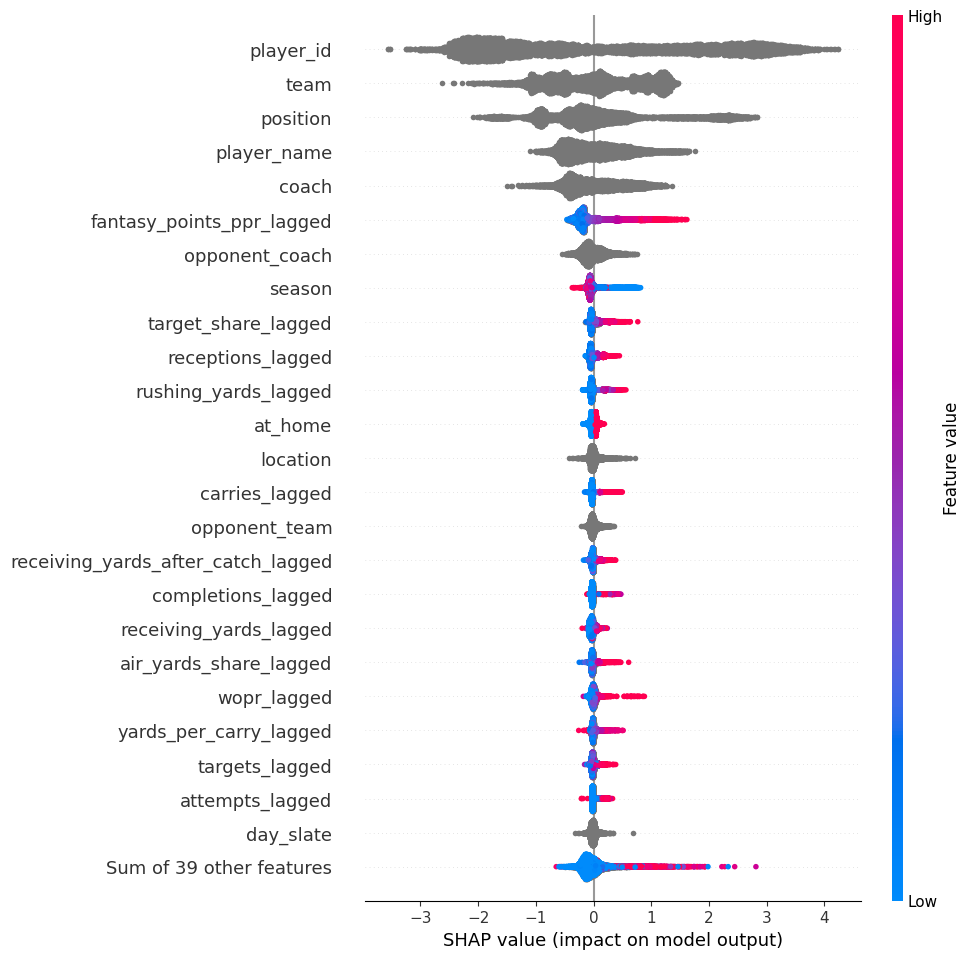

In [162]:
shap.plots.beeswarm(shap_values_all_plus, max_display = 25)